# Yelp Ratings Analysis Base on BSSM (Binomial State Space Model) 
### 299r Xu Si

In [314]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import datetime as DT
import matplotlib.dates as mdates
import math
%matplotlib inline

In [3]:
from IPython.display import HTML

HTML('''<script>
code_show=true; 
function code_toggle() {
 if (code_show){
 $('div.input').hide();
 } else {
 $('div.input').show();
 }
 code_show = !code_show
} 
$( document ).ready(code_toggle);
</script>
<form action="javascript:code_toggle()"><input STYLE="color: #4286f4" type="submit" value="Click here to toggle on/off the raw code."></form>''')

## Goal

We can see the development of a business through the reviews it has collected day by day. For every review, there is a rating, e.g. 4 out of 5 stars, which represents the **likeability** of the business.

We are interested in visualizing the **historical trend** of **likeability** of a business, given the stars!

## Quick Look

### 1.Business Info

In [3]:
#look at the first rows from business dataset
business = pd.read_csv("datasets/yelp_academic_dataset_business.csv", delimiter=",",low_memory=False)
business.head()

,attributes.Ambience.divey,attributes.Dietary Restrictions.vegan,attributes.Happy Hour,hours.Thursday.open,attributes.Order at Counter,attributes.Hair Types Specialized In.africanamerican,attributes.Hair Types Specialized In.kids,attributes.BYOB,hours.Friday.open,attributes.Good For.latenight,...,attributes.Noise Level,attributes.Smoking,attributes.Attire,attributes.Hair Types Specialized In.curly,attributes.Good For Groups,neighborhoods,attributes.Open 24 Hours,attributes.Ambience.romantic,attributes.Music.jukebox,attributes.Ambience.upscale
0,False,NaN,NaN,11:00,NaN,NaN,NaN,NaN,11:00,False,...,average,NaN,casual,NaN,True,[],NaN,False,NaN,False
1,NaN,NaN,True,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,True,[],NaN,NaN,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,[],NaN,NaN,NaN,NaN
3,True,NaN,False,10:00,NaN,NaN,NaN,NaN,10:00,False,...,average,no,casual,NaN,True,[],NaN,False,NaN,False
4,NaN,NaN,NaN,11:00,NaN,NaN,NaN,NaN,11:00,NaN,...,NaN,NaN,NaN,NaN,True,[],NaN,NaN,NaN,NaN


**Summary**

In [5]:
print 'Number of Business:', business.shape[0], '\n', 'Number of Cities: ', len(business.city.unique()),'\n', 'Number of States: ', len(business.state.unique())

Number of Business: 85901 
Number of Cities:  444 
Number of States:  30


In [14]:
print 'cities:\n',business['city'].value_counts()

cities:
Las Vegas                     19328
Phoenix                       11852
Charlotte                      5695
Scottsdale                     5638
Montréal                       4371
Mesa                           3638
Pittsburgh                     3628
Edinburgh                      3360
Henderson                      3145
Tempe                          3043
Chandler                       2702
Madison                        2278
Glendale                       2048
Gilbert                        1941
Peoria                         1081
North Las Vegas                 952
Karlsruhe                       906
Surprise                        681
Goodyear                        507
Champaign                       505
Avondale                        427
Matthews                        399
Queen Creek                     383
Waterloo                        297
Fort Mill                       287
Urbana                          286
Cave Creek                      266
Middleton           

In [73]:
lv = business[business['city'] == 'Las Vegas']
lv['categories'].value_counts()

['Mexican', 'Restaurants']                                                                                                                    353
['Pizza', 'Restaurants']                                                                                                                      247
['Beauty & Spas', 'Nail Salons']                                                                                                              244
['Hair Salons', 'Beauty & Spas']                                                                                                              226
['Home Services', 'Real Estate', 'Apartments']                                                                                                208
['Food', 'Coffee & Tea']                                                                                                                      202
['Arts & Entertainment', 'Performing Arts']                                                                                 

In [9]:
print 'Categories: \n',business['categories'].value_counts()

Categories: 
['Mexican', 'Restaurants']                                                                                                             1680
['Pizza', 'Restaurants']                                                                                                               1298
['Food', 'Coffee & Tea']                                                                                                               1206
['Beauty & Spas', 'Nail Salons']                                                                                                       1183
['Hair Salons', 'Beauty & Spas']                                                                                                       1127
['Hotels & Travel', 'Event Planning & Services', 'Hotels']                                                                             1114
['Chinese', 'Restaurants']                                                                                                              943
['Home 

### 2.Reviews Info

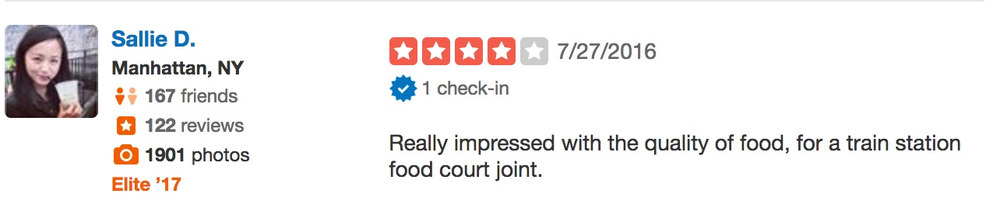

From:  https://www.yelp.com/biz/oath-craft-pizza-boston


In [4]:
from IPython.display import Image, display
display(Image(filename='pics/Rating Demo.jpeg'))
print 'From: ', 'https://www.yelp.com/biz/oath-craft-pizza-boston'

In [5]:
review = pd.read_csv("datasets/yelp_academic_dataset_review.csv",delimiter=",")
review.head(3)

,user_id,review_id,text,votes.cool,business_id,votes.funny,stars,date,type,votes.useful
0,PUFPaY9KxDAcGqfsorJp3Q,Ya85v4eqdd6k9Od8HbQjyA,"Mr Hoagie is an institution. Walking in, it do...",0,5UmKMjUEUNdYWqANhGckJw,0,4,2012-08-01,review,0
1,Iu6AxdBYGR4A0wspR9BYHA,KPvLNJ21_4wbYNctrOwWdQ,Excellent food. Superb customer service. I mis...,0,5UmKMjUEUNdYWqANhGckJw,0,5,2014-02-13,review,0
2,auESFwWvW42h6alXgFxAXQ,fFSoGV46Yxuwbr3fHNuZig,Yes this place is a little out dated and not o...,0,5UmKMjUEUNdYWqANhGckJw,1,5,2015-10-31,review,1


In [10]:
len(review['user_id'].unique())

686556

In [7]:
review.shape

(2685066, 10)

**Summary**

In [6]:
print "number of reviews: ", review.shape[0]
print "number of business: ", review["business_id"].unique().shape[0]
print "average reviews per business: ", review.shape[0] / review["business_id"].unique().shape[0]
print 'Rating Scale: ',review.stars.unique()

number of reviews:  2685066
number of business:  85539
average reviews per business:  31
Rating Scale:  [4 5 3 2 1]


In [15]:
#order all business by number of ratings
num_review = review["business_id"].value_counts()
num_review_tuple = zip(num_review.index,num_review)

In [13]:
#restuarants in las vegas
business_lv_res = business[business.categories.map(lambda x: 'Restaurant' in x)]
business_lv_res = business_lv_res[business_lv_res.city == 'Las Vegas']
print "Number of resturants in Las Vegas: " , business_lv_res.shape
num_review_lv_res = review["business_id"].value_counts()
num_review_tuple_lv_res = zip(num_review_lv_res.index,num_review_lv_res)

Number of resturants in Las Vegas:  (4928, 98)


## Analysis & Visualization

### BSSM Model

$$
\left\{
        \begin{array}{ll}
          \theta_t = \theta_{t-1} + \epsilon_t\\
          p(\theta_t) = \frac{e^{\theta_t}}{1 + e^{\theta_t}}\\
          p(\textbf{y}_t\mid \theta_t,H_t) = \prod\limits_{i = 1}^{M} \binom{5}{y_{ti}} p(\theta_t)^{y_{ti}}(1 - p(\theta_t))^{5 - y_{ti}}
        \end{array}
\right.
$$

In [386]:
#input: 
#sigma (Float): unknow parameter
#N (Int): Rating Scale e.g. 5 stars
#M (List): Number of observations at a certain point
#R (List): Total ratings at a certain point
#output:
#theta_f (List): Mean of every latent variable
#sigma_f (List): Variance of every latent variable

def filtering(sigma,N,M,R):
    
    T = len(M)# Number of history 
    theta_i = 0. #initiate theta_0
    sigma_i = 0. #initiate signma_0
    p_i = 0.5
    theta_f = [theta_i]
    sigma_f = [sigma_i]
    p_f = [p_i]
    
    #iterate to calculate theta_f and sigma_f
    for i in range(T):
       
#         if (2 * theta_i <= 500):
            
#             sigma_i = 1./(M[i]*N*np.exp(theta_i)/(1.+np.exp(theta_i))**2 + 1./(sigma_i + sigma)) #update sigma_i
#             theta_i = theta_i + sigma_i * (R[i] - M[i] * N * p_i)
#             p_i = np.exp(theta_i)/(1+np.exp(theta_i)) 

#             theta_f.append(theta_i)
#             sigma_f.append(sigma_i)
#             p_f.append(p_i)
            
#         else:
            
#             sigma_i = sigma_i + sigma #update sigma_i
#             theta_i = theta_i + sigma_i * (R[i] - M[i] * N * p_i)
#             p_i = 0 

#             theta_f.append(theta_i)
#             sigma_f.append(sigma_i)
#             p_f.append(p_i)


        sigma_i = 1./(M[i]*N*np.exp(theta_i)/(1.+np.exp(theta_i))**2 + 1./(sigma_i + sigma)) #update sigma_i
        theta_i = theta_i + sigma_i * (R[i] - M[i] * N * p_i)
        p_i = np.exp(theta_i)/(1+np.exp(theta_i)) 

        theta_f.append(theta_i)
        sigma_f.append(sigma_i)
        p_f.append(p_i)
   
    return theta_f,sigma_f,p_f

In [387]:
def smoothing(sigma, N, M, R):
    
    theta_f,sigma_f,_ = filtering(sigma,N,M,R)
    
    T = len(M)# Number of history
    theta_i = theta_f[-1] #initiate theta_0
    sigma_i = sigma_f[-1] #initiate signma_0
    theta_s = [theta_i]
    sigma_s = [sigma_i]
    
    for i in range(T):
        A = sigma_f[T-i-1]/(sigma_f[T-i-1] + sigma)
        theta_i = theta_f[T-i-1] + A * (theta_i - theta_f[T-i-1])
        sigma_i = sigma_f[T-i-1] + A * (sigma_i - sigma_f[T-i-1])
        
        theta_s.append(theta_i)
        sigma_s.append(sigma_i)
        
        
    return theta_s[::-1], sigma_s[::-1], theta_f, sigma_f 

In [402]:
def EM(sigma0, N, M, R):
    
    T = len(M)# Number of history
    sigma_old = 100000
    sigma_new = sigma0
    n = 0
    p_lows = [] #skip the initial value 0 for plotting
    p_highs = []

    while (abs(sigma_old - sigma_new) > 0.000001):     
        n += 1 
        sigma_old = sigma_new
        
        theta_s, sigma_s, theta_f, sigma_f  = smoothing(sigma_old, N, M, R)
        W_k = np.square(theta_s) + sigma_s 
        W_kk_1 = [(sigma_f[i]/(sigma_f[i+1] + sigma_old) * sigma_s[i+1] + theta_s[i+1] * theta_s[i]) for i in range(T)]
#         sigma_new = (2. * np.sum(W_k) - W_k[0] - W_k[-1])/ T - 2. * np.mean(W_kk_1[:-1])
        sigma_new = (np.sum(W_k[2:]) + np.sum(W_k[1:-1]) - 2 * np.sum(W_kk_1[1:]))/T
        print len(W_k[2:]), len(W_k[1:-1]),len(W_kk_1[1:])
       
    
    #get best estimate of mean and variance of the latent variables
#     if not math.isnan(sigma_new):
#         theta_EM,sigma_EM,p_EM = filtering(sigma_new,N,M,R)
#     else: 
#         theta_EM,sigma_EM,p_EM = filtering(sigma_old,N,M,R)
        
    theta_EM,sigma_EM,p_EM = filtering(sigma_new,N,M,R)
    print "EM Sigma2: ",sigma_old

    for theta, sigma in zip(theta_EM,sigma_EM)[1:]: #skip the initial values (0,0)
        
        samples = np.random.normal(theta, sigma, 10000)
        ps = map(lambda x: np.exp(x)/(1. + np.exp(x)),samples)
        p_low, p_high = np.percentile(ps,[2.5,97.5])
        p_lows.append(p_low)
        p_highs.append(p_high)
    
    return p_EM[1:], p_lows, p_highs, sigma_new

In [403]:
kw = lambda x: x.isocalendar()[1]
class Restuarant:
    #initiate datasets
    def __init__(self, ID, busi_data, review_data):
         
        self.business = busi_data
        self.review = review_data
        self.ID = ID
        self.name = self.business[self.business["business_id"] == self.ID]["name"].values[0]
        self.target =  self.review[self.review["business_id"] == ID][["stars","date"]]
        self.target["date"] =  pd.to_datetime(self.target['date'], format = '%Y-%m-%d')
        self.target.index = self.target["date"].values
        self.target["year"] = self.target.index.year
        self.target["month"] = self.target.index.month
        self.target["week"] = self.target.index.week
        self.target["day"] = self.target.index.day        
        
    #find whole name of a restuarant by matching partial str
    def find_res_by_name(self, name):
        matched_res_index = self.business['name'].str.contains(name)
        self.find_by_match = self.business[matched_res_index][['name','business_id']]
        return self.find_by_match

    def reviews_week (self):

        self.target_review_week = self.target[["day","stars","year","week","date"]].groupby([self.target.index.year,self.target.index.week]).agg({"day": lambda x: x.shape[0],
                                 "stars": lambda x: x.sum(), 
                                 "year": lambda x: x.values[0],
                                 "week": lambda x: x.values[0]
                               }).apply(pd.to_numeric)
        
        self.target_review_week.rename(columns = {'day':'counts'}, inplace = True)  


    def plot_reviews (self, plot = True):
        print self.name
        
#         years =  self.target_review_year_month["year"].unique()
       
        #EM 
        total_stars = self.target_review_week['stars'].values
        number_rating = self.target_review_week['counts'].values
        rating_scale = 5
        
        p,p_low,p_up,self.sig = EM(0.5,rating_scale,number_rating,total_stars)
        
        #simple p just dividing 
        simple_p = total_stars / (number_rating * 5.)
        
        #convert probability to stars
        star_low = [5 * i for i in p_low]
        star_up = [5 * i for i in p_up]
        star = [5 * i for i in p]
        
        if plot:
            #plot ratings by week
            fig,ax = plt.subplots(1,2,figsize = (20,5))

            ax[0].plot(range(len(p)), self.target_review_week['counts'])
            ax[0].set_title('Number of Ratings by Week',fontsize=20)
            ax[0].set_ylabel('Number of ratings',fontsize=15)
            ax[0].set_xlabel('Week',fontsize=15)
            #ax[1][0].xaxis.set_major_formatter(self.xformat_y_m)

            line_1, = ax[1].plot(range(len(p)),star,c = 'b',label = 'BSSM_p') #estimated hidden state
            #line_2, = ax[1].plot(range(len(p)),simple_p,c = 'r',label = 'Simple_p',alpha = 0.6) #from the data
            ax[1].fill_between(range(len(p)),star_low, star_up,color='blue',alpha=0.2)
            blue_patch = mpatches.Patch(color='blue', alpha = 0.4,label='Uncertainty')
            #ax[1].legend(loc = 4,handles=[line_2,line_1, blue_patch])
            ax[1].legend(loc = 4,handles=[line_1, blue_patch])
            ax[1].set_ylim(0,5)
            ax[1].set_ylabel('Estimated Stars',fontsize=15)
            ax[1].set_xlabel('Week',fontsize=20)
            #ax[1][1].xaxis.set_major_formatter(self.xformat_y_m)
            ax[1].set_title('Estimated Stars by Week',fontsize=20)

            plt.show()

Bobby Q
356 356 356
356 356 356
356 356 356
356 356 356
356 356 356
356 356 356
356 356 356
356 356 356
356 356 356
356 356 356
356 356 356
356 356 356
356 356 356
356 356 356
EM Sigma2:  2.53350192257


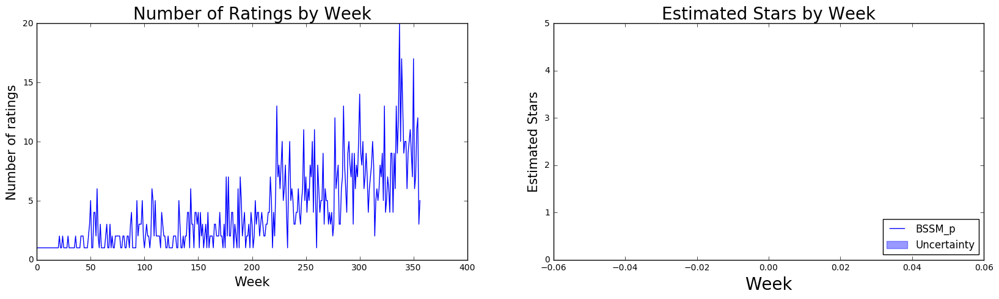

In [404]:
for i in range(1):
    ID = num_review_tuple_lv_res[62][0]
    res = Restuarant(ID,business,review)
    res.reviews_week()
    res.plot_reviews(plot = True)

In [327]:
import cPickle as pickle

In [336]:
res.target_review_week.values

array([[  17,    1,    4, 2007],
       [  21,    1,    5, 2007],
       [  33,    1,    5, 2007],
       ..., 
       [  28,   12,   52, 2016],
       [  29,    3,   12, 2016],
       [  53,    5,   24, 2016]])

In [337]:
pickle.dump(res.target_review_week.values,open('/Users/sophiasi/Desktop/review.p','wb'))

**Calculate Sigma**

Mon Ami Gabi
EM Sigma2:  0.170519464529


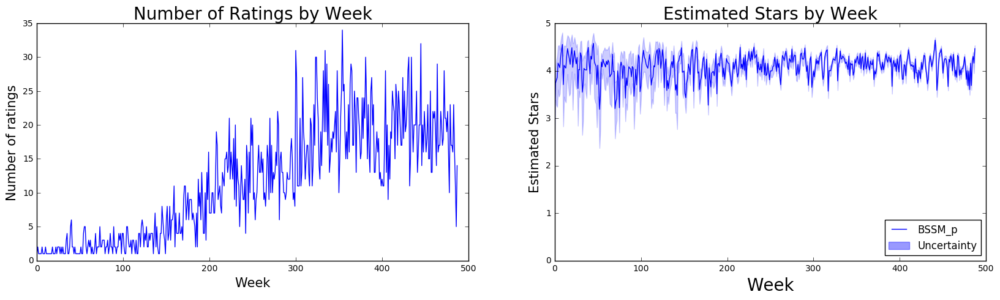

Bacchanal Buffet
EM Sigma2:  0.193205829176


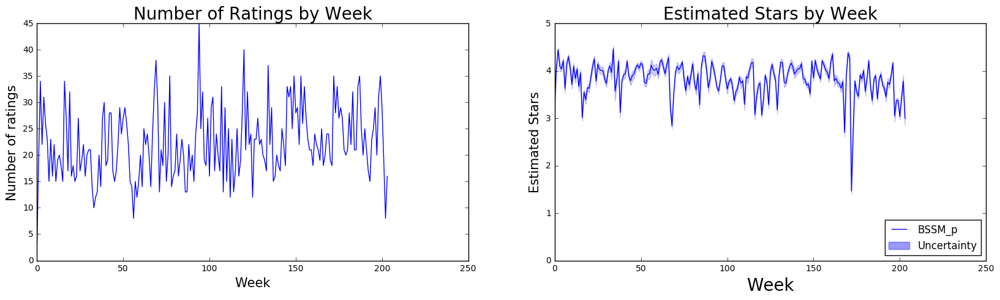

Wicked Spoon
EM Sigma2:  0.109578054023


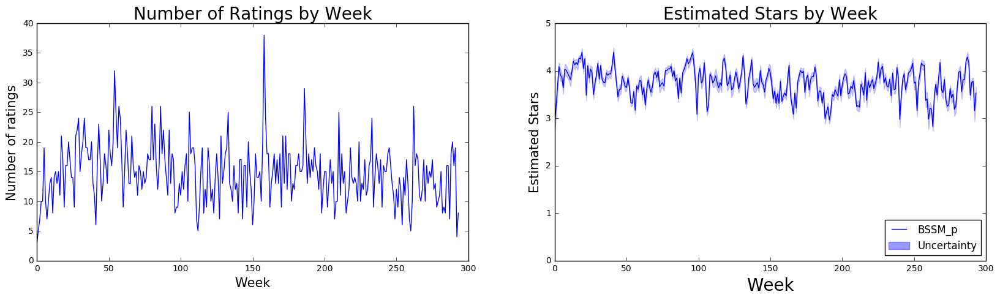

Gordon Ramsay BurGR
EM Sigma2:  0.0711506571227


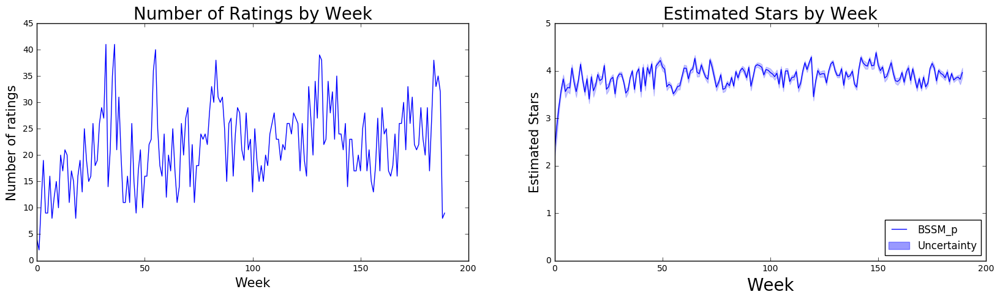

Earl of Sandwich
EM Sigma2:  0.213510257421


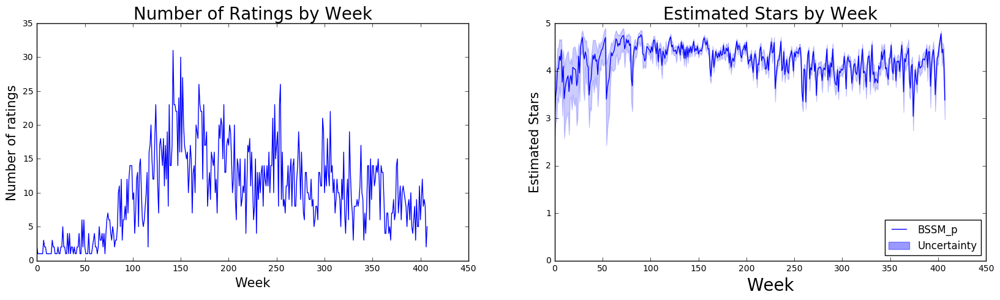

Gangnam Asian BBQ Dining
EM Sigma2:  0.273533826316


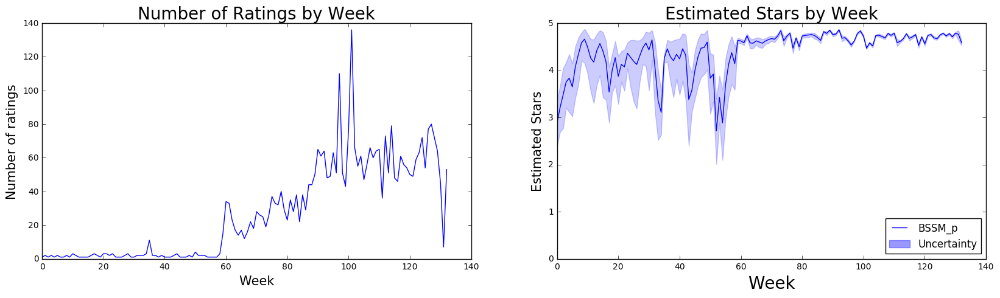

Serendipity 3
EM Sigma2:  0.107732693584


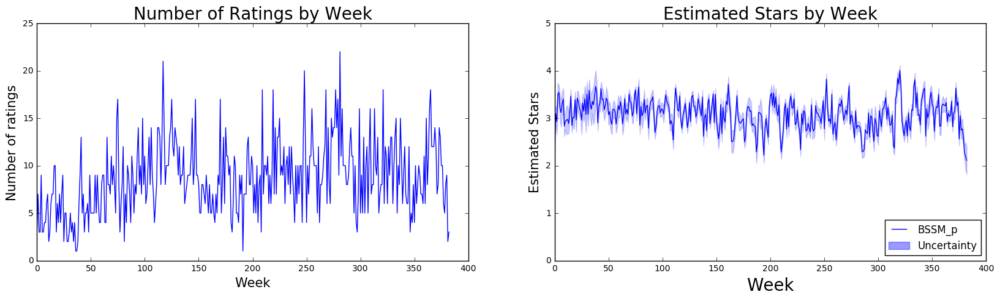

Hash House A Go Go
EM Sigma2:  0.160788849939


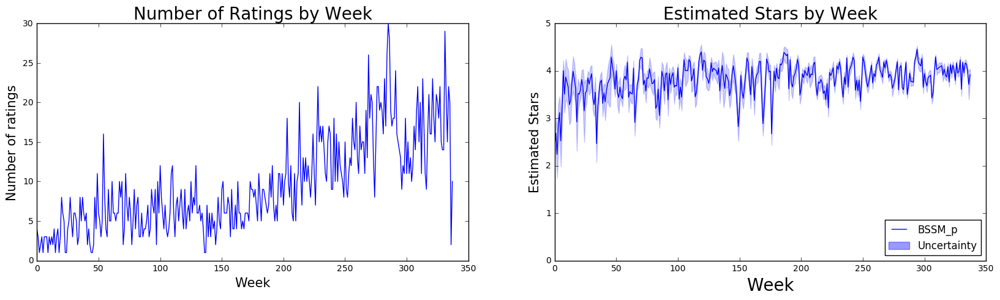

The Buffet
EM Sigma2:  0.228937720978


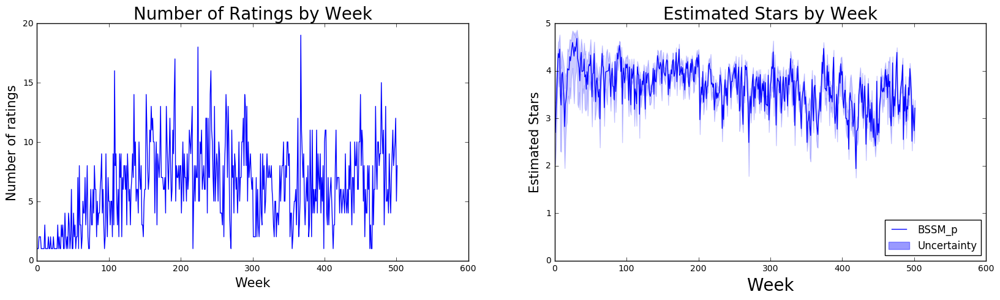

Lotus of Siam
EM Sigma2:  0.449446848994


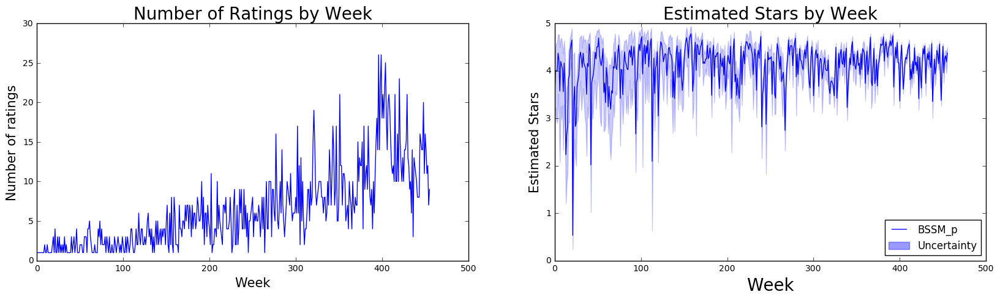

The Cosmopolitan of Las Vegas
EM Sigma2:  0.266000083345


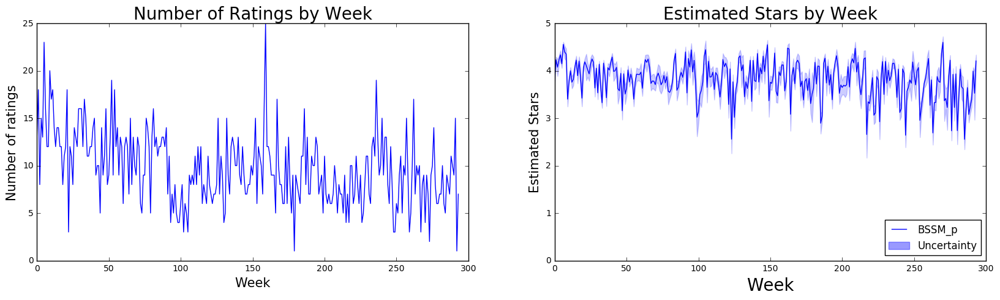

The Buffet at Bellagio
EM Sigma2:  0.242293021808


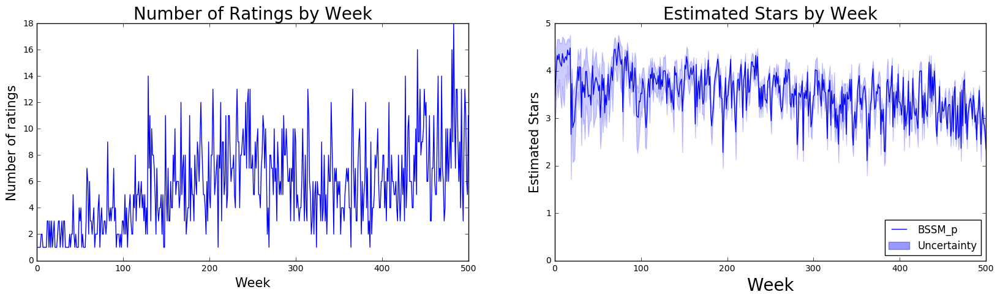

ARIA Hotel & Casino
EM Sigma2:  0.183697019796


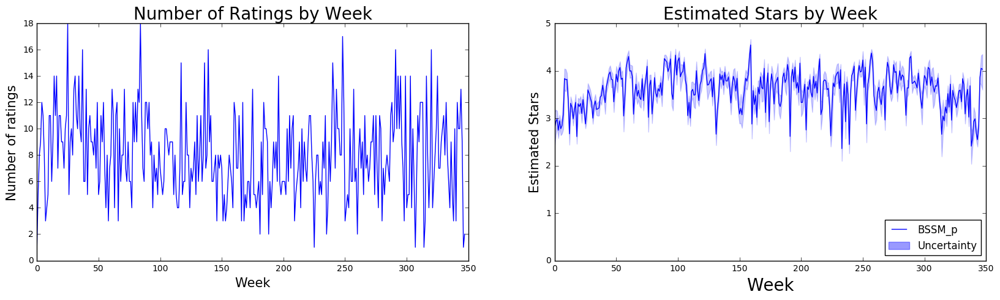

Bouchon at The Venetian
EM Sigma2:  0.374891632943


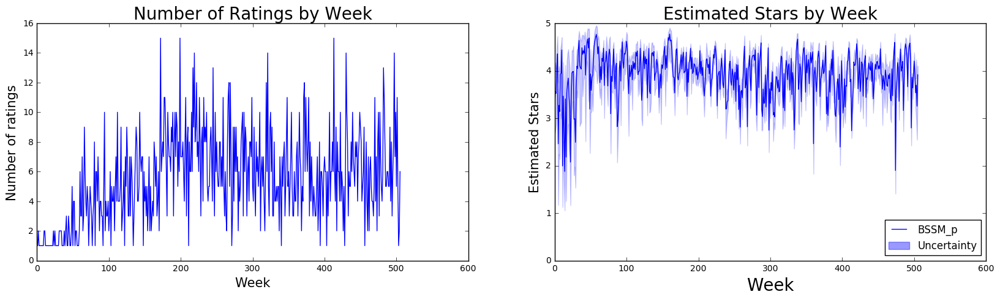

Secret Pizza
EM Sigma2:  0.207935566479


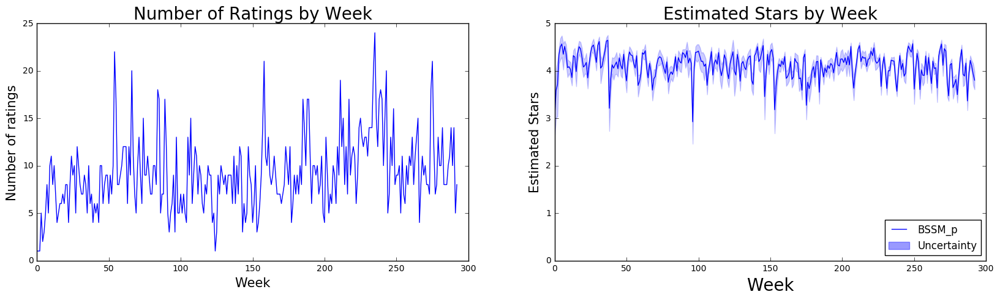

Hash House A Go Go
EM Sigma2:  0.337767948745


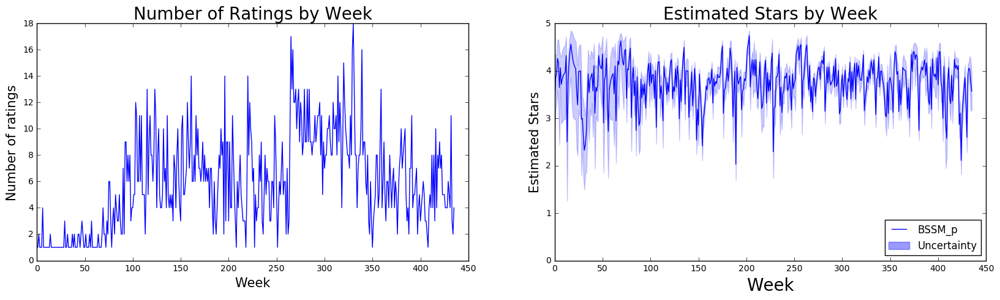

Luxor Hotel And Casino Las Vegas
EM Sigma2:  0.161075537009


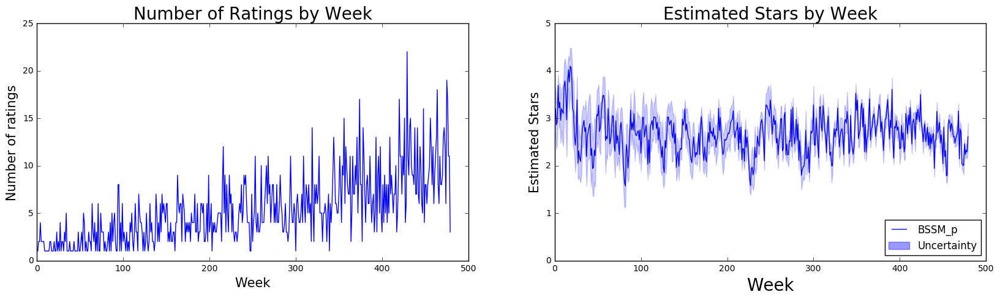

XS Nightclub
EM Sigma2:  0.370754094182


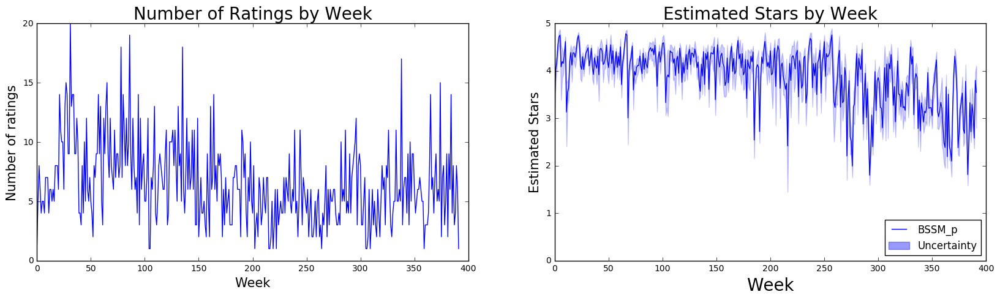

MGM Grand Hotel
EM Sigma2:  0.22644008758


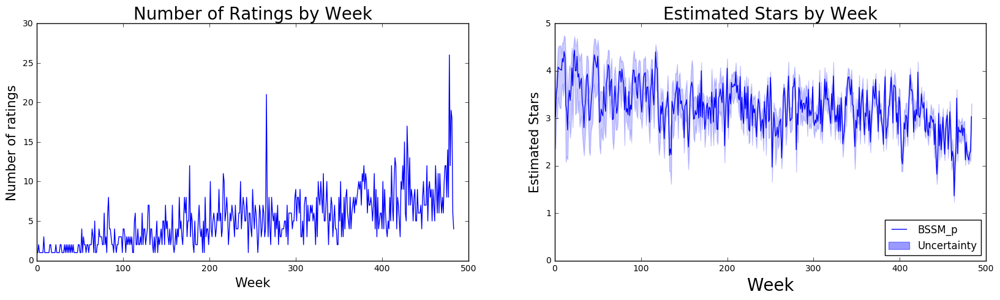

Bachi Burger
EM Sigma2:  0.245600955675


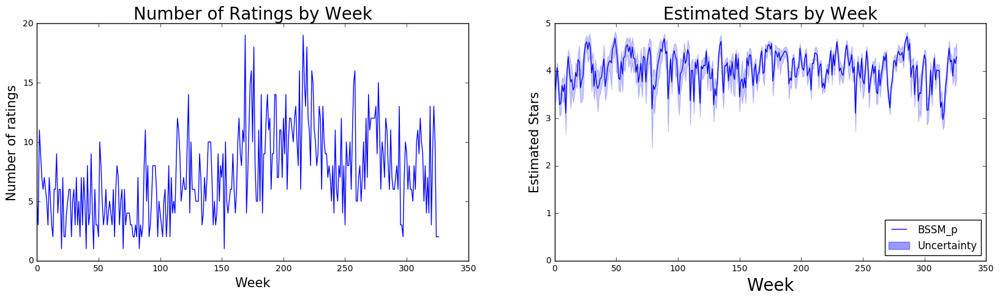

Mesa Grill
EM Sigma2:  0.350326662817


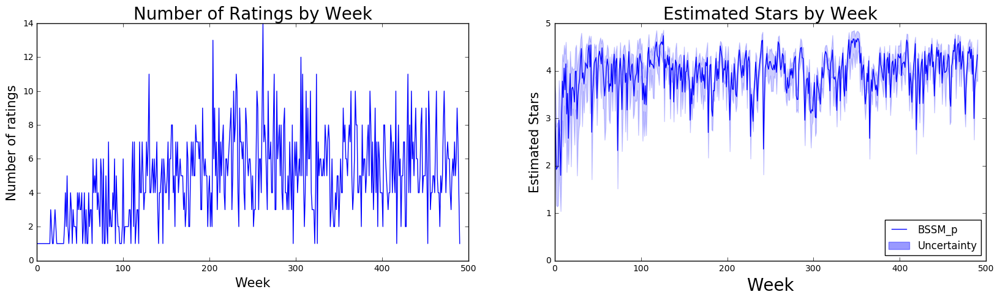

McCarran International Airport
EM Sigma2:  0.178123510781


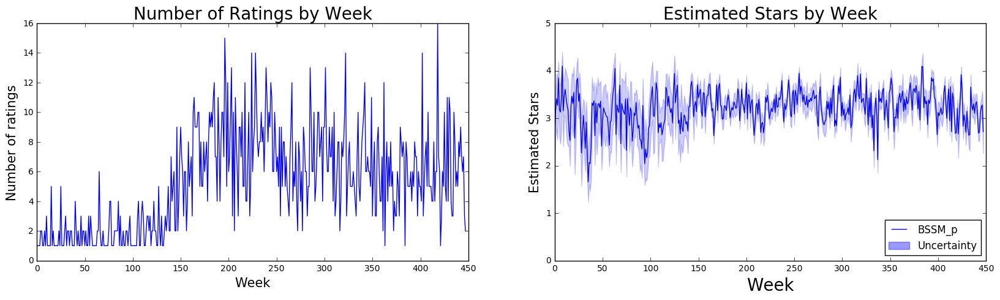

The Venetian Las Vegas
EM Sigma2:  0.670577401517


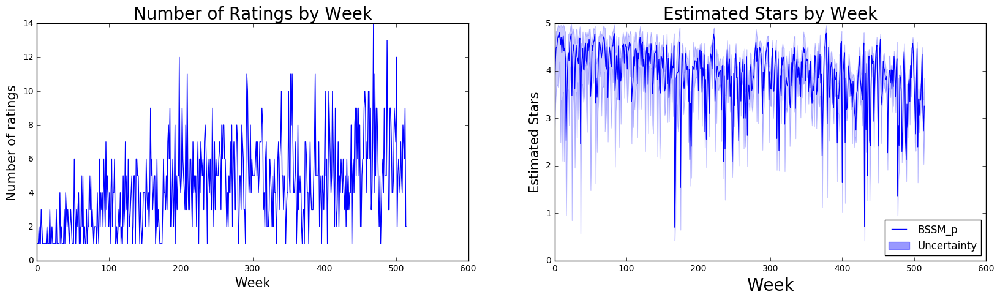

Gordon Ramsay Steak
EM Sigma2:  0.316505980402


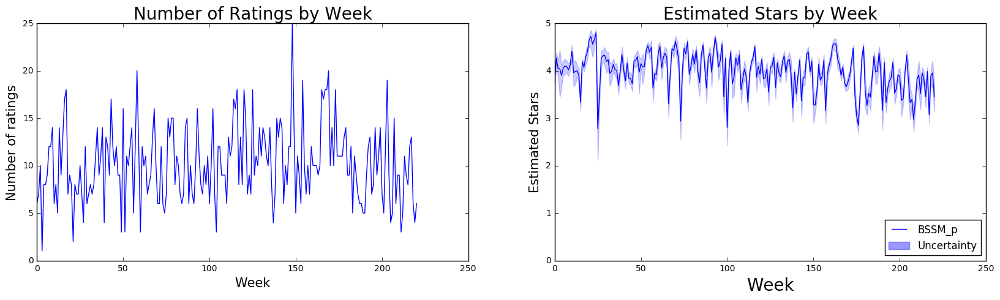

Flamingo Las Vegas Hotel & Casino
EM Sigma2:  0.232997095131


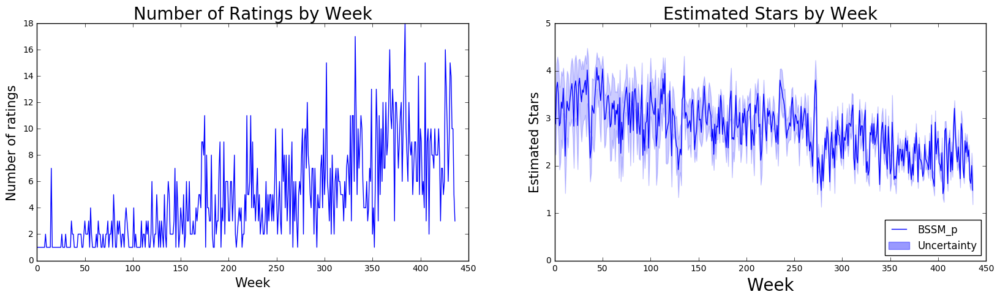

Holsteins Shakes and Buns
EM Sigma2:  0.188949184085


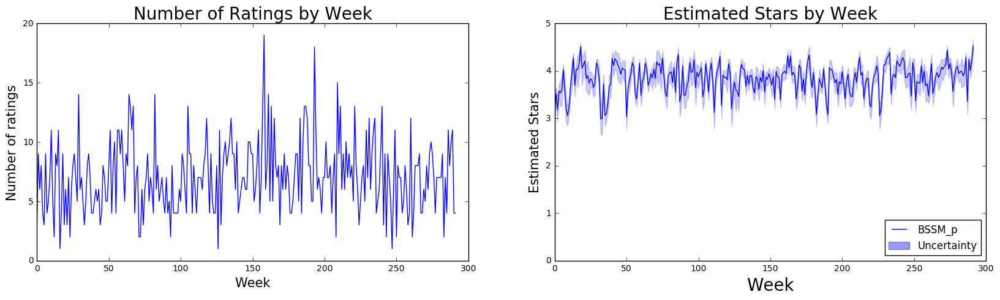

Planet Hollywood Las Vegas Resort & Casino
EM Sigma2:  0.261125988634


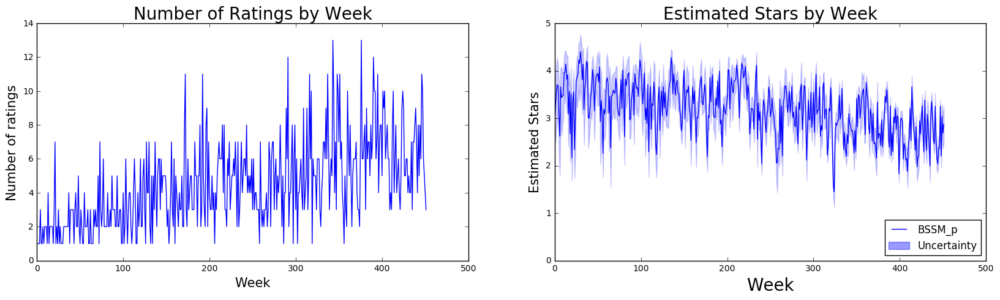

Burger Bar
EM Sigma2:  0.331295779128


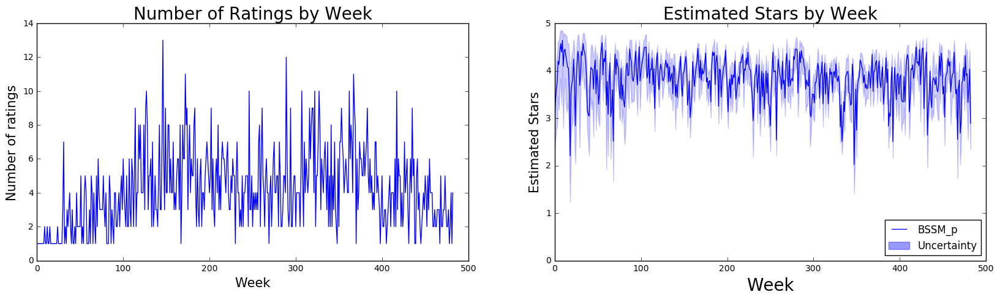

Bellagio Hotel
EM Sigma2:  0.520281988806


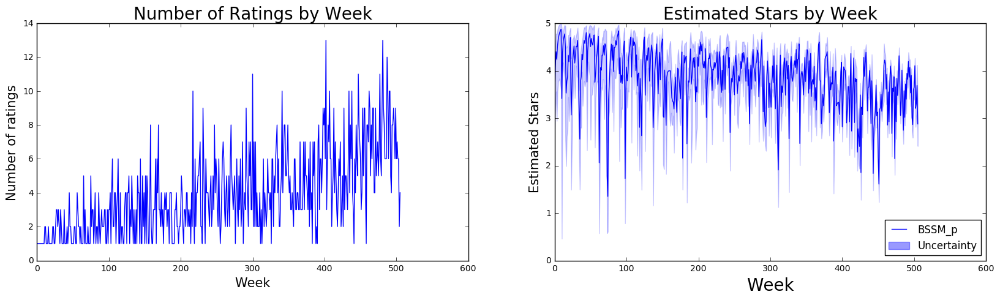

Pho Kim Long
EM Sigma2:  0.301787650772


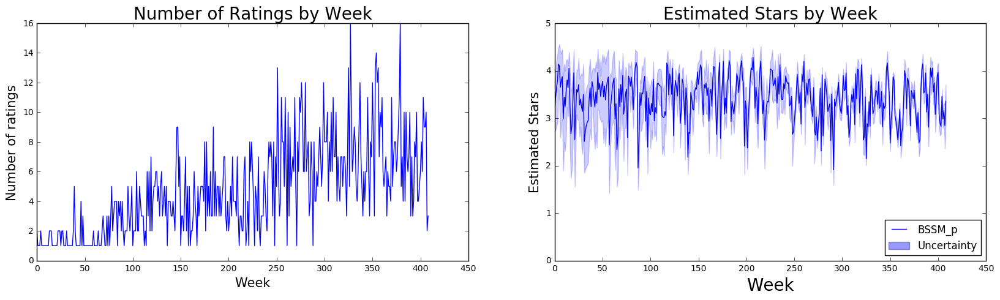

Egg & I
EM Sigma2:  0.547747005404


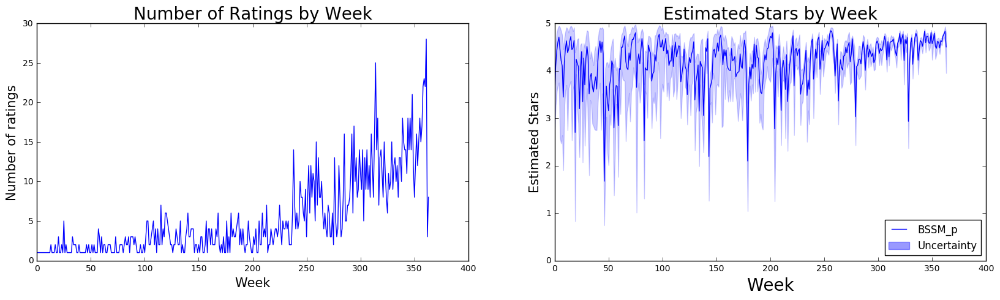

Grand Lux Cafe
EM Sigma2:  0.296924548049


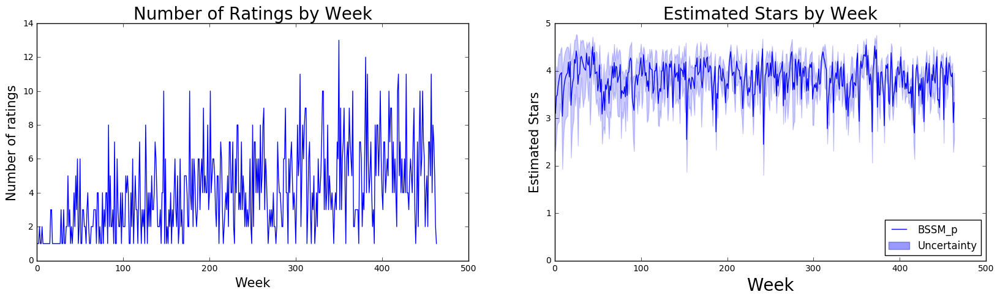

El Dorado Cantina
EM Sigma2:  0.397347317906


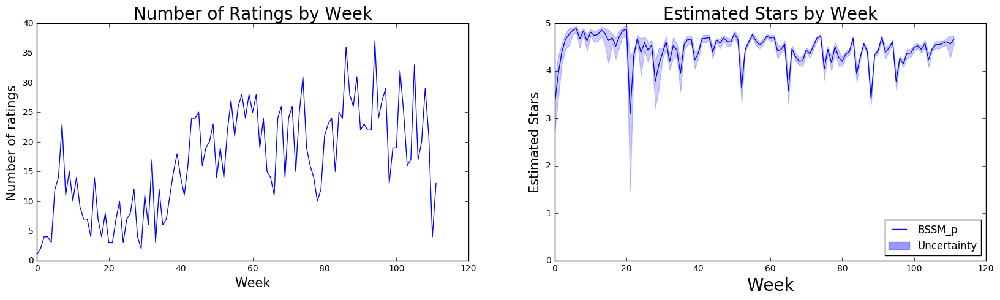

The Peppermill Restaurant & Fireside Lounge
EM Sigma2:  0.387206485246


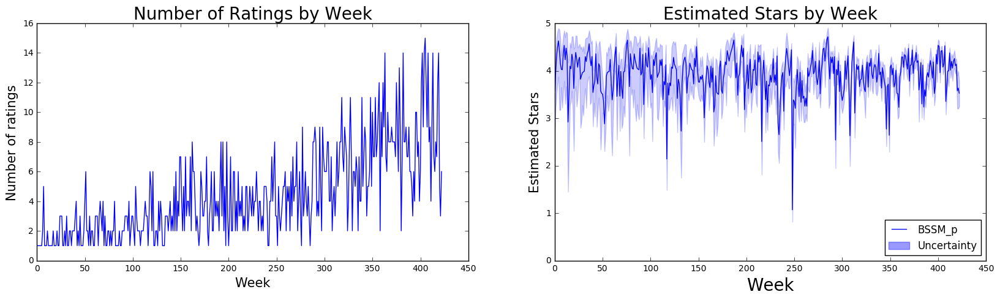

Mandalay Bay Resort & Casino
EM Sigma2:  0.379730111107


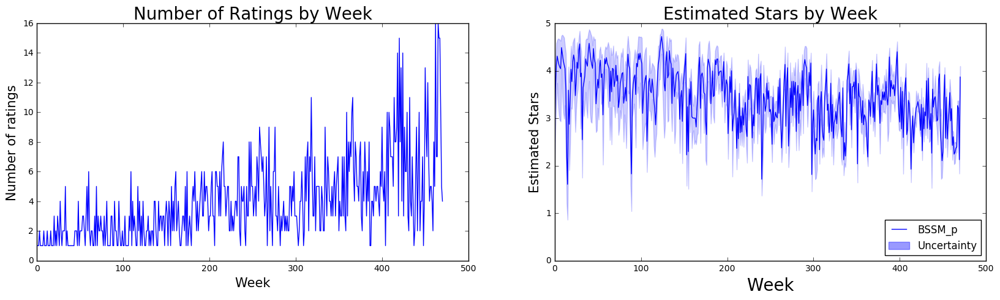

Excalibur Hotel
EM Sigma2:  0.242454355998


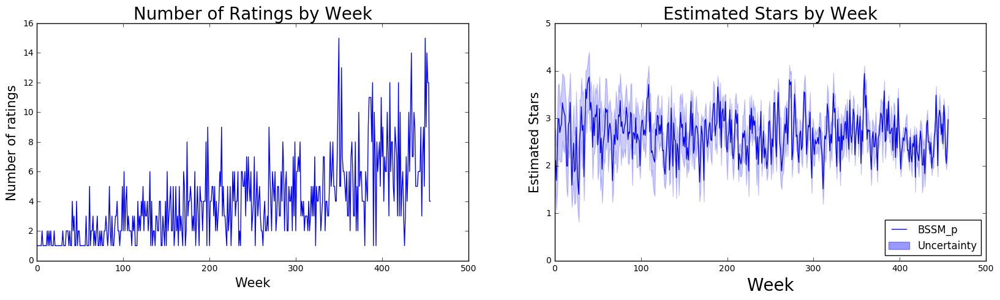

Tao Nightclub
EM Sigma2:  0.298041995993


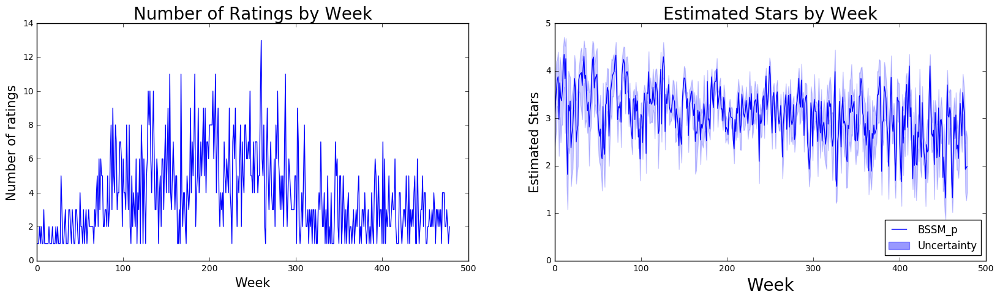

Marquee
EM Sigma2:  0.23840441535


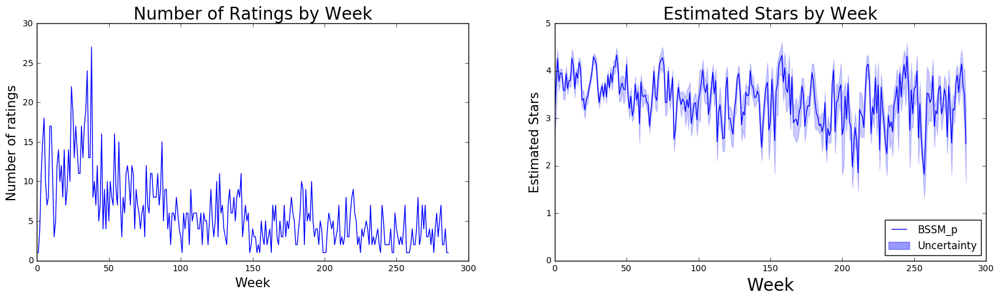

Wynn Las Vegas
EM Sigma2:  3.78417339936


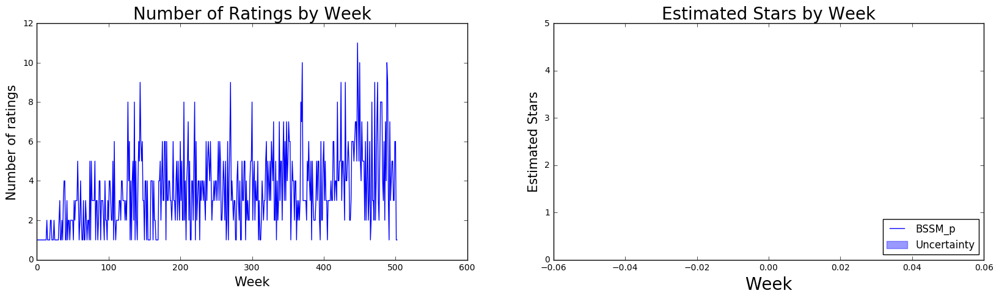

Caesars Palace Las Vegas Hotel & Casino
EM Sigma2:  0.396881326475


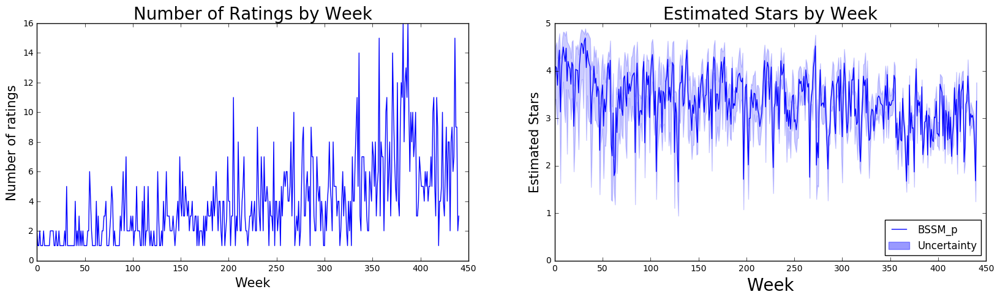

Rollin Smoke Barbeque
EM Sigma2:  0.42810307844


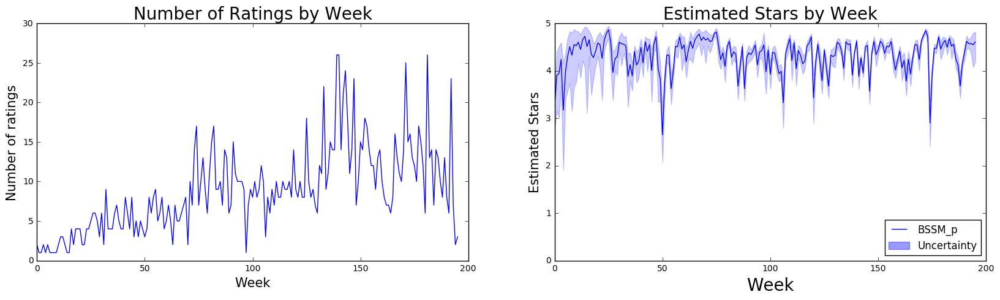

The Palazzo Las Vegas
EM Sigma2:  24.2626335009


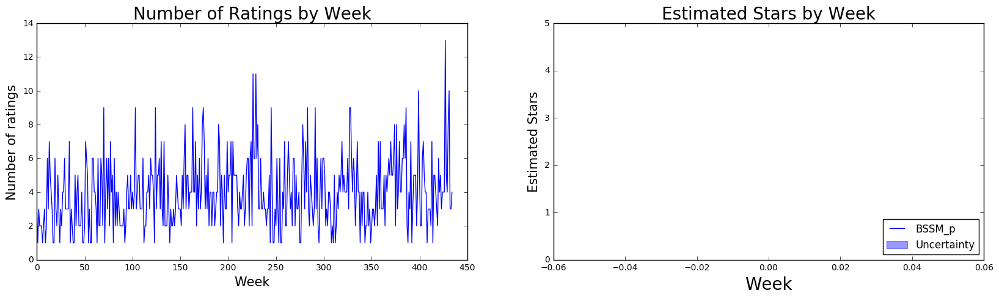

Phoenix Sky Harbor International Airport - PHX
EM Sigma2:  0.242954406444


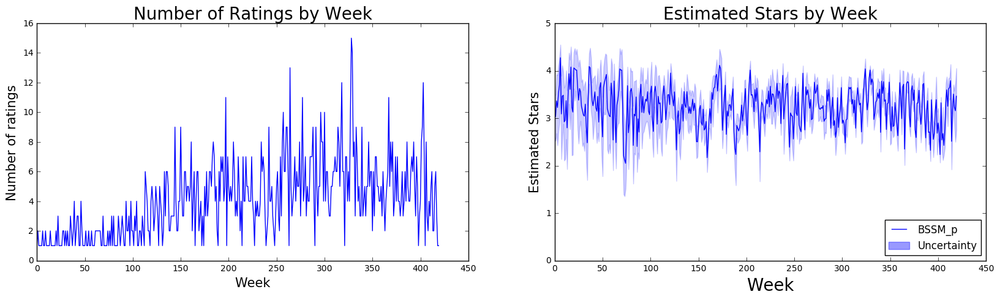

Gordon Ramsay Pub & Grill
EM Sigma2:  0.210450301725


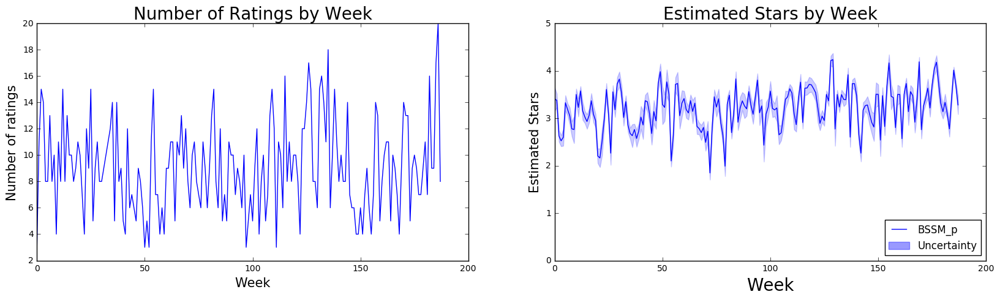

Vdara Hotel
EM Sigma2:  0.386450097184


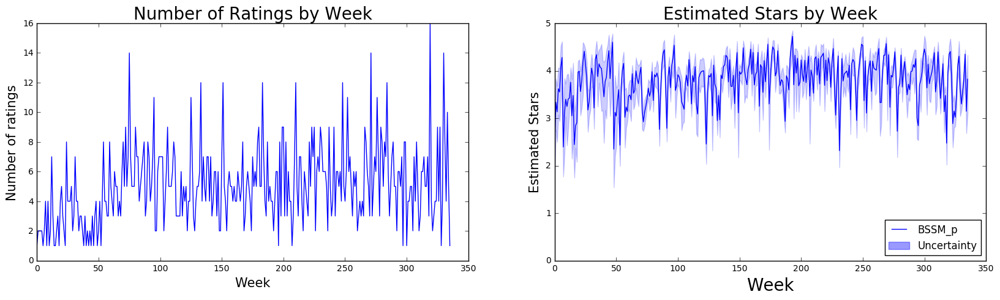

Monte Carlo Hotel And Casino
EM Sigma2:  0.232117965273


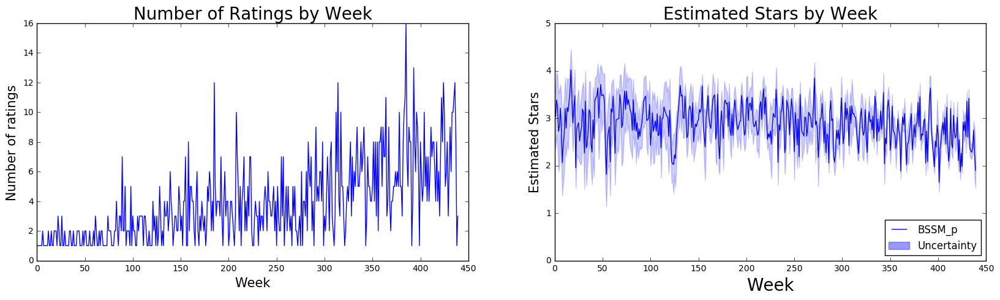

Monta Ramen
EM Sigma2:  0.344075293797


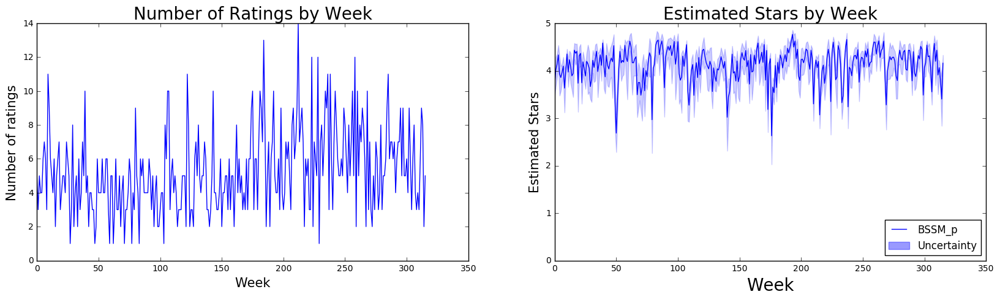

Guy Fieri's Vegas Kitchen & Bar
EM Sigma2:  0.18504514618


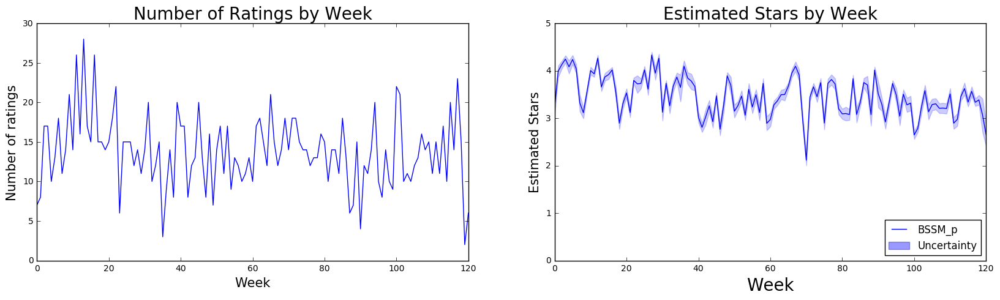

Tom Colicchio's Craftsteak
EM Sigma2:  0.786448484708


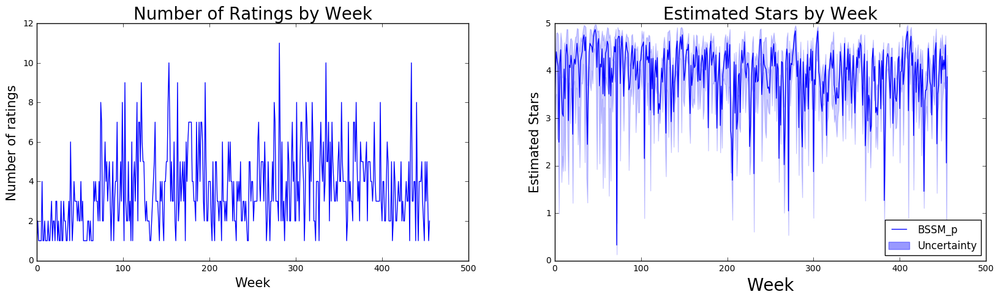

Treasure Island
EM Sigma2:  0.311403962439


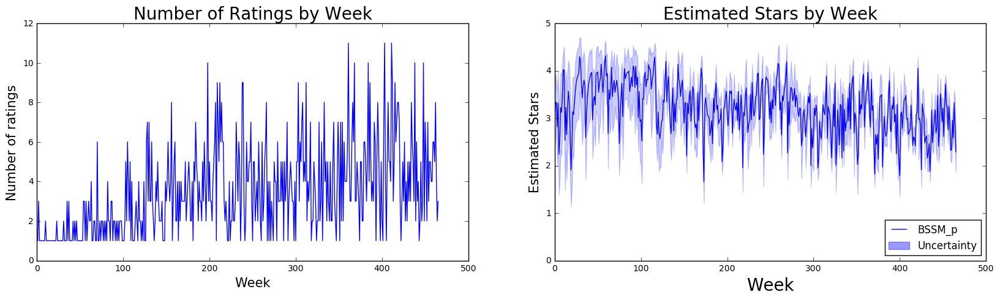

Giada
EM Sigma2:  0.167881585592


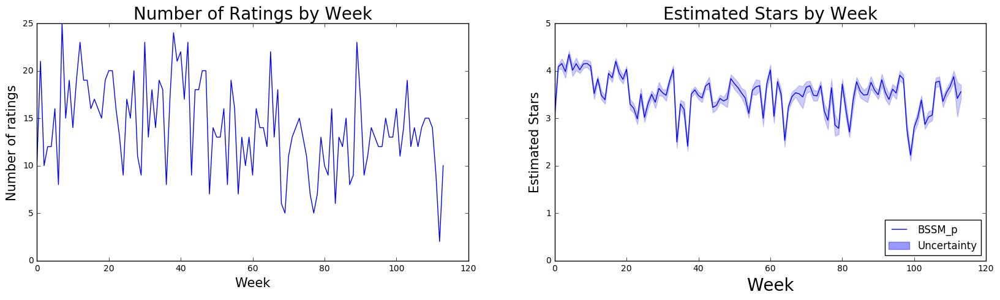

Four Peaks Brewing Co
EM Sigma2:  0.527710207874


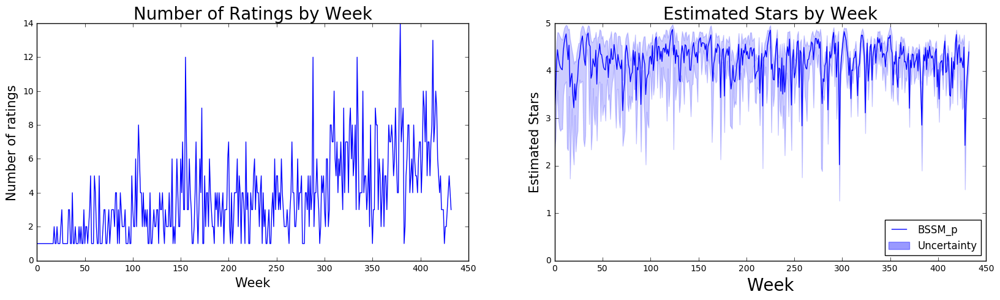

Shake Shack
EM Sigma2:  0.136682627084


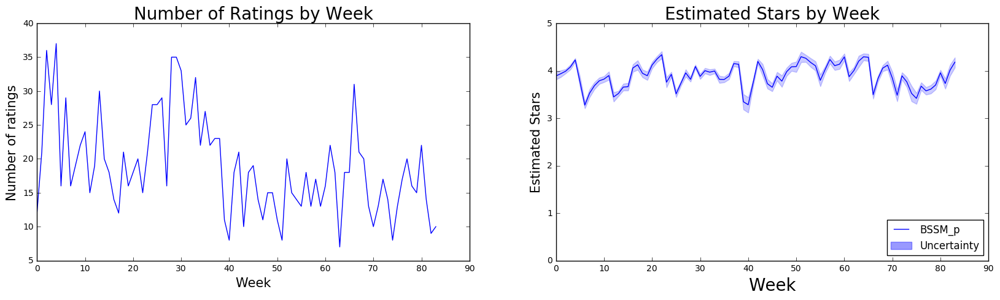

Pizzeria Bianco
EM Sigma2:  1.91841245347


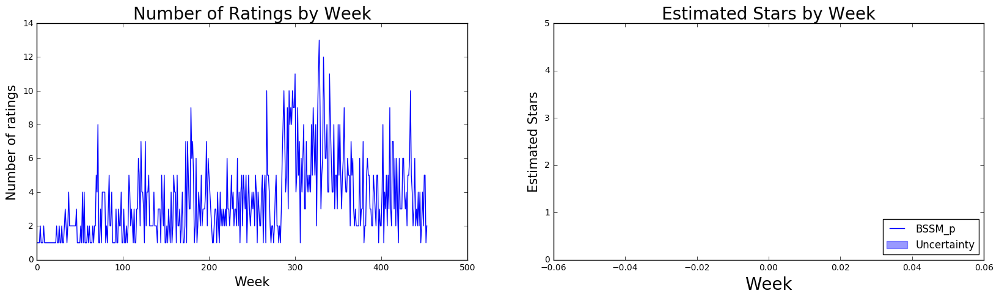

SUSHISAMBA - Las Vegas
EM Sigma2:  0.484625167021


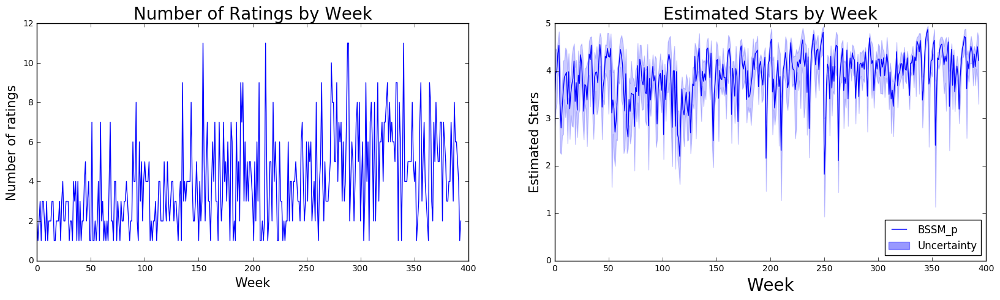

Ellis Island Casino & Brewery
EM Sigma2:  0.492069464307


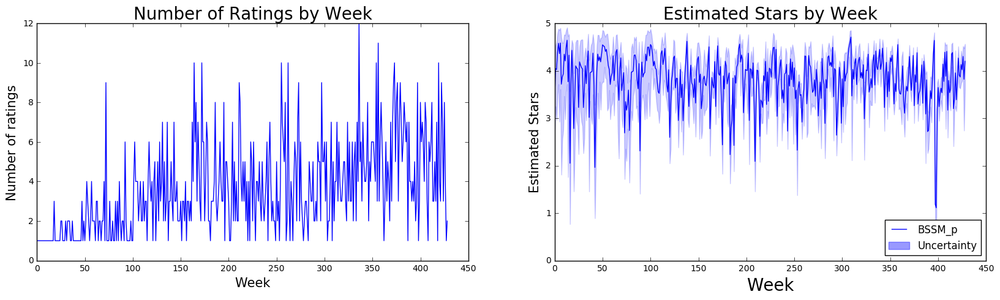

Le Village Buffet
EM Sigma2:  0.315972662649


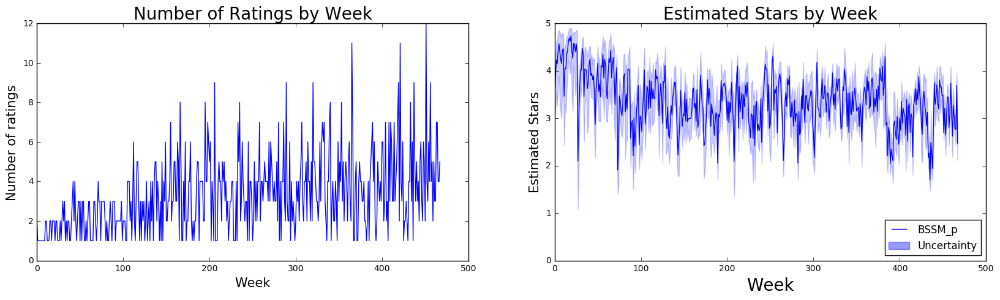

Studio B Show Kitchen Buffet
EM Sigma2:  0.430937848794


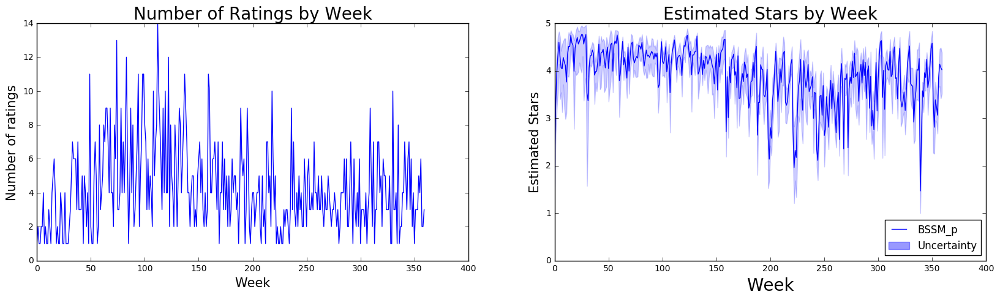

Hard Rock Hotel & Casino
EM Sigma2:  0.446607935316


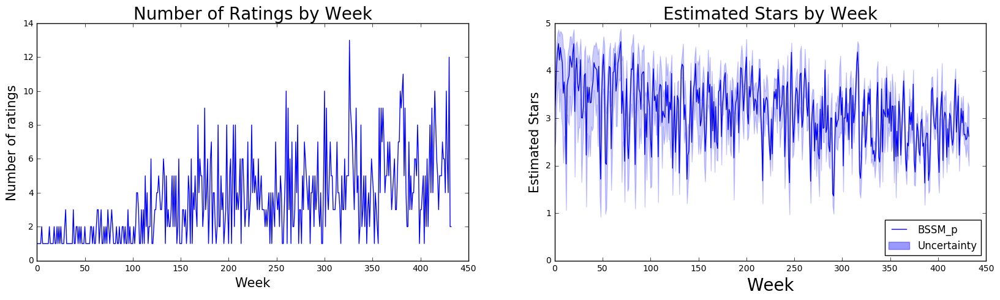

Paris Las Vegas Hotel & Casino
EM Sigma2:  0.310797617536


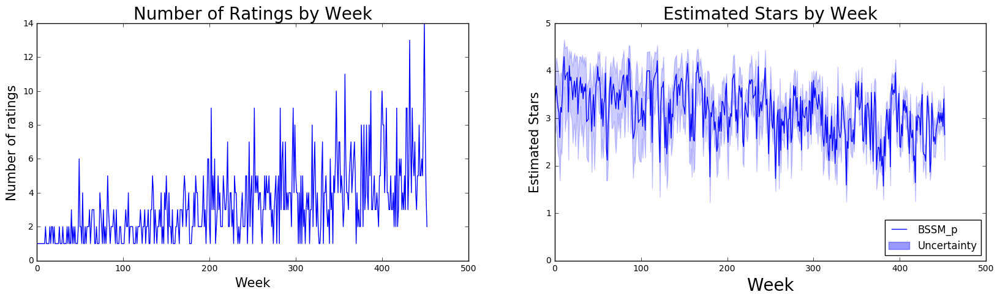

Oyster Bar
EM Sigma2:  0.828987703971


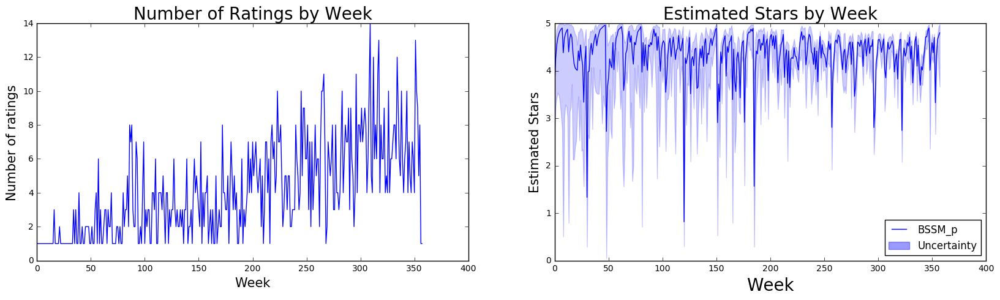

The Mirage
EM Sigma2:  0.401113339269


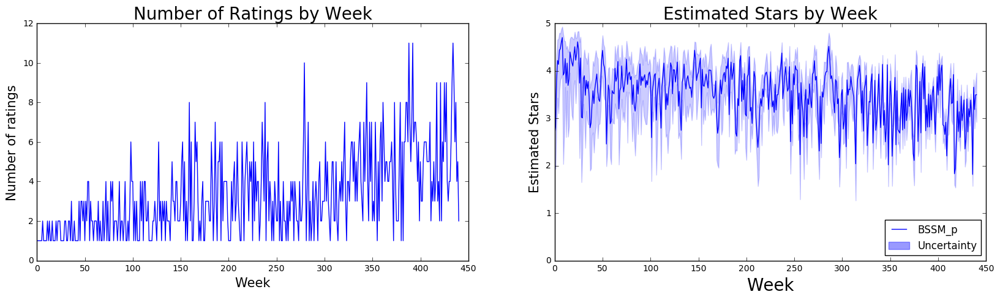

Bobby Q
EM Sigma2:  2.51806394338


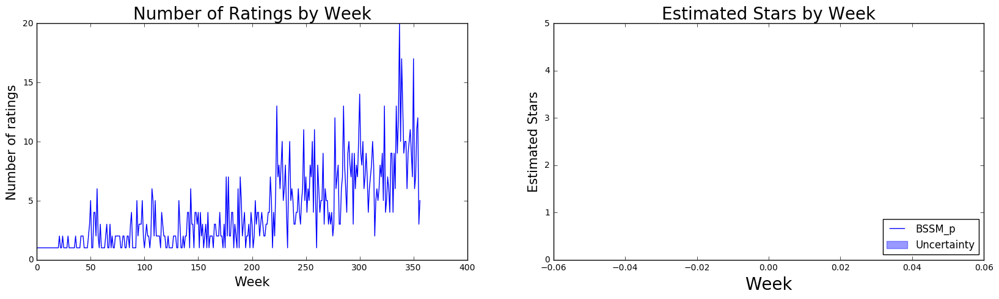

Tacos El Gordo
EM Sigma2:  0.573705327698


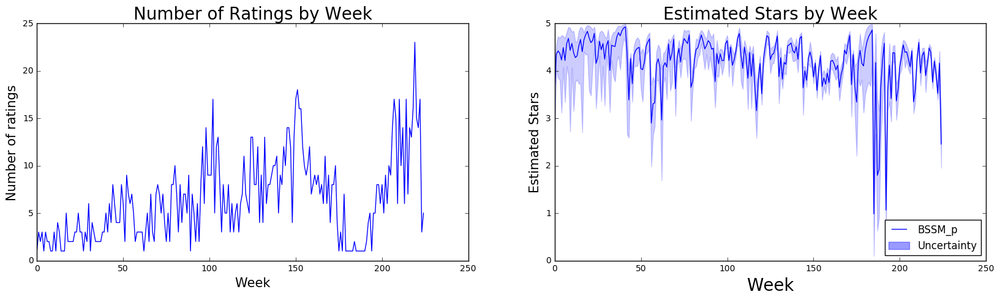

Circus Circus Las Vegas Hotel and Casino
EM Sigma2:  0.326865931283


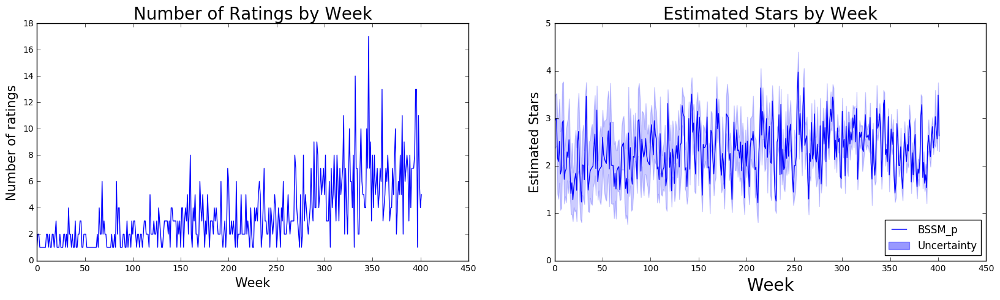

Cirque du Soleil - The Beatles LOVE
EM Sigma2:  1.69431990399


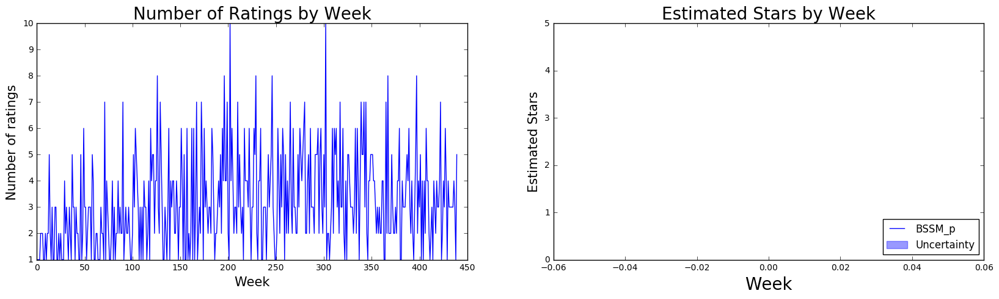

Joe's Seafood Prime Steak & Stone Crab
EM Sigma2:  3.50902936738


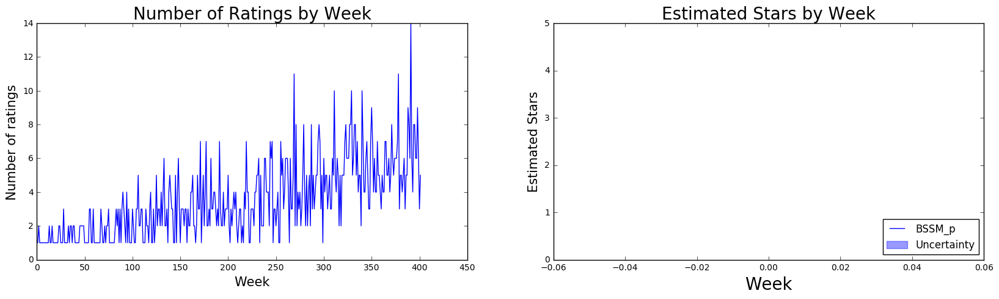

Lux Central
EM Sigma2:  0.727273561268


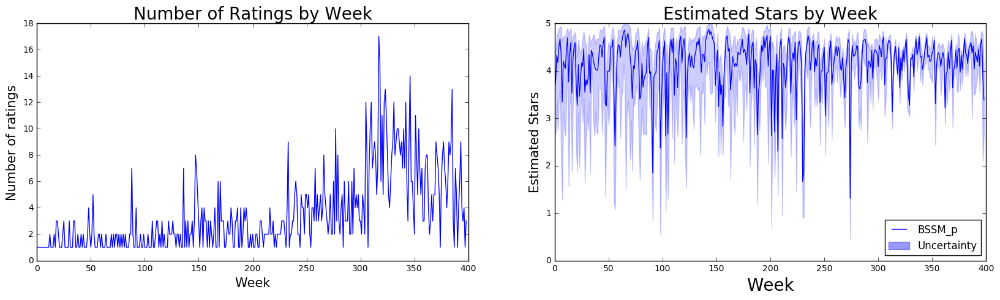

eat.
EM Sigma2:  0.355667304866


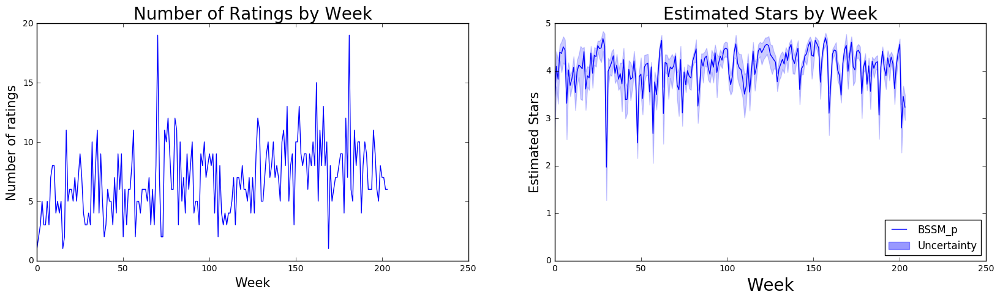

Yama Sushi
EM Sigma2:  5.32868050928


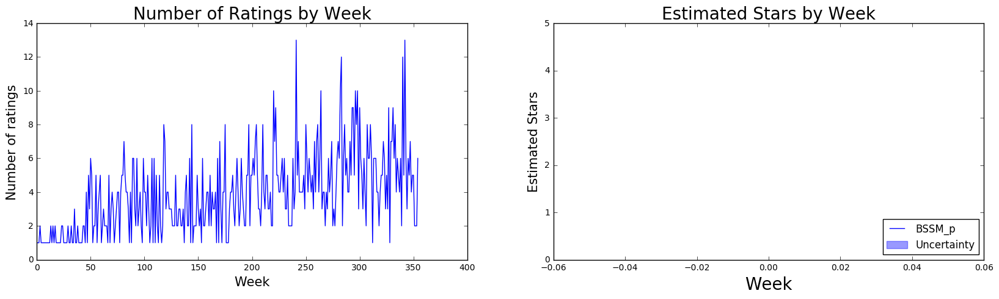

Rio All Suites Hotel & Casino
EM Sigma2:  0.384650536838


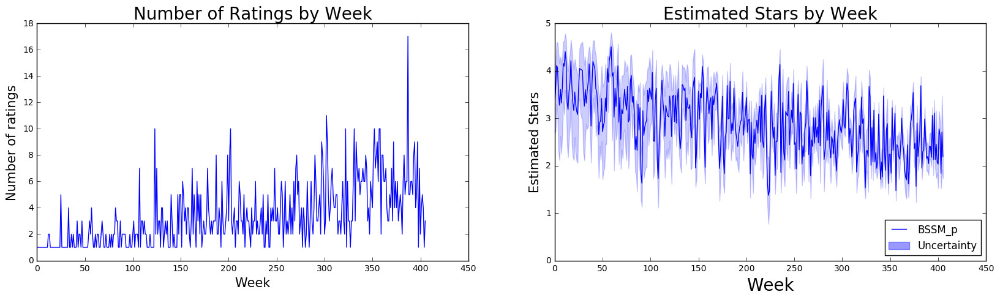

The Buffet at ARIA
EM Sigma2:  0.272395428228


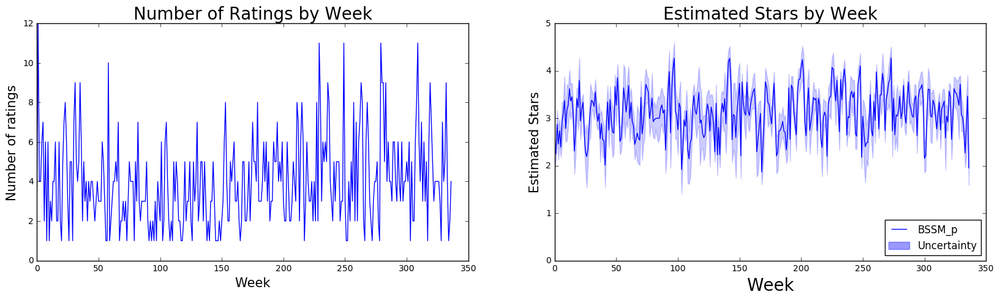

KA by Cirque Du Soleil
EM Sigma2:  1.94136048643


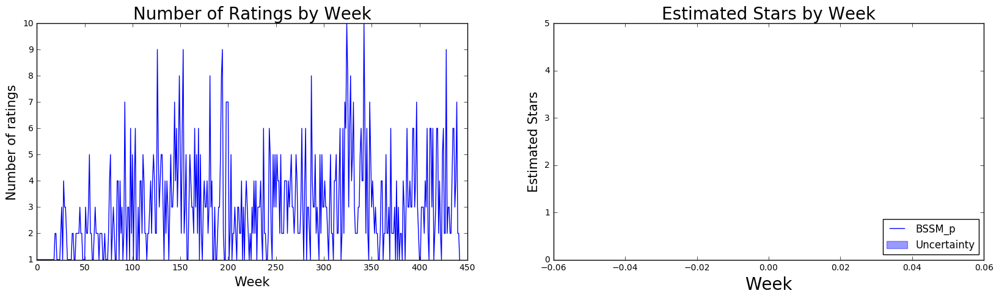

Sushi House Goyemon
EM Sigma2:  0.583365234971


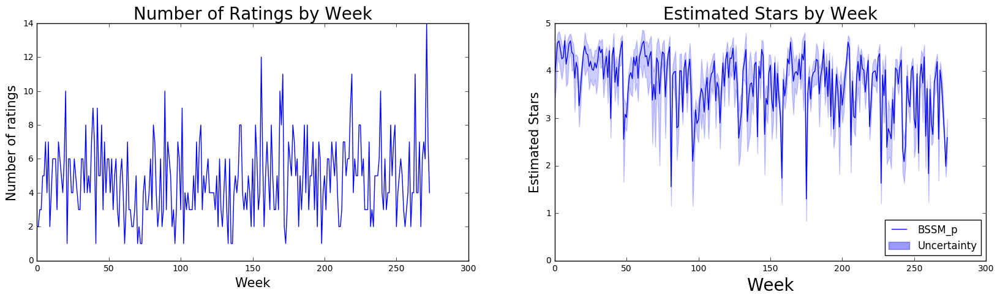

Cibo
EM Sigma2:  0.795383440891


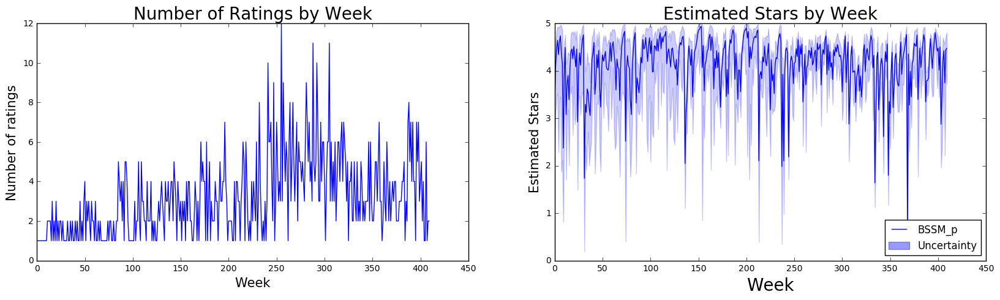

Spice Market Buffet
EM Sigma2:  0.324300637353


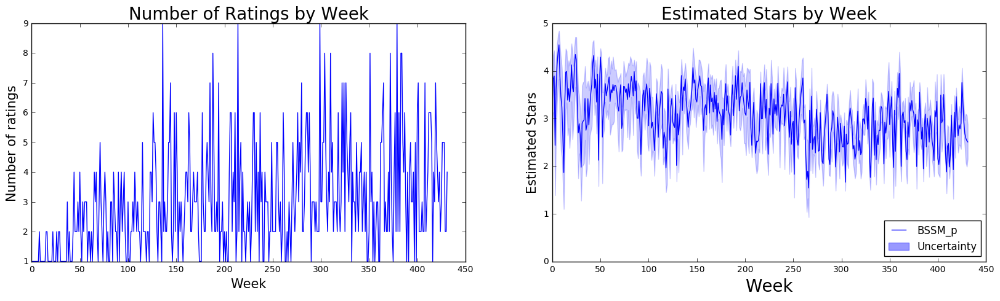

Olives
EM Sigma2:  0.52320296117


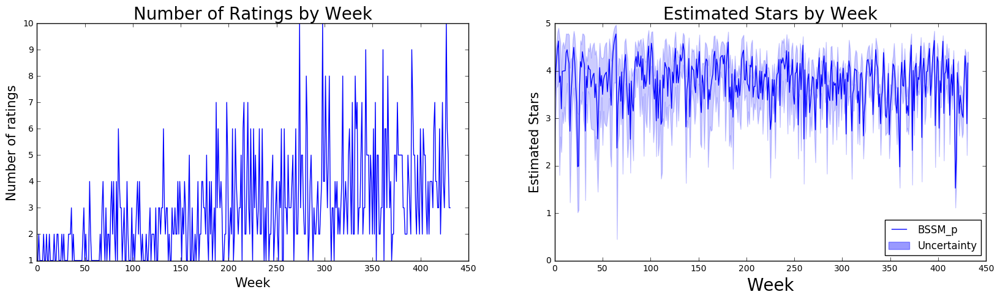

New York New York Hotel Casino
EM Sigma2:  0.334706932846


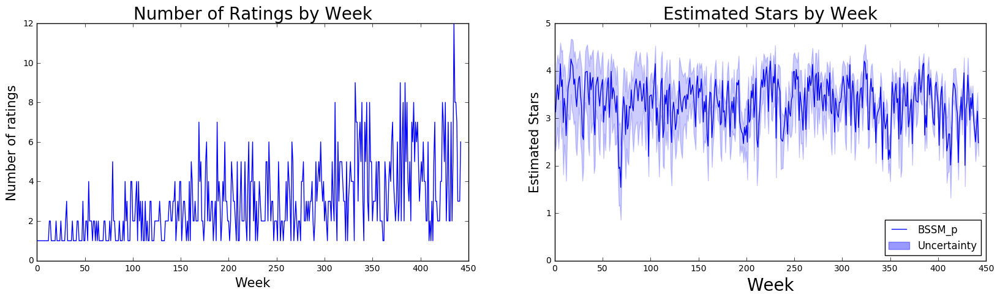

Schwartz's
EM Sigma2:  0.600786997348


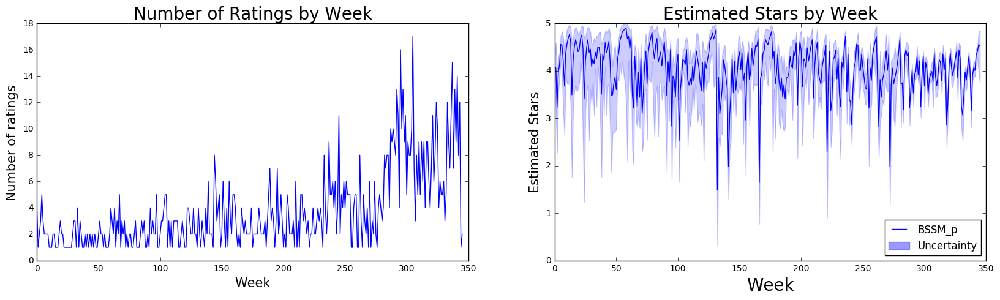

Joe's Farm Grill
EM Sigma2:  8.55296555718


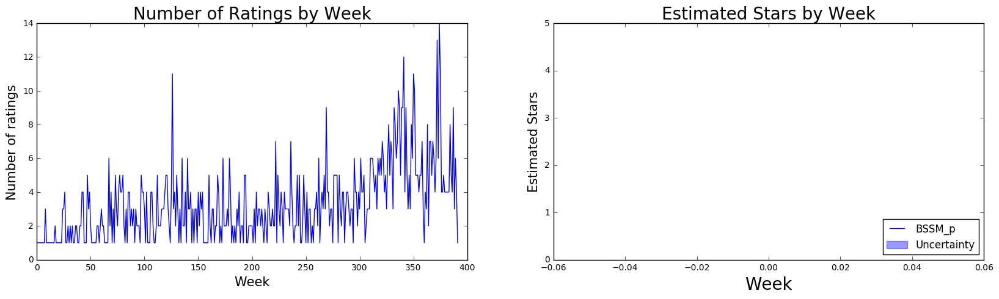

Pizza Rock
EM Sigma2:  0.339852958327


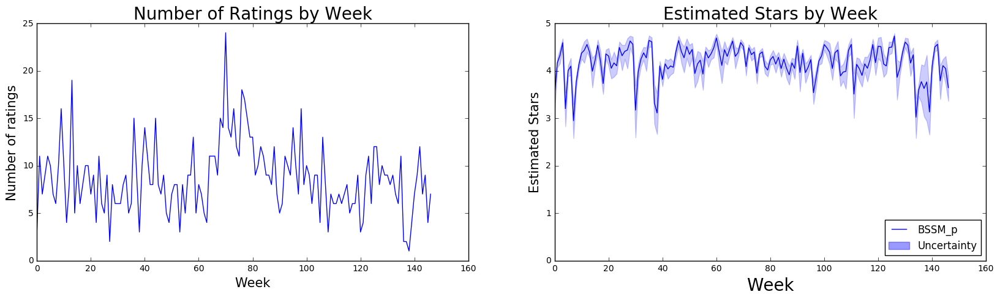

Encore
EM Sigma2:  1.22223924545


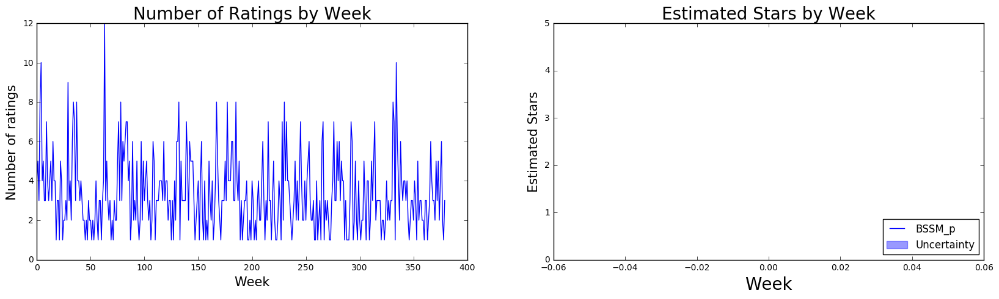

SLS Las Vegas Hotel & Casino
EM Sigma2:  0.119747864992


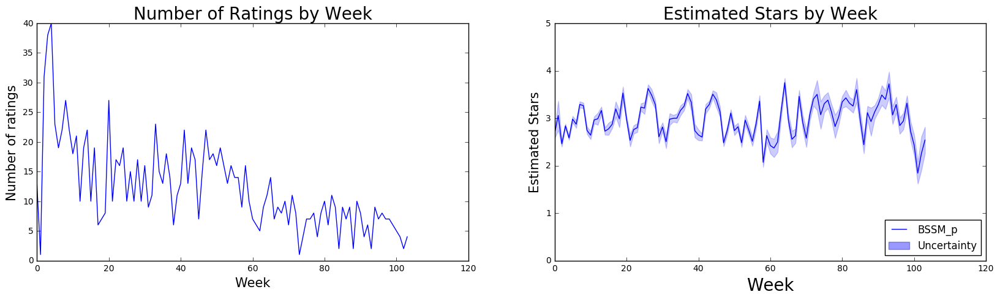

Cornish Pasty Company
EM Sigma2:  16.8470669491


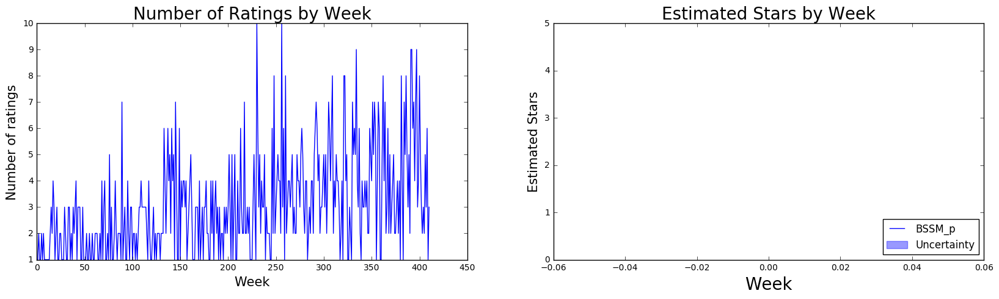

Hot N Juicy Crawfish
EM Sigma2:  0.631403284306


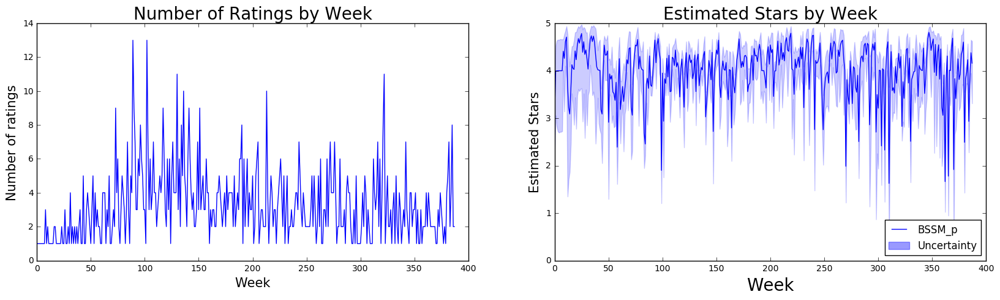

Golden Nugget Hotel & Casino
EM Sigma2:  0.48360529889


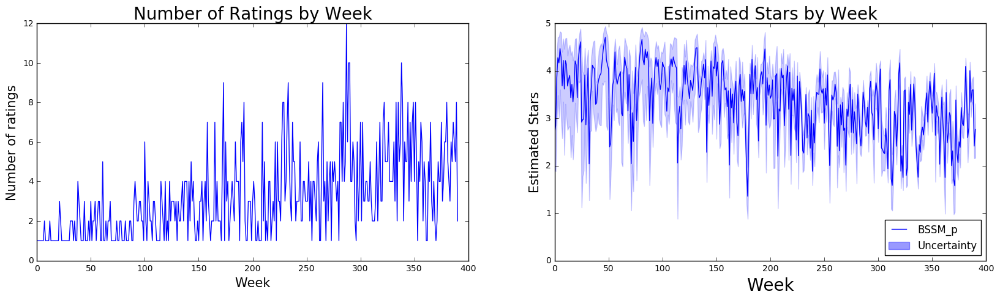

Carnival World Buffet
EM Sigma2:  0.492890871575


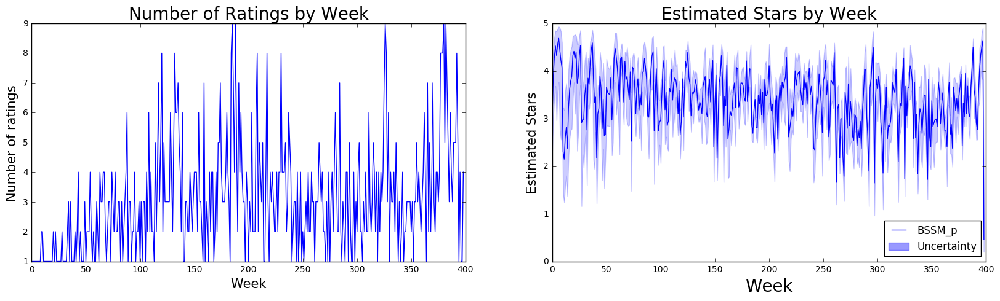

Citizen Public House
EM Sigma2:  0.594261561408


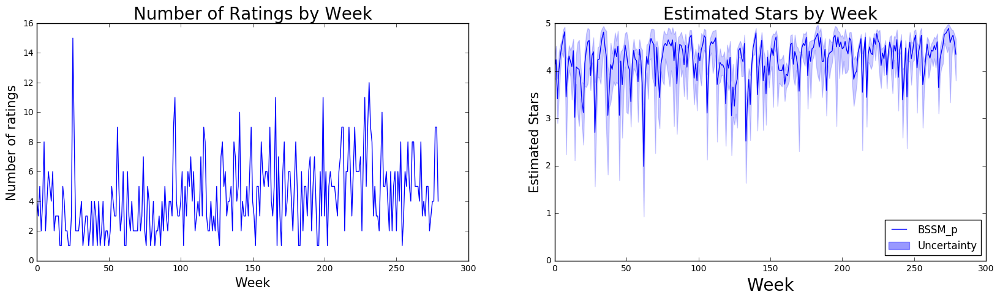

Julian Serrano
EM Sigma2:  0.426414915589


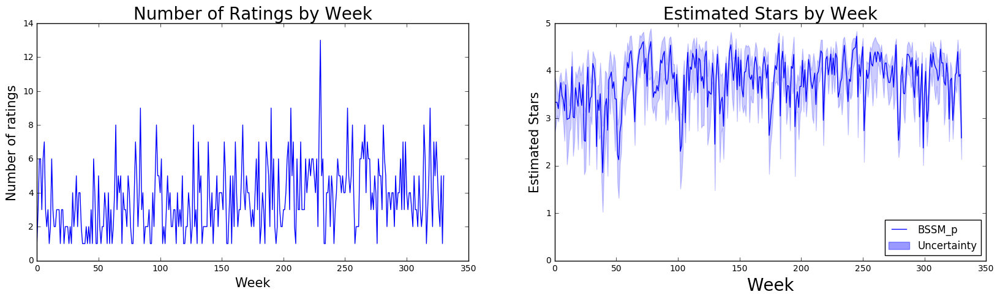

Firefly
EM Sigma2:  0.569708250156


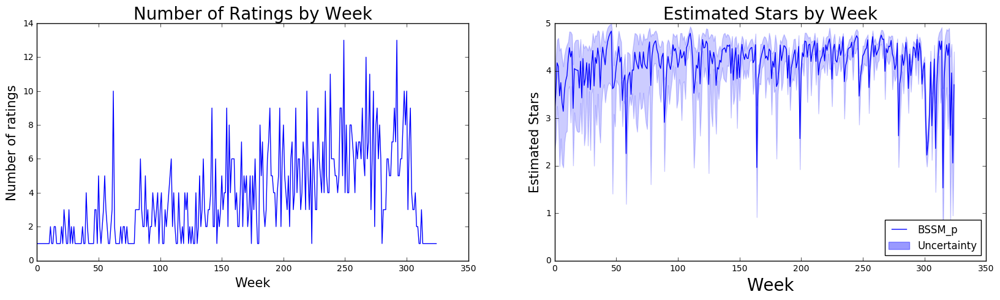

Trump Hotel
EM Sigma2:  0.79488971071


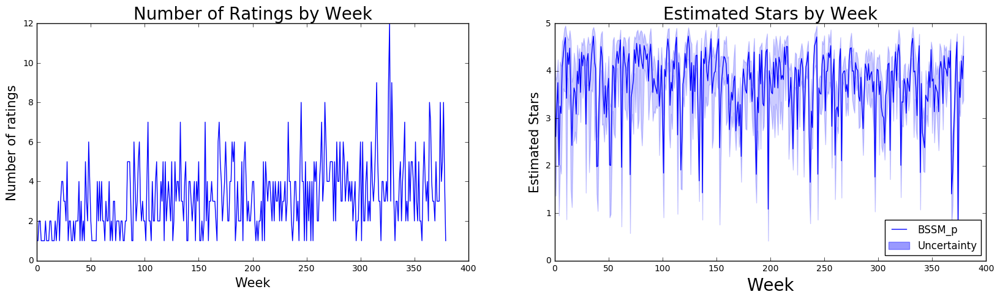

The Mission
EM Sigma2:  0.55765663455


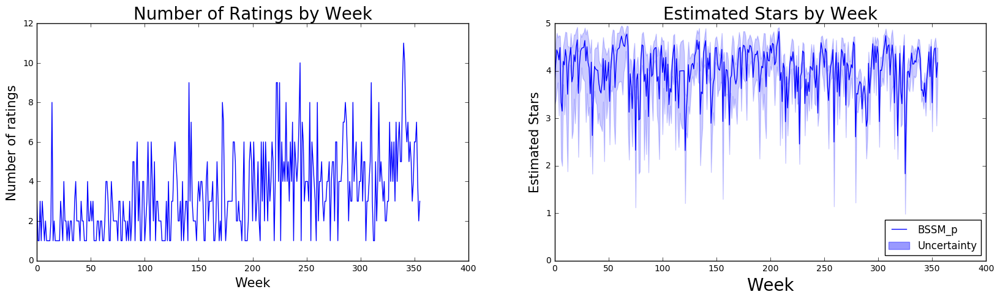

Charlotte Douglas International Airport
EM Sigma2:  0.307633745468


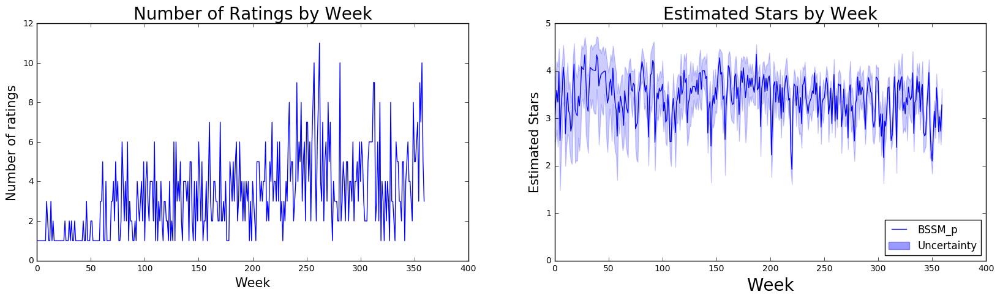

LAVO Italian Restaurant & Lounge
EM Sigma2:  0.580345228729


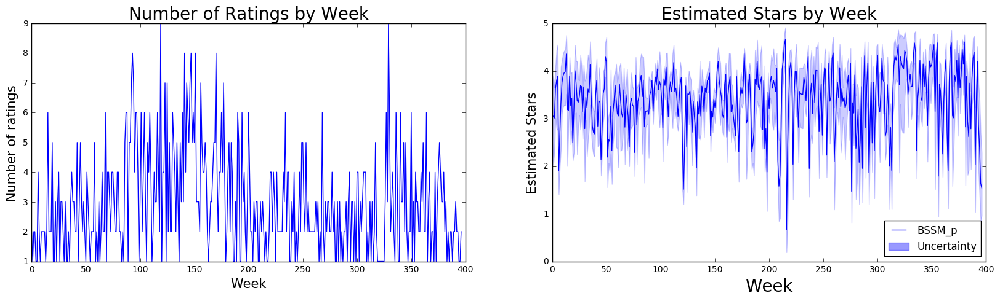

Rehab Burger Therapy
EM Sigma2:  0.442392974123


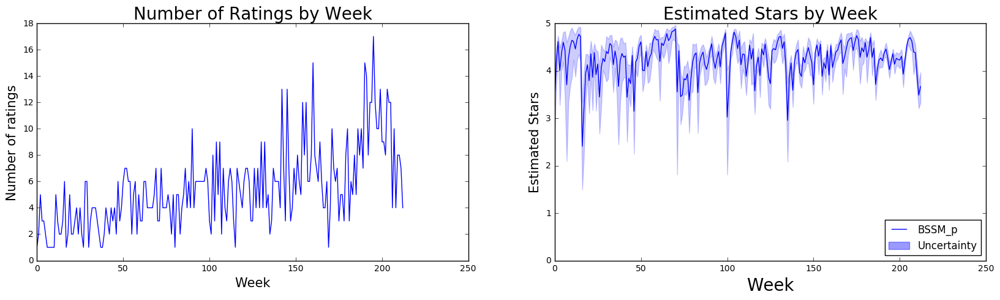

Gen Korean BBQ House
EM Sigma2:  0.350667562353


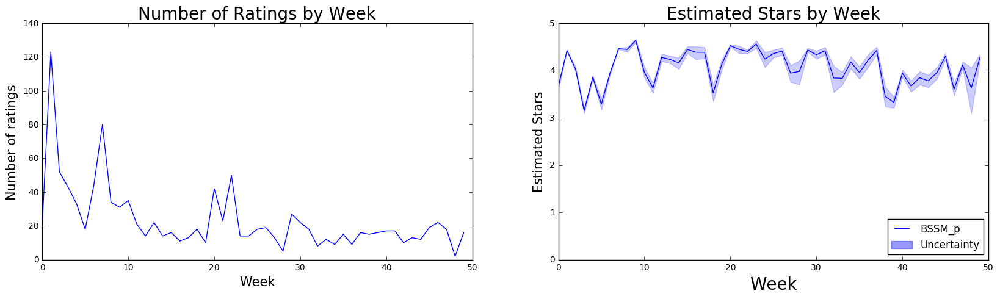

Hakkasan Nightclub
EM Sigma2:  0.220845630819


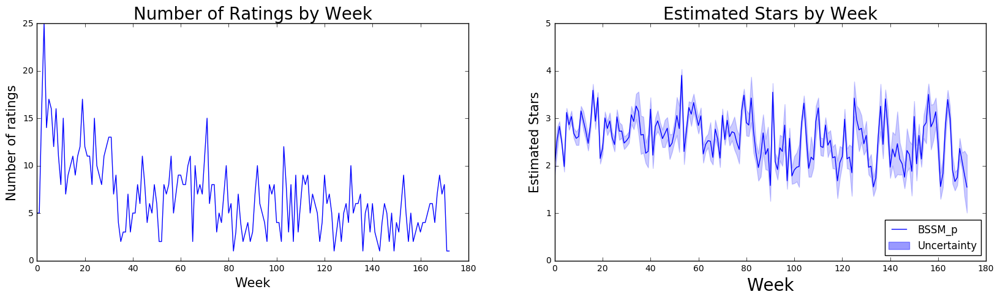

Ichiza
EM Sigma2:  0.693768023393


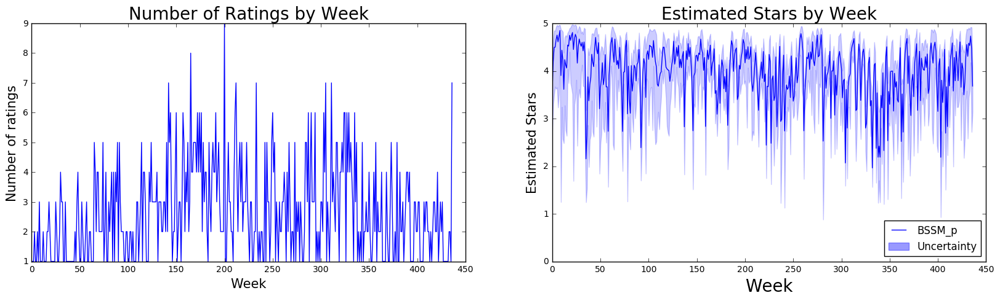

Stratosphere
EM Sigma2:  0.395467751643


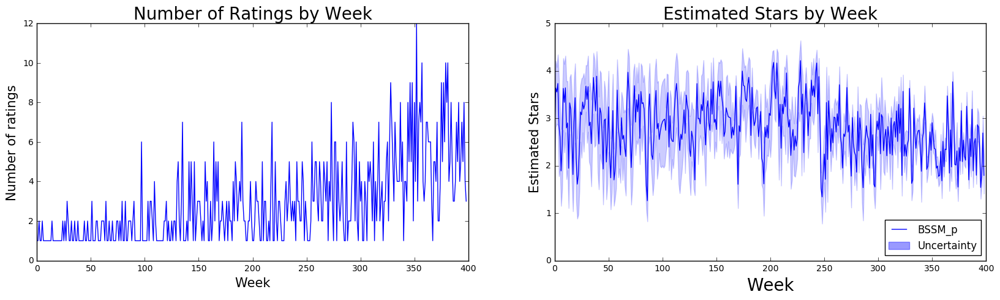

Delmonico Steakhouse
EM Sigma2:  0.800539622402


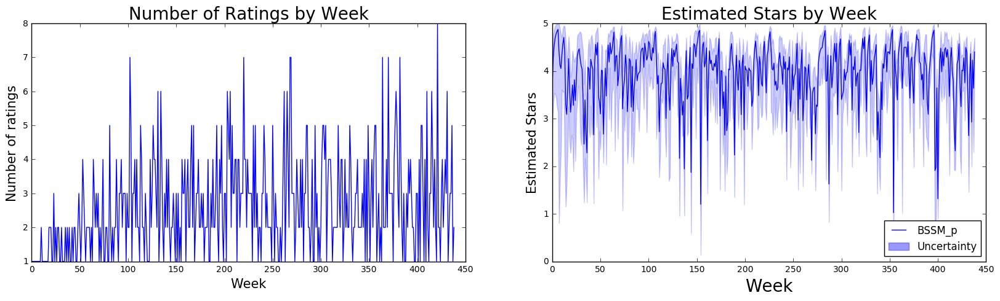

Echo & Rig
EM Sigma2:  2.88140671473


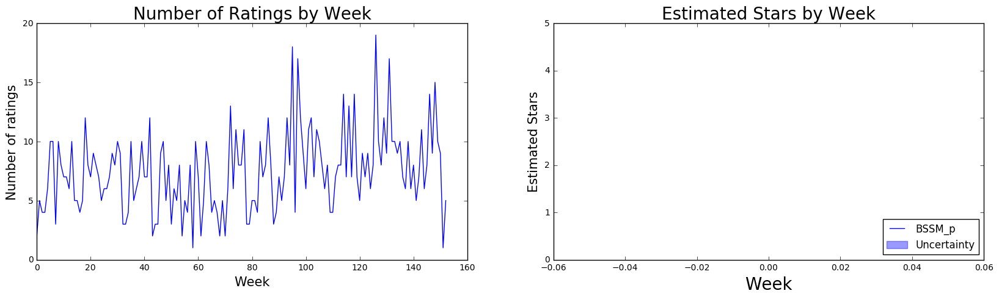

The Signature at MGM Grand
EM Sigma2:  0.868778545494


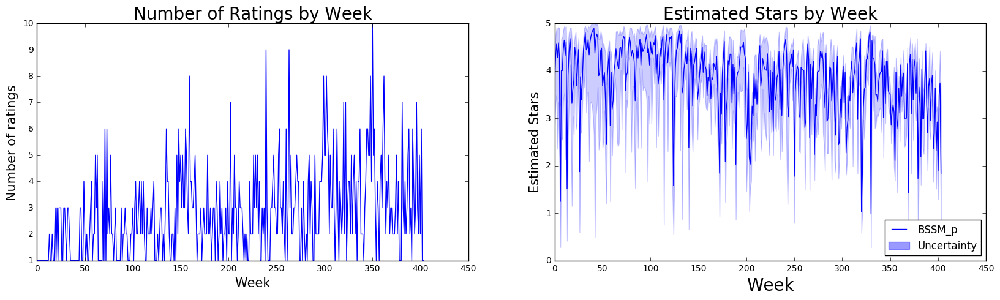

Todd English P.U.B.
EM Sigma2:  0.369650985326


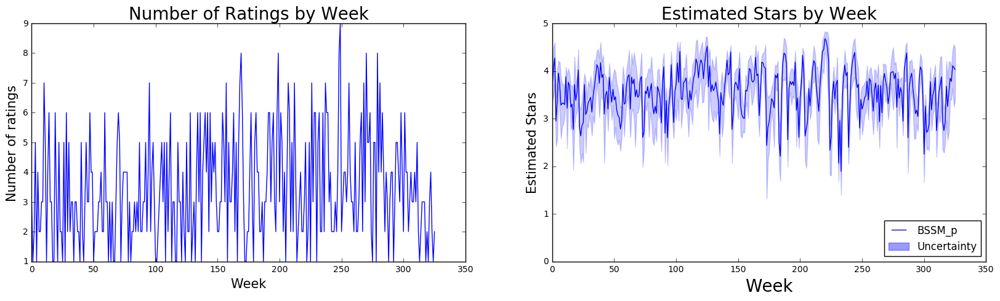

Bally's Las Vegas Hotel & Casino
EM Sigma2:  0.39494388421


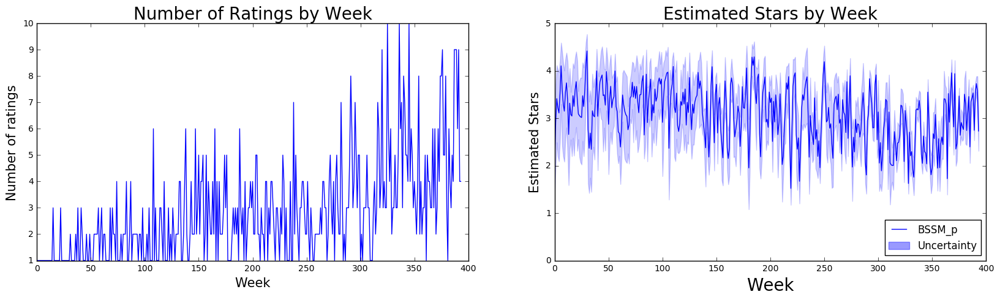

Absinthe
EM Sigma2:  19.4504478921


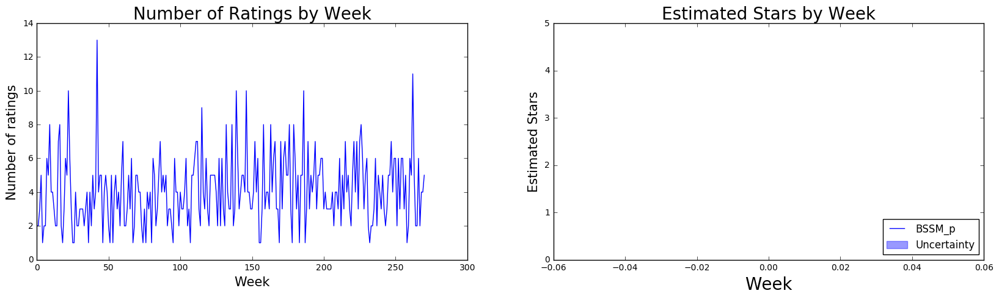

Lo-Lo's Chicken & Waffles
EM Sigma2:  2.85620296011


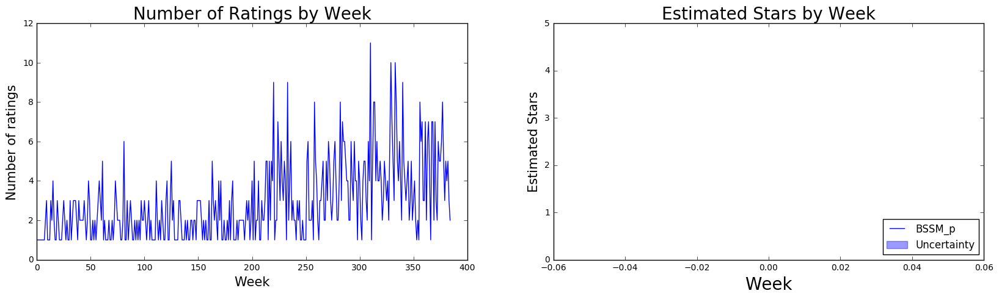

Egg Works
EM Sigma2:  2.15488738334


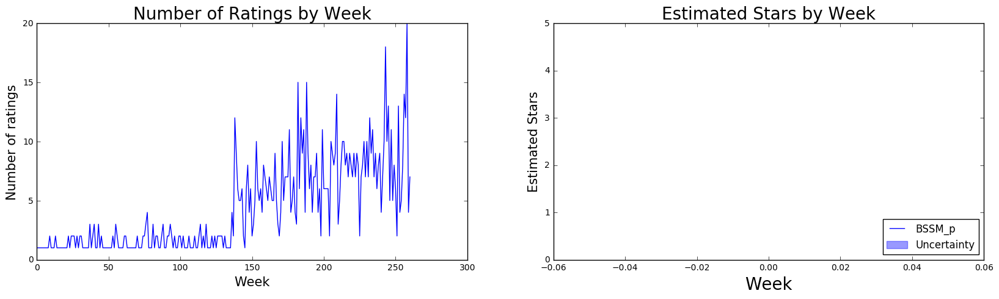

Las Vegas Guest List
EM Sigma2:  9.5612212878


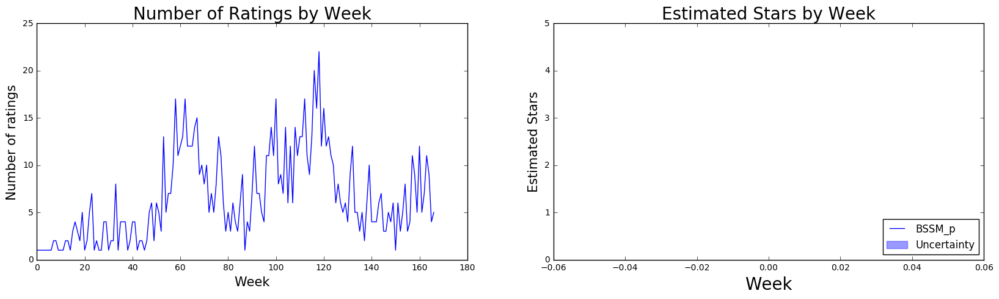

Meat & Potatoes
EM Sigma2:  0.819051522501


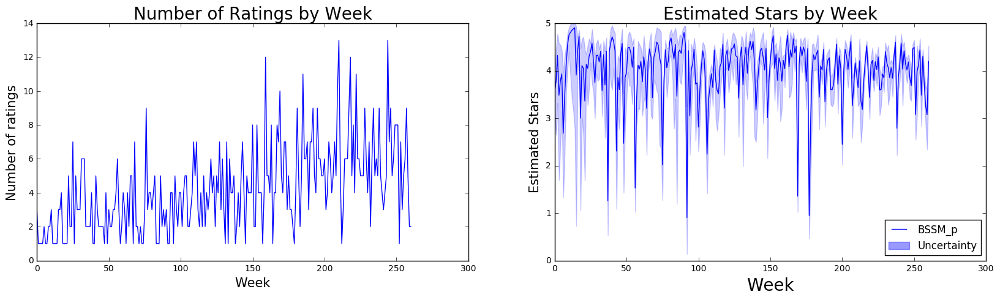

Matt's Big Breakfast
EM Sigma2:  0.308492874675


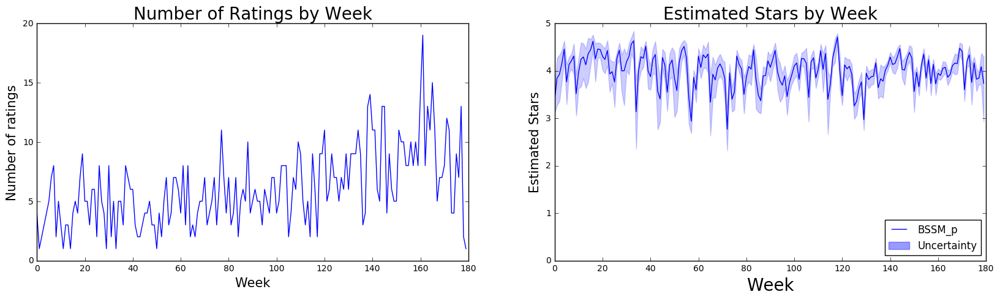

The Old Fashioned
EM Sigma2:  0.56925774302


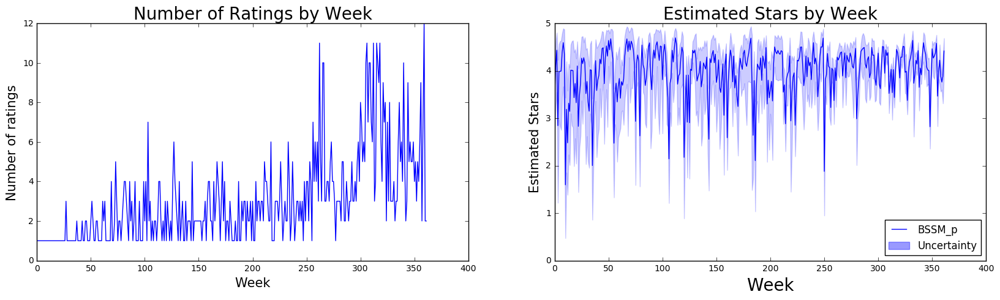

Olive & Ivy
EM Sigma2:  0.759425860437


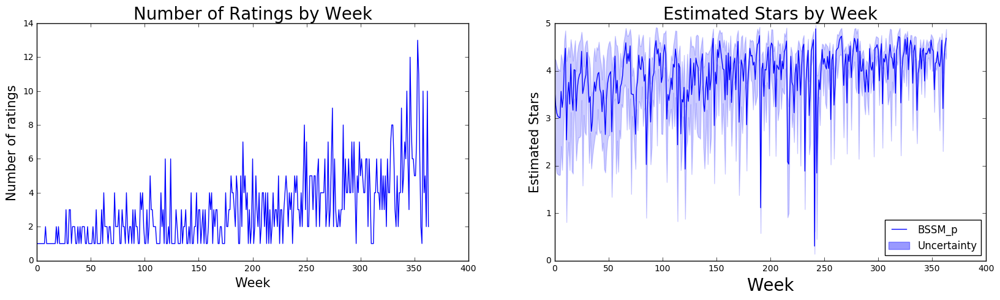

Eiffel Tower Restaurant
EM Sigma2:  4.51043579303


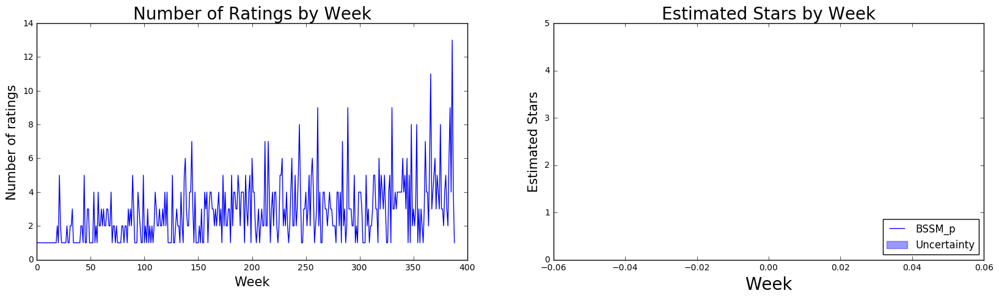

Wolfgang Puck Bar & Grill
EM Sigma2:  0.533462446803


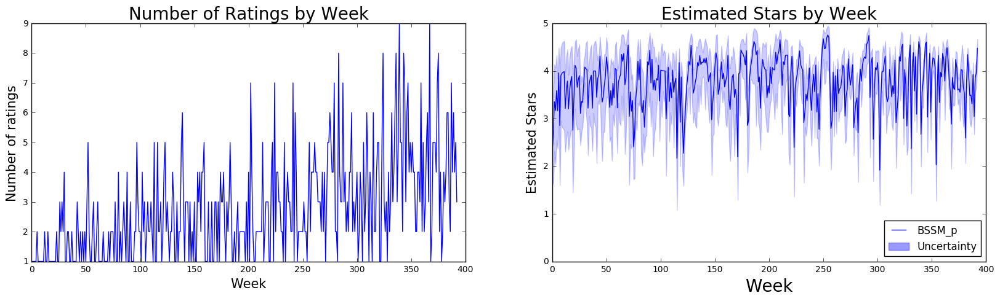

St. Francis Restaurant
EM Sigma2:  0.479468825321


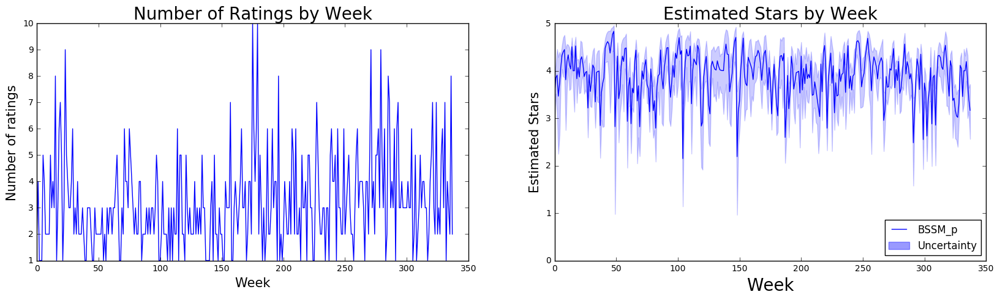

Border Grill
EM Sigma2:  7.79902197494


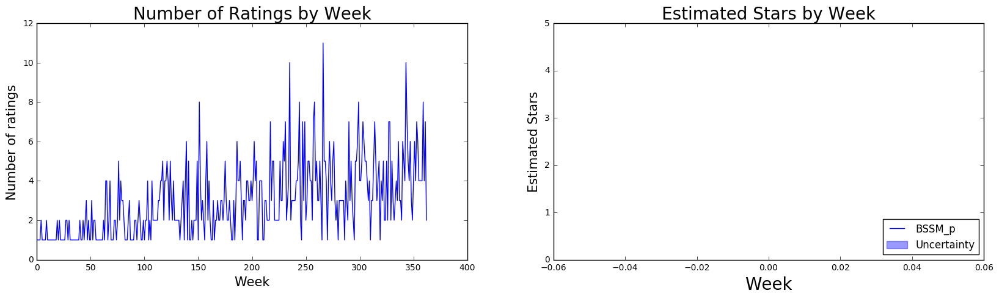

Cirque du Soleil - O
EM Sigma2:  0.851341547037


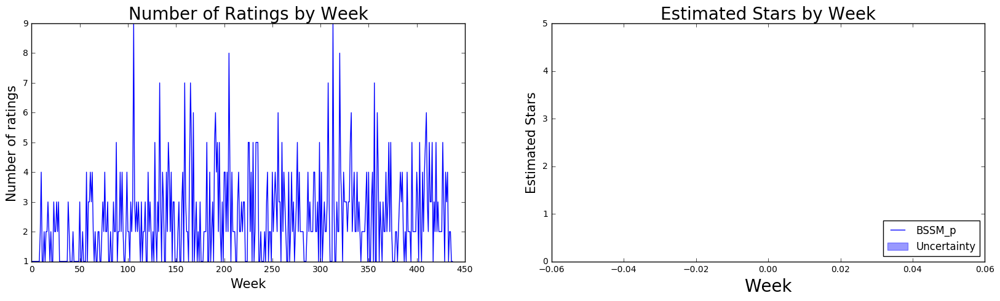

Postino Arcadia
EM Sigma2:  2.32980056397


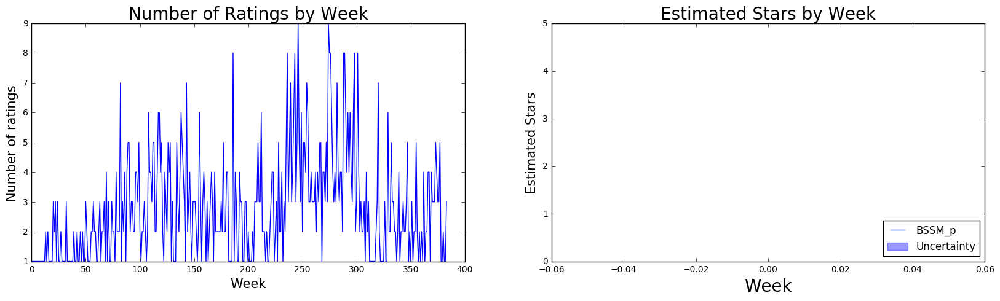

FEZ
EM Sigma2:  0.736775074247


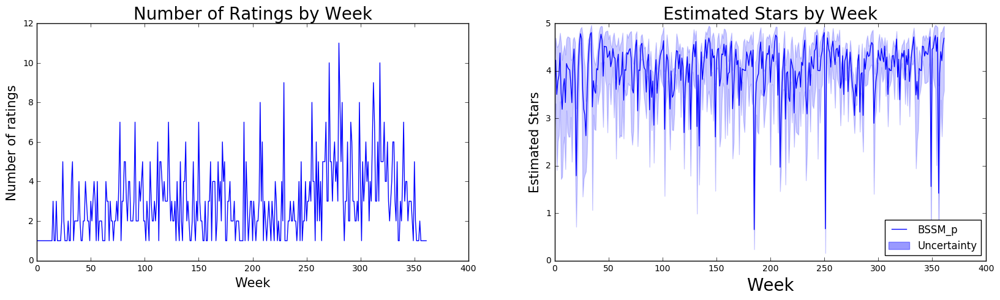

Mr. Mamas
EM Sigma2:  0.480156968015


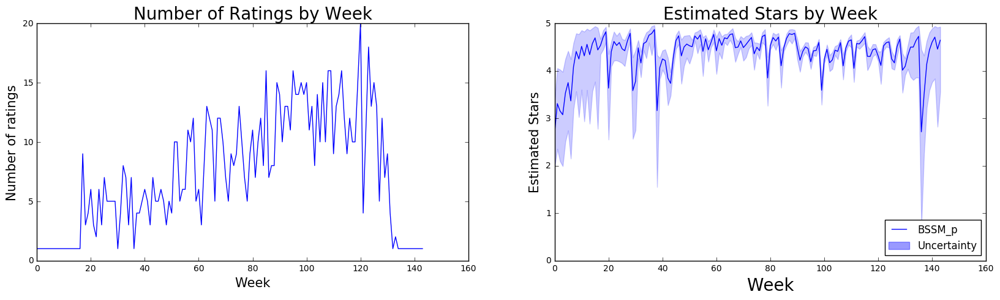

TAO Asian Bistro
EM Sigma2:  0.817970459979


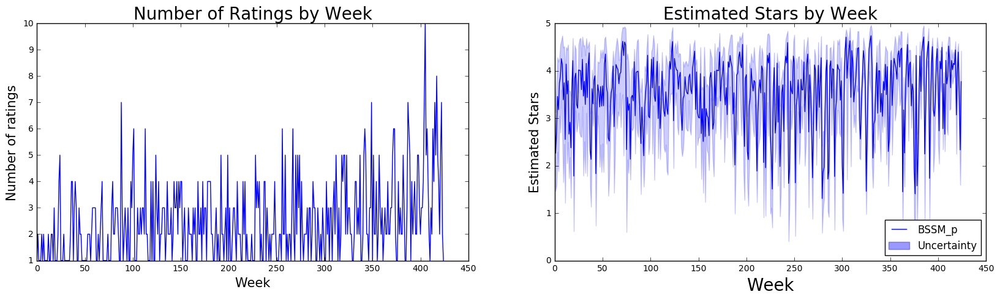

Amélie's French Bakery
EM Sigma2:  0.529386309098


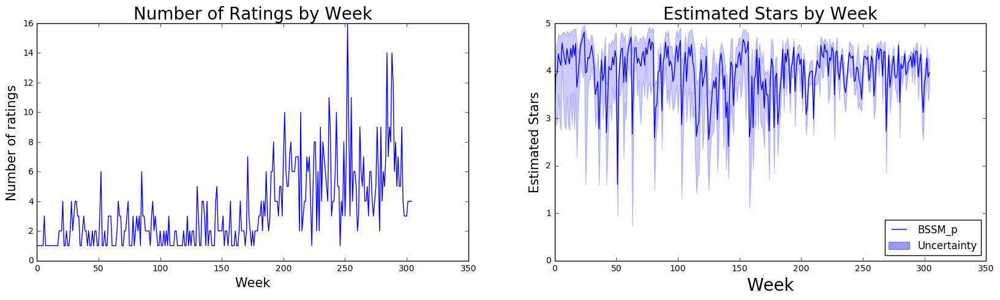

SkinnyFATS
EM Sigma2:  0.387298313014


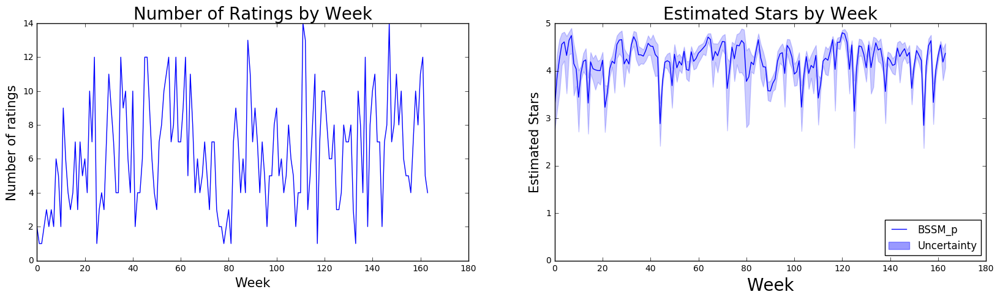

La Santisima
EM Sigma2:  0.976794979166


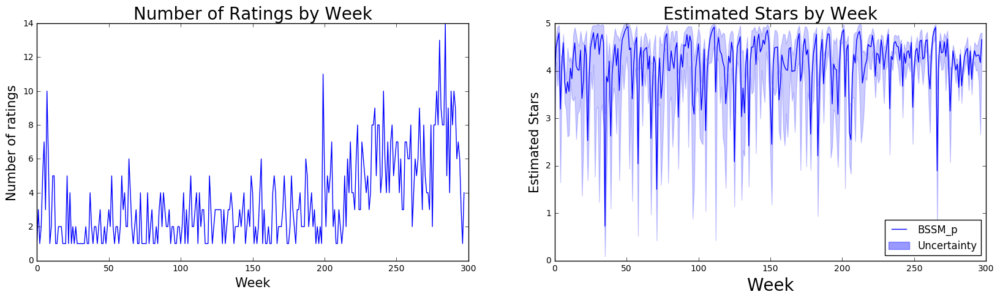

KoMex Fusion
EM Sigma2:  0.865175014758


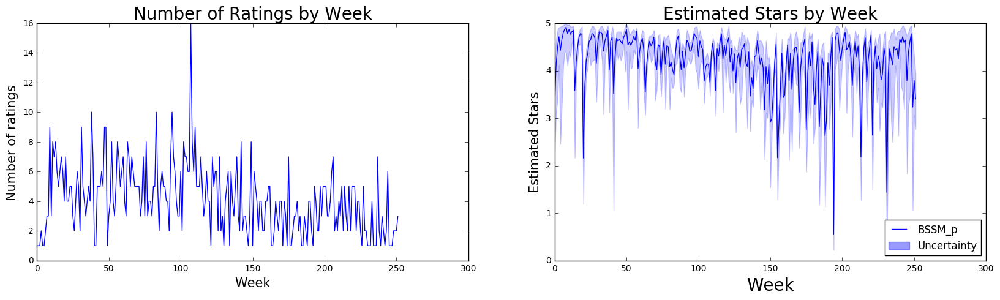

The Arrogant Butcher
EM Sigma2:  0.371940147034


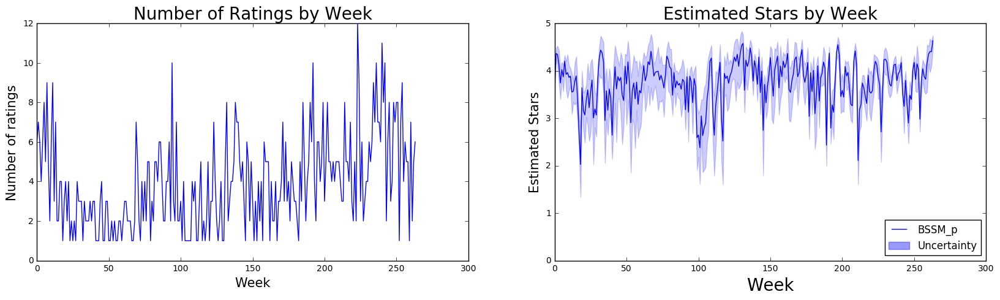

China Poblano
EM Sigma2:  0.304438558604


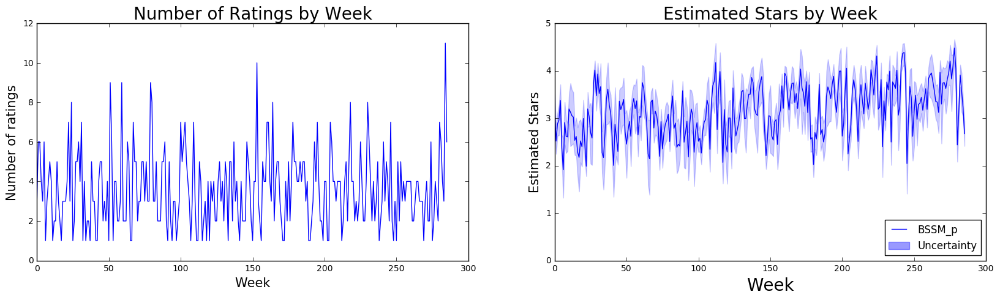

Hooters Casino Hotel
EM Sigma2:  0.384282244781


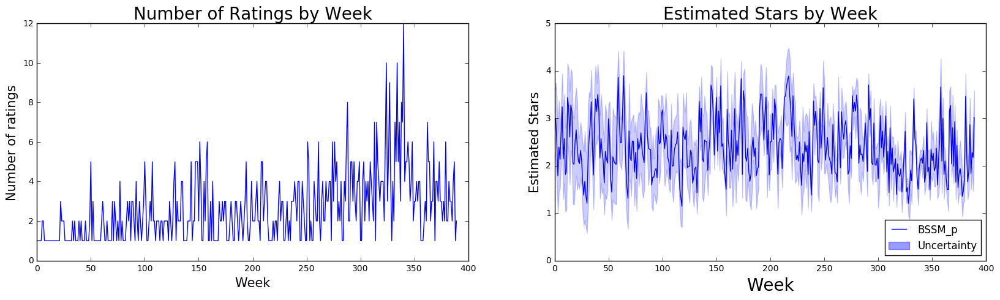

Cirque du Soleil - Zumanity
EM Sigma2:  0.741466266415


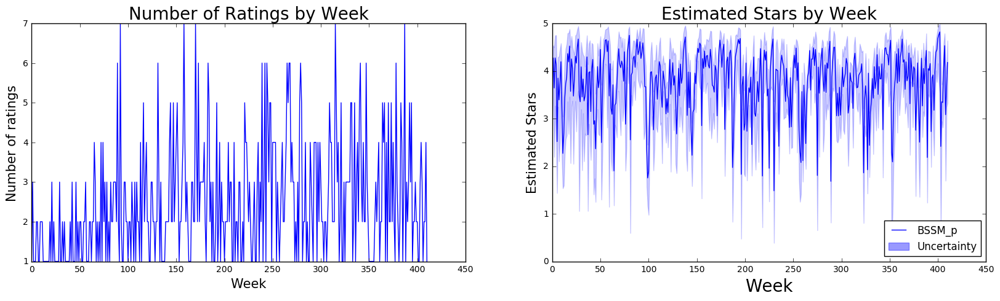

Chino Bandido
EM Sigma2:  6.26949221152


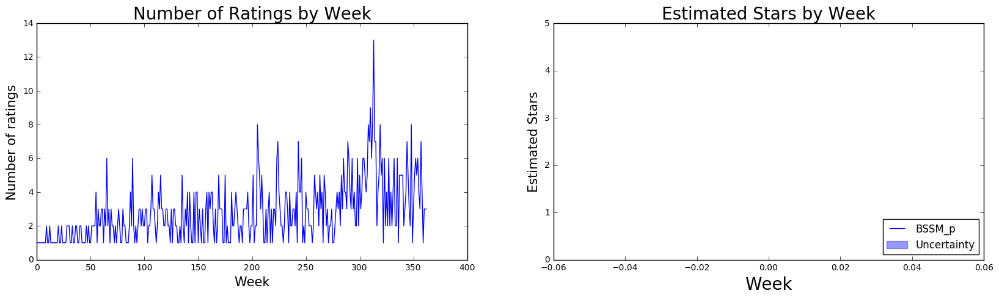

Margaritaville
EM Sigma2:  0.507650616173


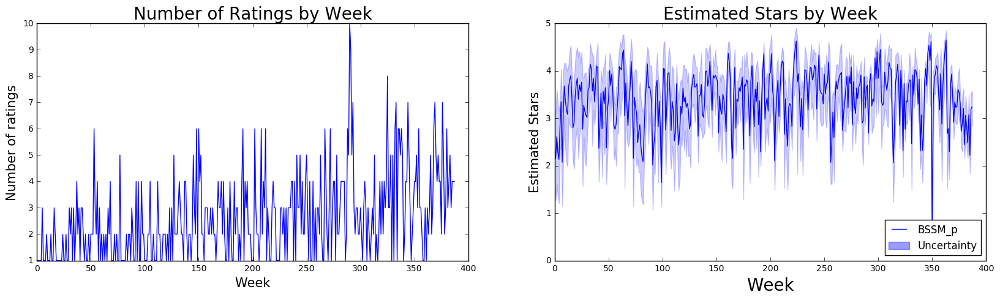

The Cowfish Sushi Burger Bar
EM Sigma2:  0.462056504172


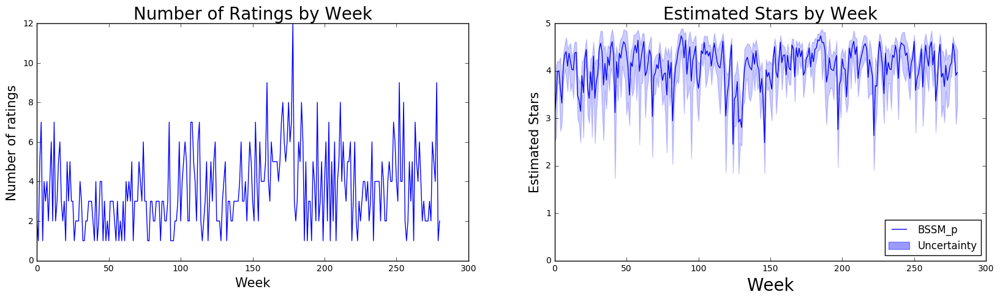

Carson Kitchen
EM Sigma2:  0.375863686374


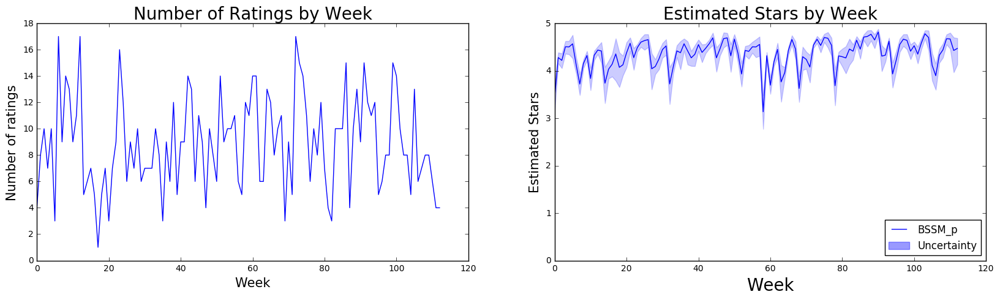

Tropicana Las Vegas
EM Sigma2:  0.369674697186


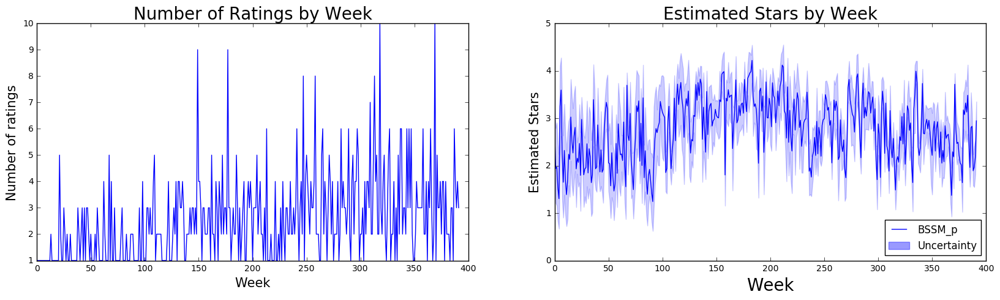

Soho Japanese Restaurant
EM Sigma2:  0.610384289715


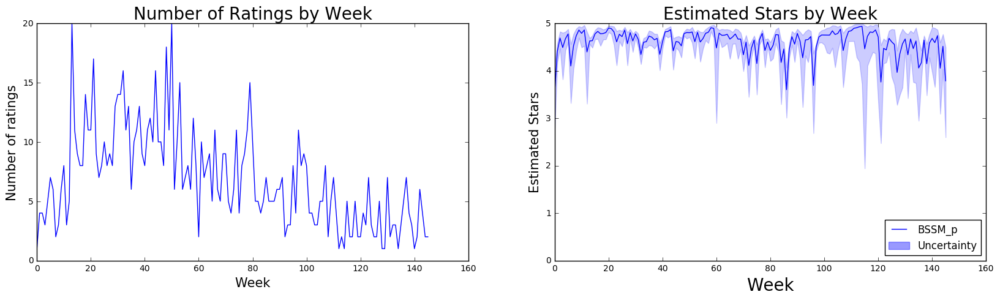

TACOS EL GORDO
EM Sigma2:  4.13358999899


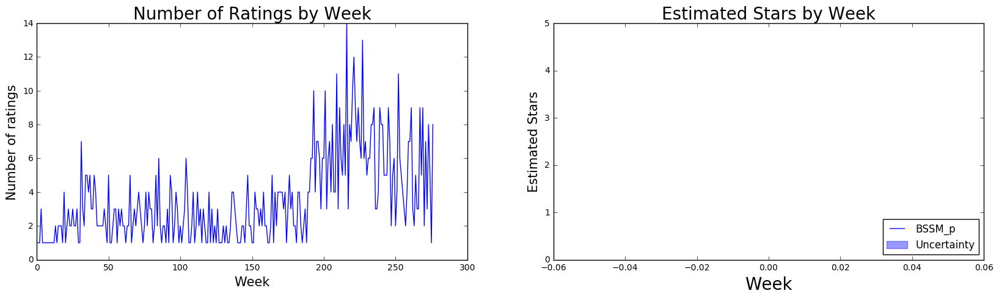

Raku
EM Sigma2:  2.24770272462


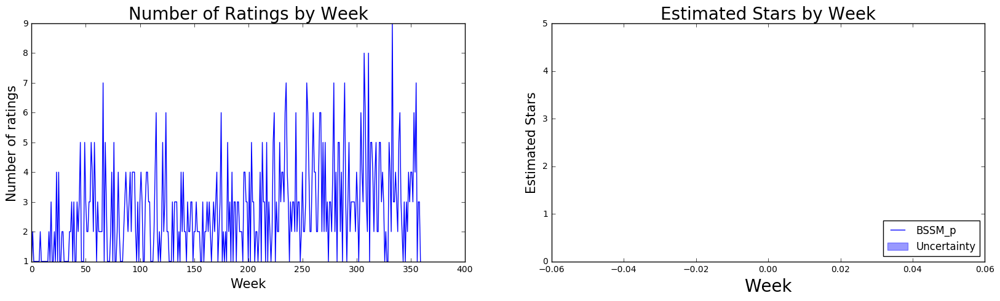

Red Rock Casino Resort & Spa
EM Sigma2:  19.2765760817


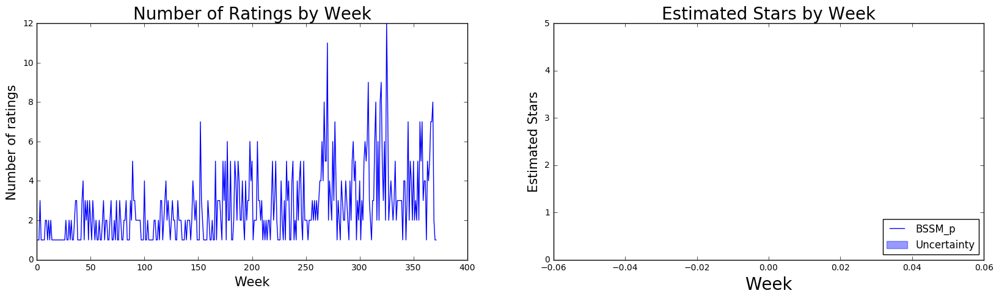

Carnevino
EM Sigma2:  0.891438241235


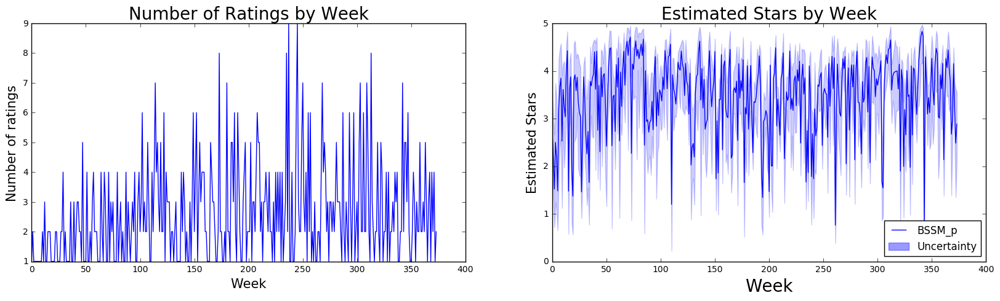

STK Las Vegas
EM Sigma2:  0.511978726741


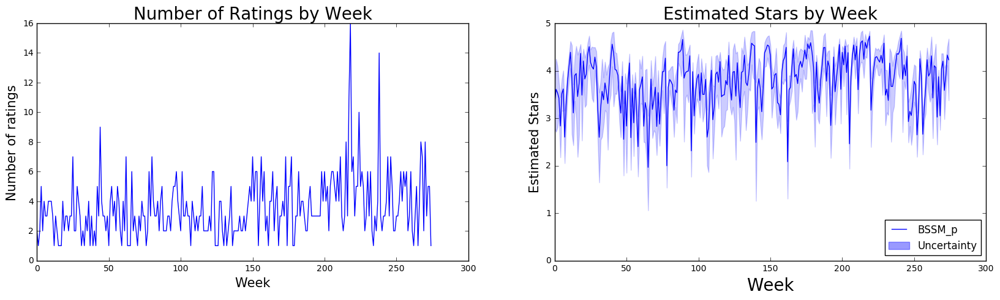

Del Frisco's Double Eagle Steak House
EM Sigma2:  1.87756787139


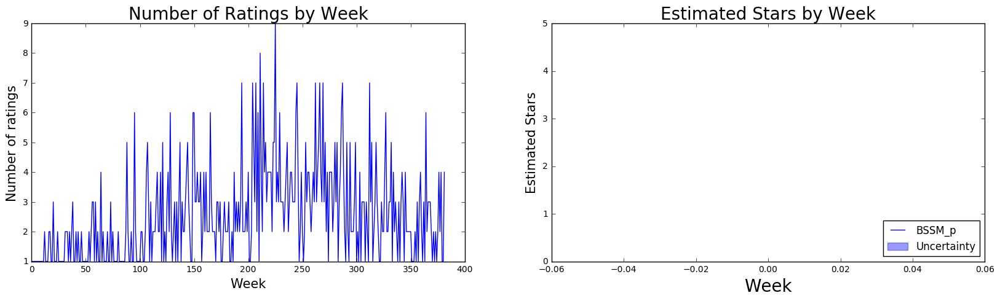

BLT Burger
EM Sigma2:  0.377869043962


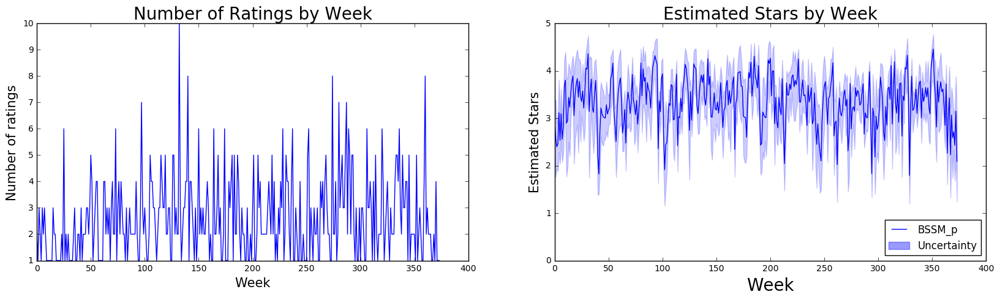

Liberty Market
EM Sigma2:  1.94518932563


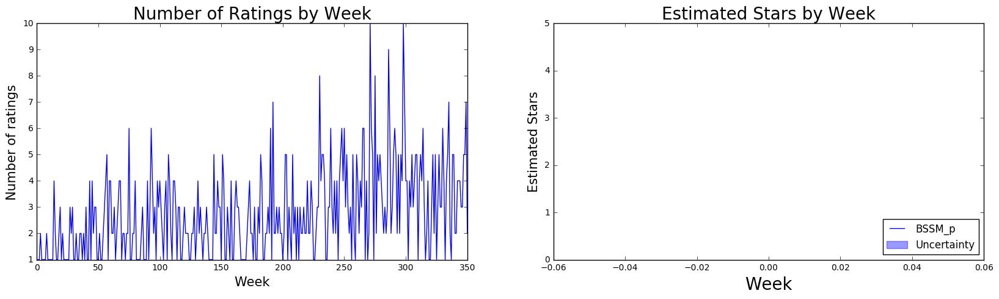

South Point Hotel, Casino & Spa
EM Sigma2:  0.634865693835


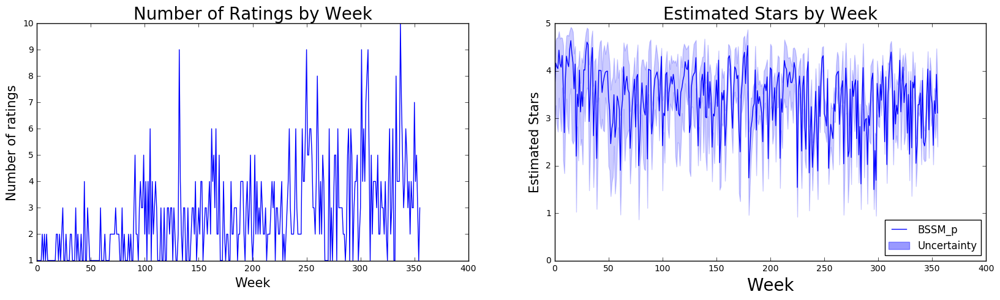

Hofbräuhaus Las Vegas
EM Sigma2:  0.647992887044


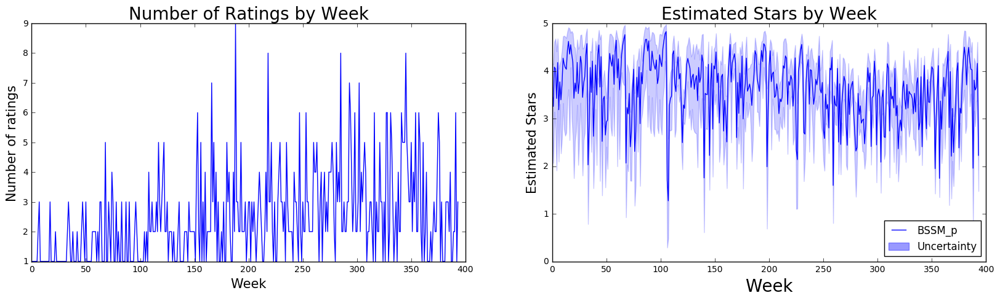

Yard House Town Square
EM Sigma2:  0.489751756539


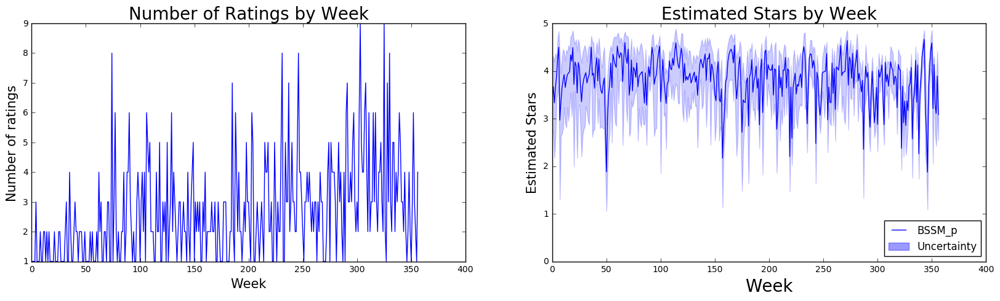

Le Thai
EM Sigma2:  75.8559386214


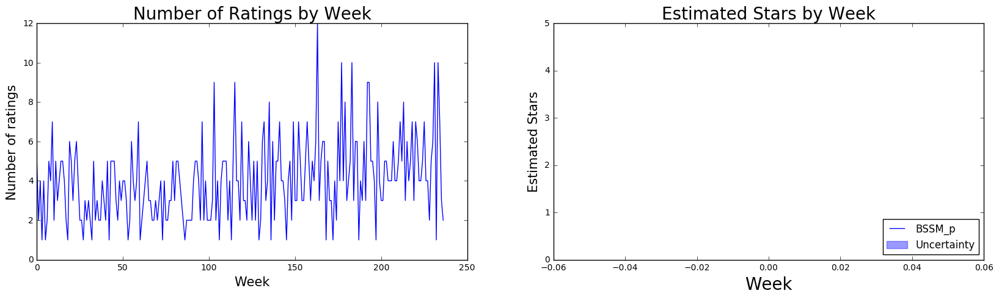

Cravings Buffet
EM Sigma2:  0.514184369893


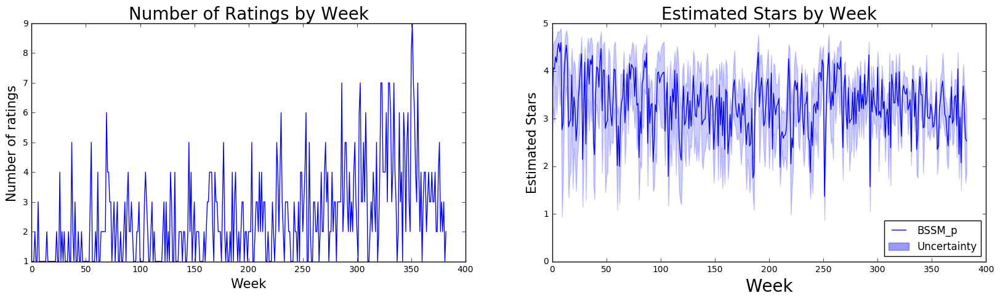

Chelsea's Kitchen
EM Sigma2:  10.7724386014


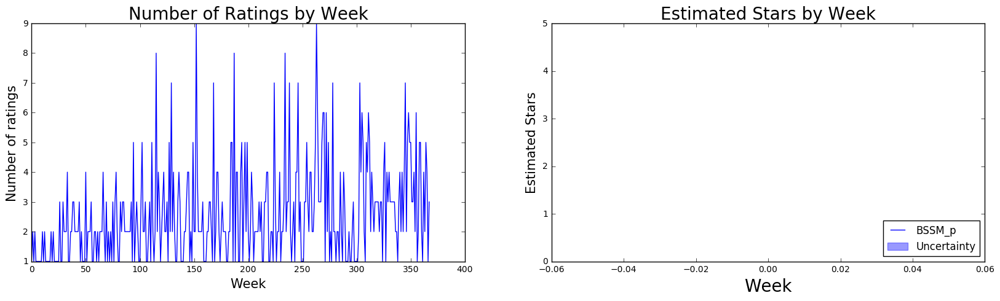

Firefly
EM Sigma2:  1.33354398831


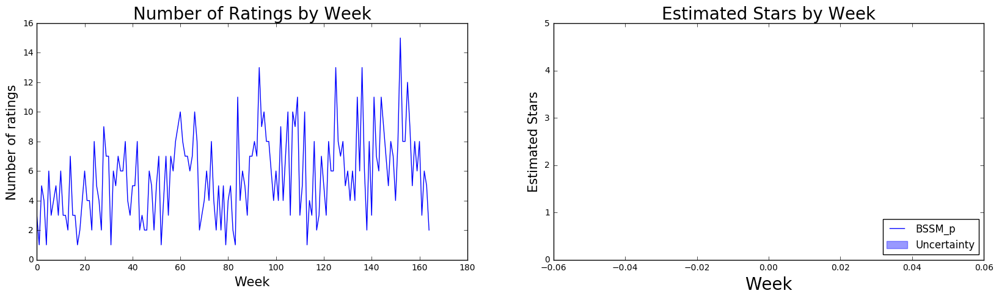

Jean Philippe Patisserie
EM Sigma2:  0.605844093478


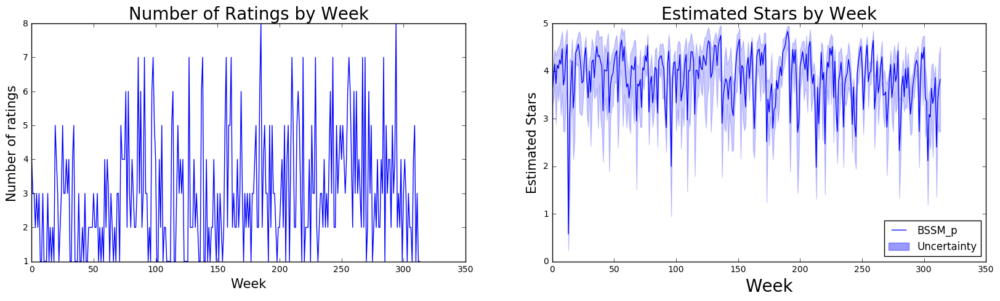

CUT
EM Sigma2:  5.9921303181


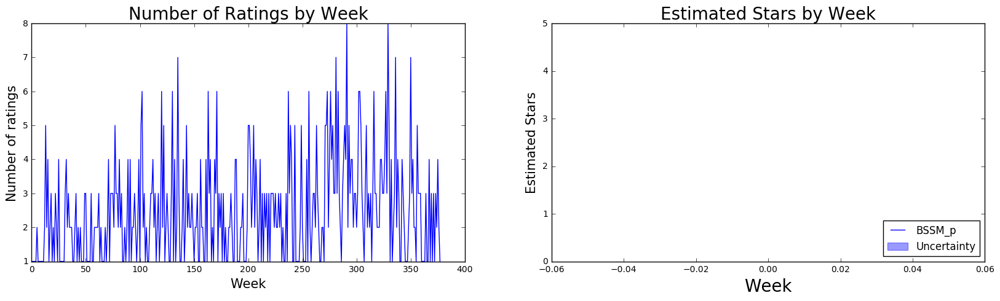

Mastro's Ocean Club
EM Sigma2:  2.09243566761


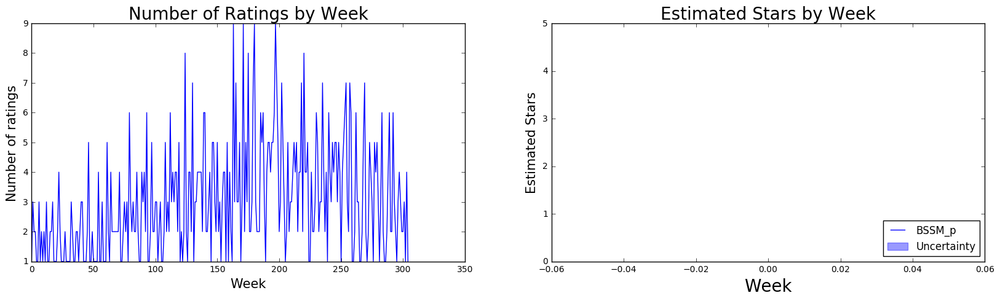

Yardbird Southern Table & Bar
EM Sigma2:  0.420090736709


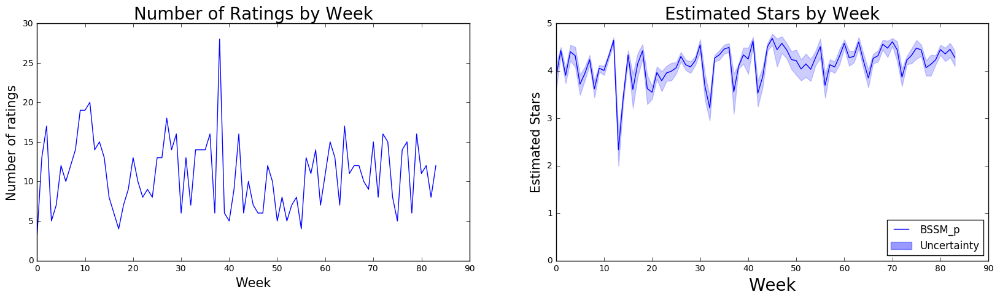

Fremont Street Experience
EM Sigma2:  0.524867842925


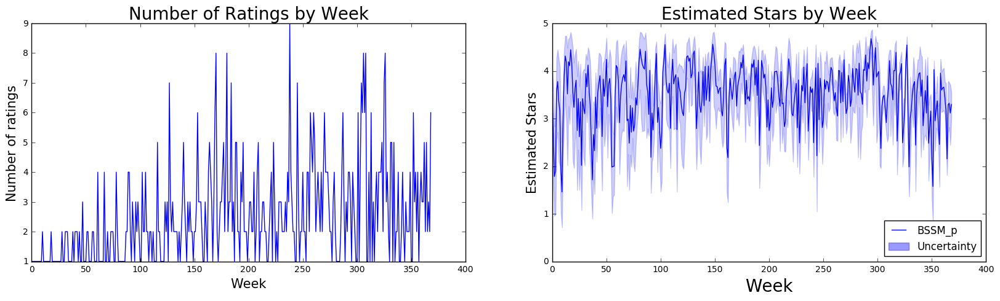

Mr Mamas
EM Sigma2:  0.584499461621


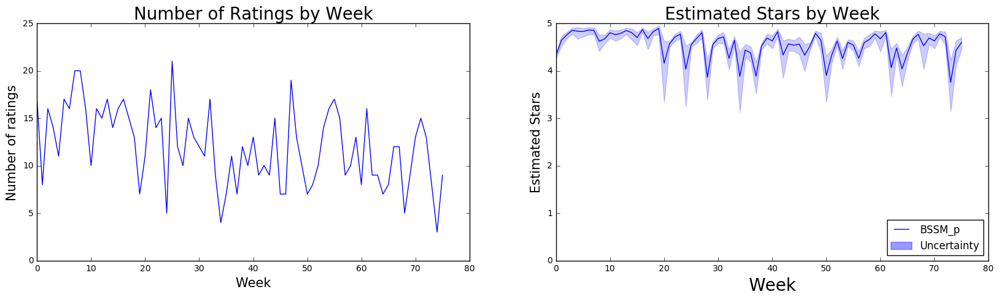

Harrah's Las Vegas Hotel & Casino
EM Sigma2:  0.380689487545


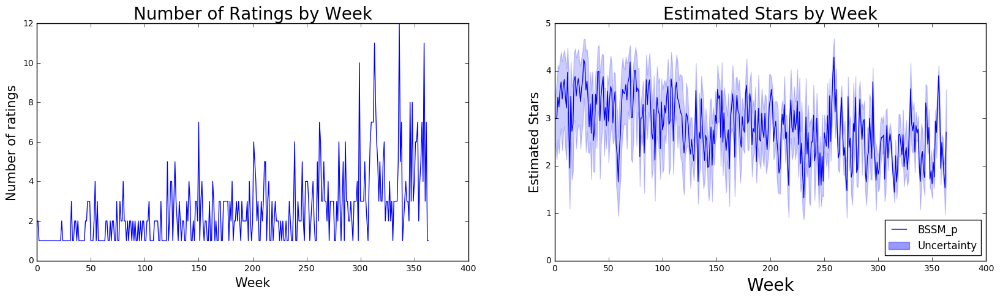

La Banquise
EM Sigma2:  0.491394614907


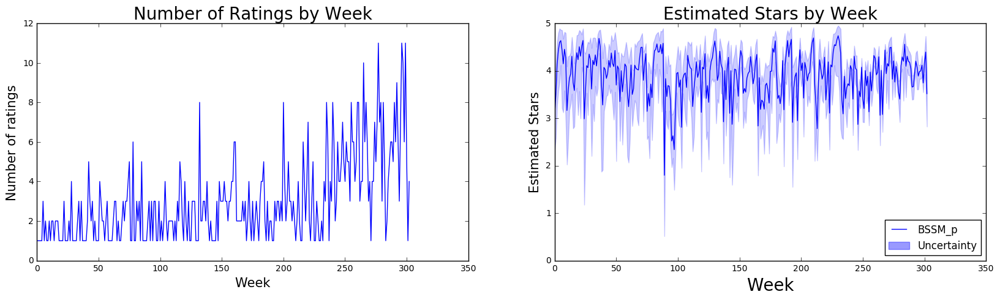

Texas de Brazil
EM Sigma2:  3.18316089113


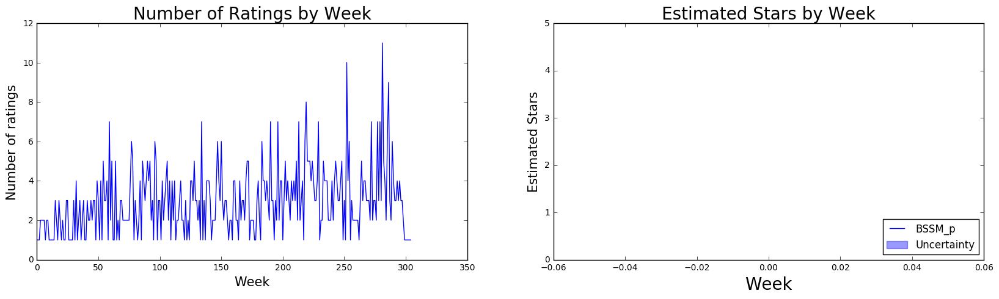

SanTan Brewing Company
EM Sigma2:  0.695618846484


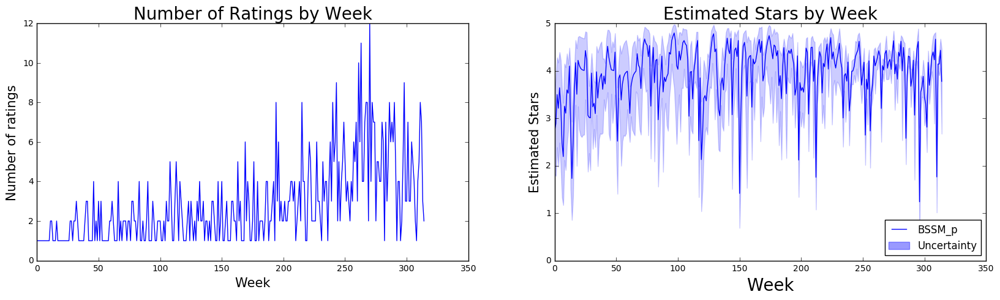

Maggiano's Little Italy
EM Sigma2:  0.702791212794


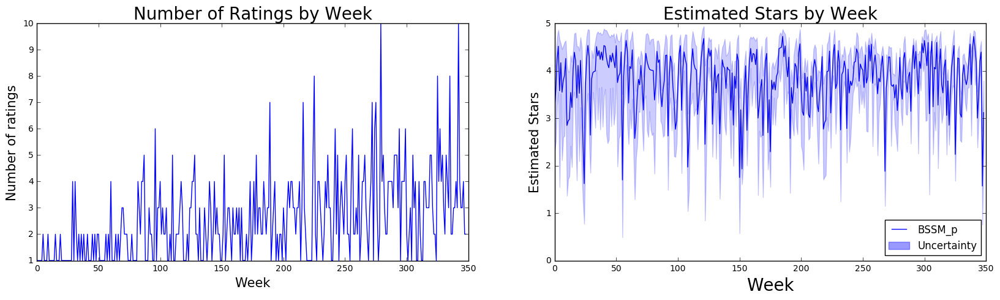

BabyStacks Cafe
EM Sigma2:  2.00244340747


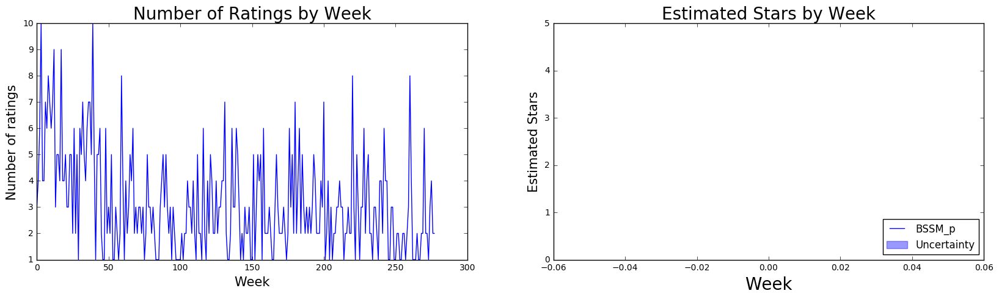

Culinary Dropout
EM Sigma2:  0.57119724359


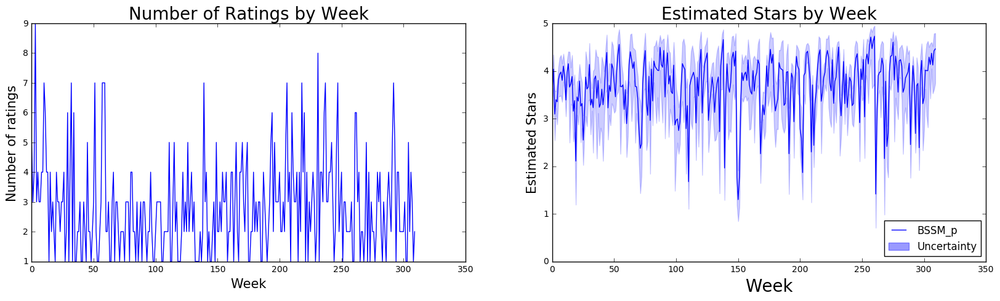

Umiya Sushi
EM Sigma2:  0.781744161002


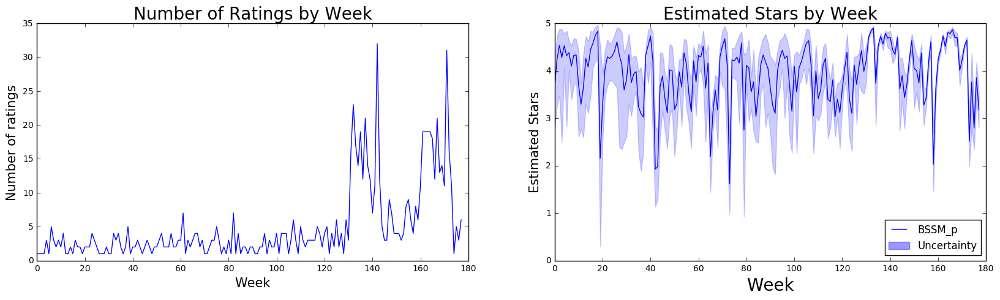

Little Miss BBQ
EM Sigma2:  0.949249676053


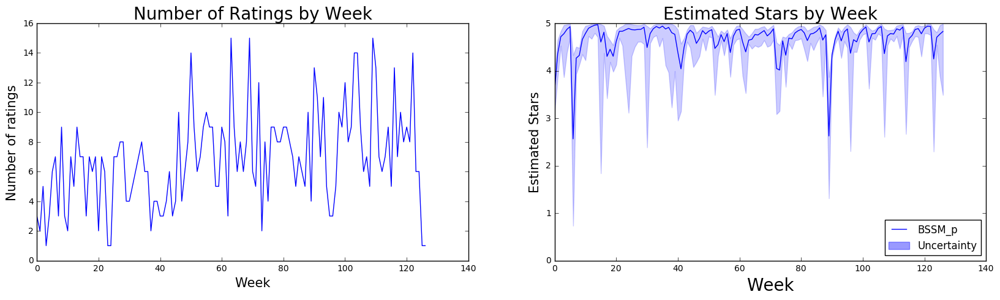

Oyshi Sushi
EM Sigma2:  0.731273123105


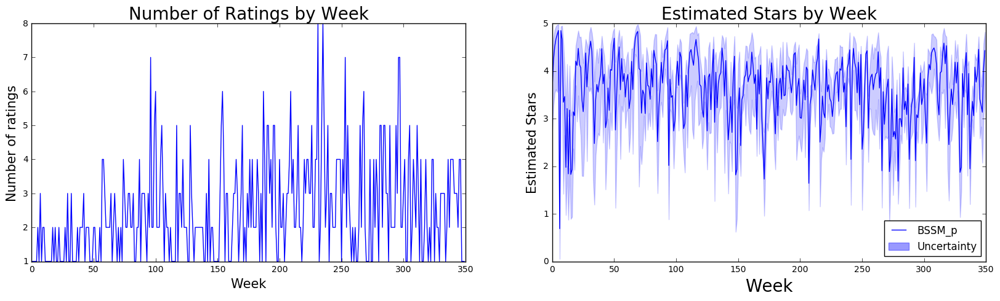

Mount Everest India's Cuisine
EM Sigma2:  1.74508597154


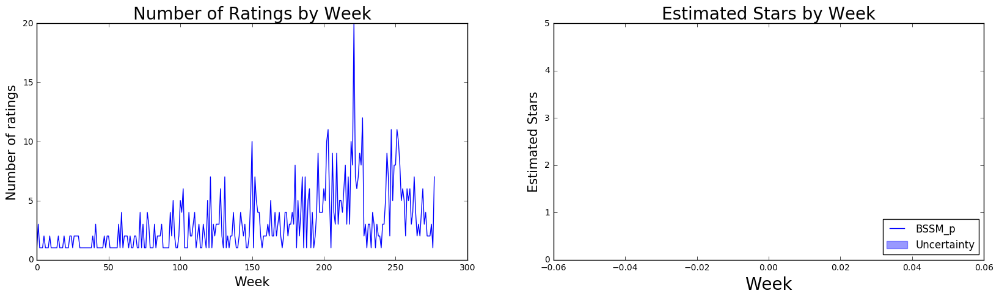

The Parlor
EM Sigma2:  0.755054133651


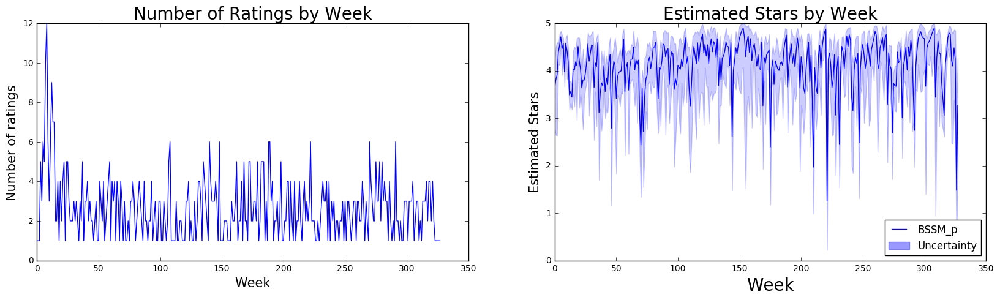

Hula's Modern Tiki
EM Sigma2:  0.603246907674


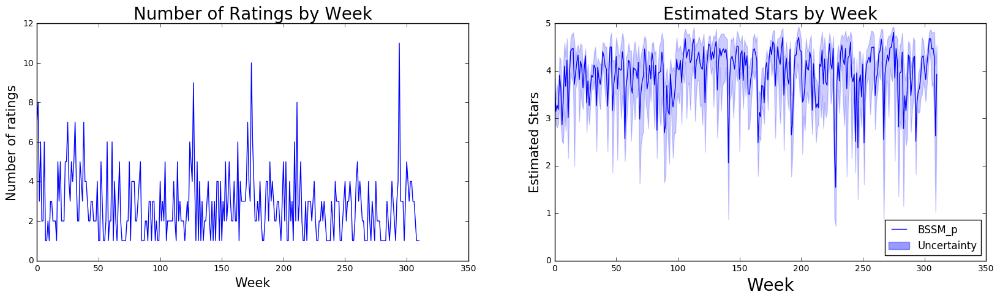

Max Brenner
EM Sigma2:  0.403890200054


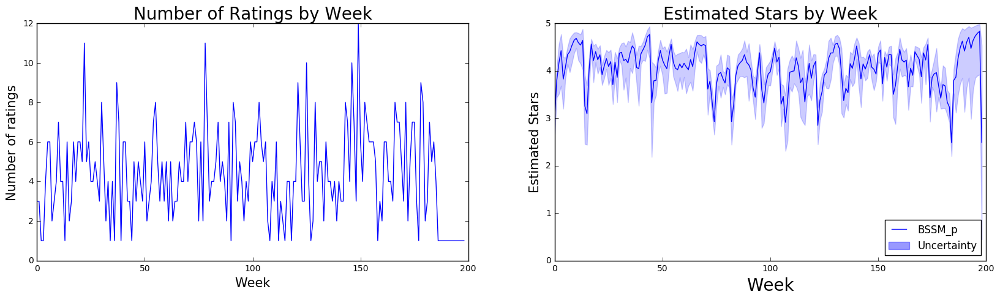

Le Reve - The Dream
EM Sigma2:  3.37986373217


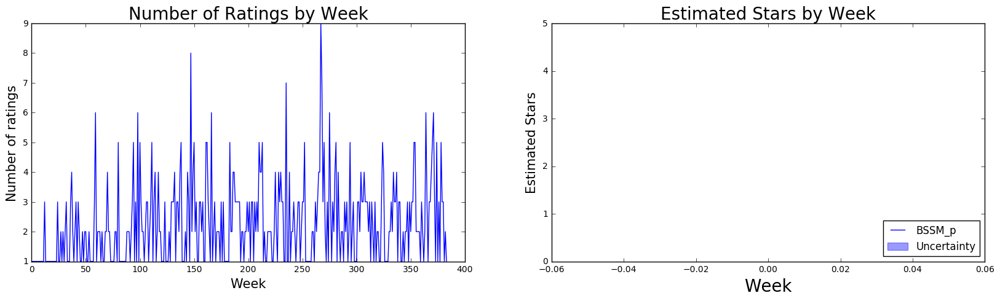

Gallo Blanco
EM Sigma2:  0.604500041058


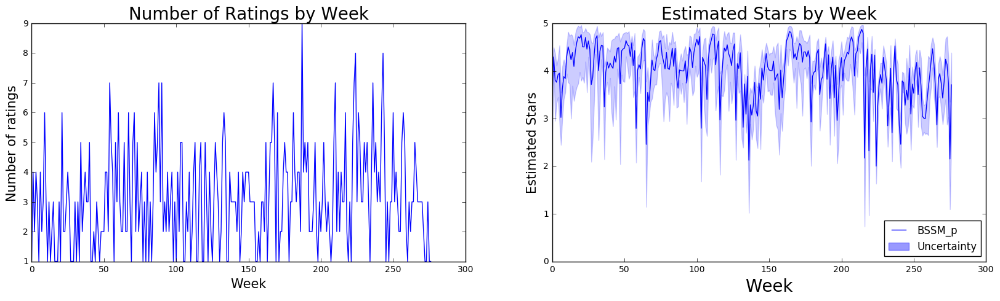

High Roller
EM Sigma2:  0.270671908516


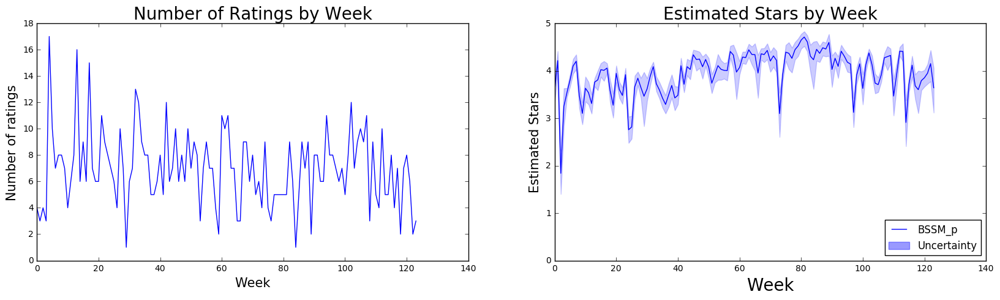

Palms Casino Resort
EM Sigma2:  0.580451985069


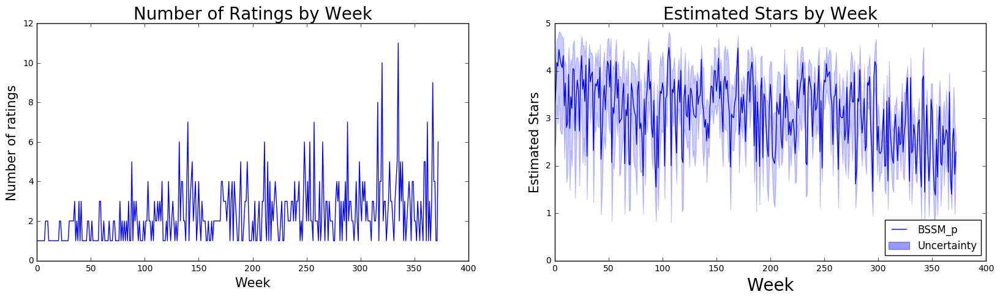

Viva Las Arepas
EM Sigma2:  0.775903752274


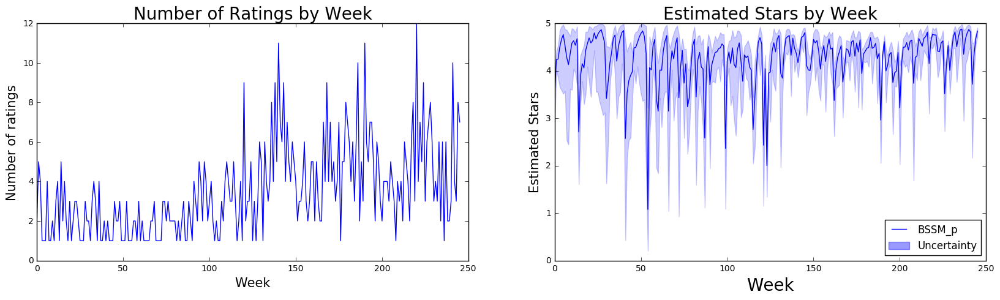

Tryst Nightclub
EM Sigma2:  1.12970086606


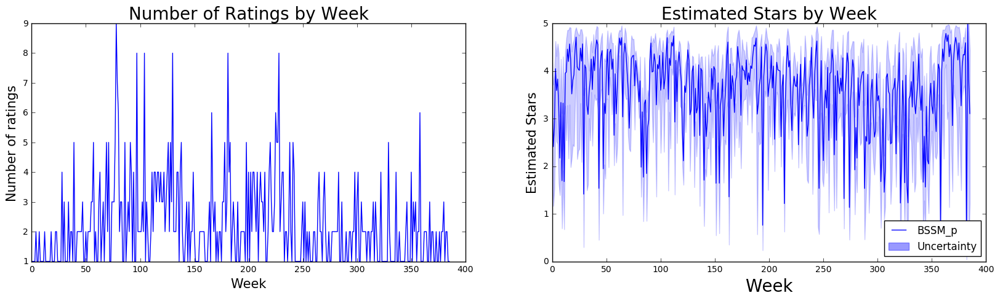

Barrio Café
EM Sigma2:  6.9284193195


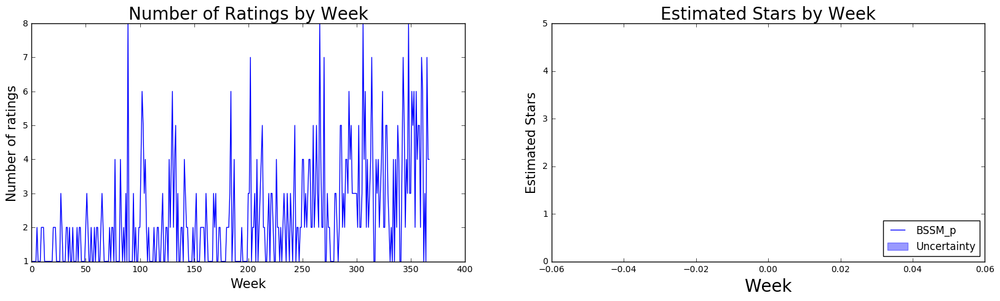

Scarpetta
EM Sigma2:  0.632729214613


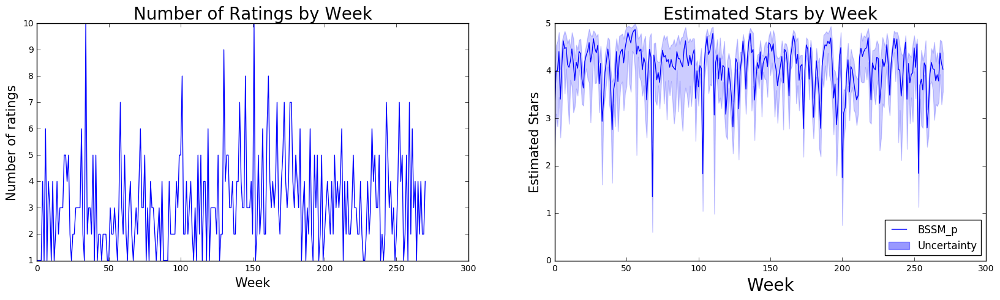

MIX
EM Sigma2:  0.663305849207


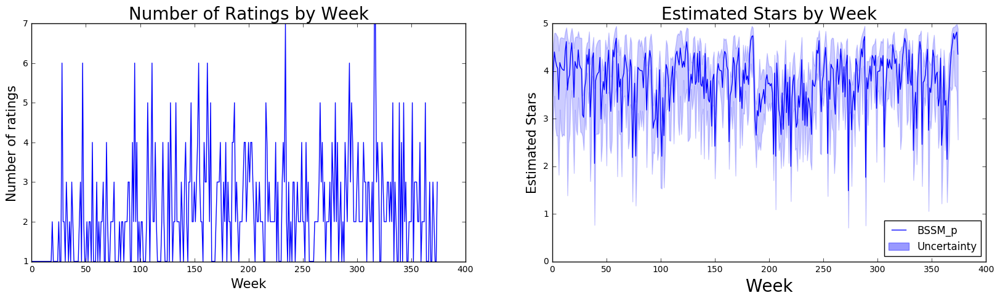

Bachi Burger
EM Sigma2:  0.528996942279


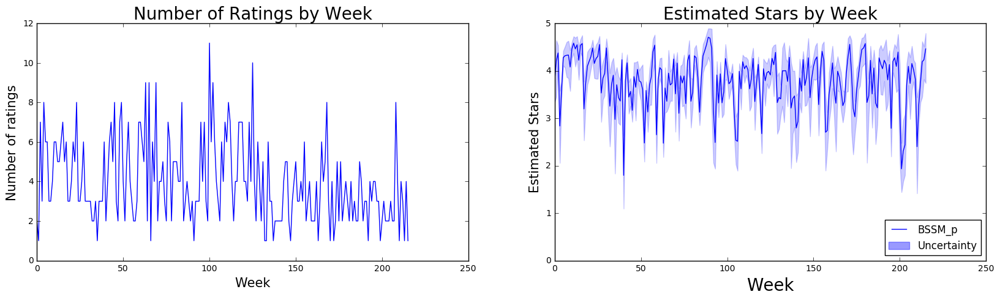

StripSteak
EM Sigma2:  13.6588475889


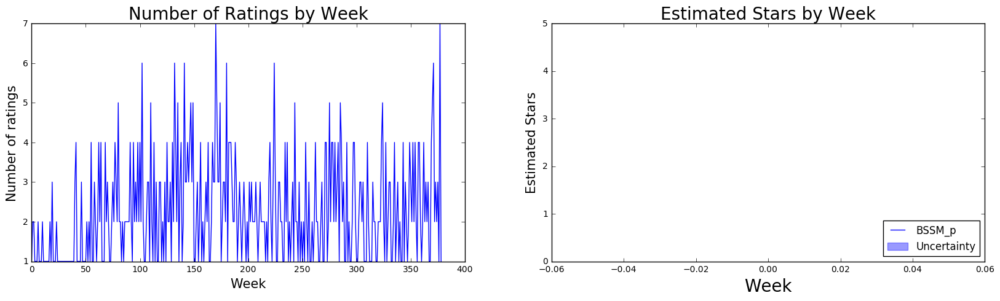

DW Bistro
EM Sigma2:  2.1265769424


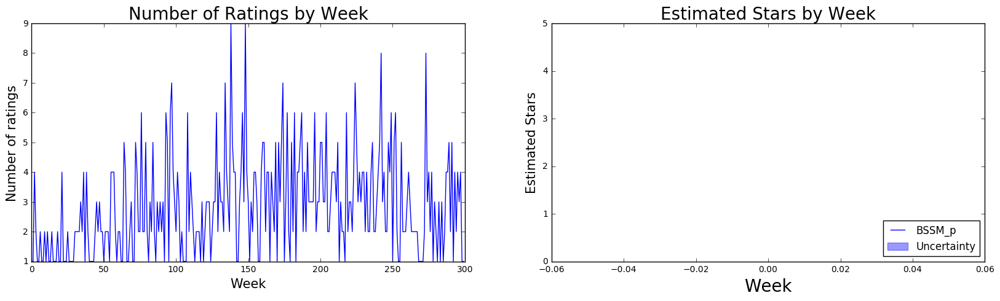

BabyStacks Cafe
EM Sigma2:  0.496357797719


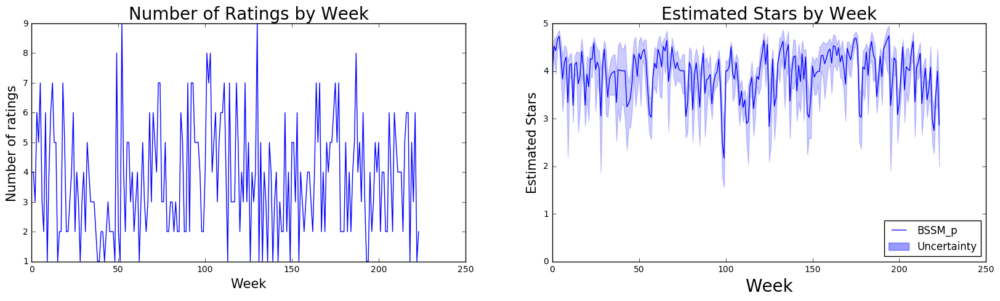

Fountains of Bellagio
EM Sigma2:  1.53209374193


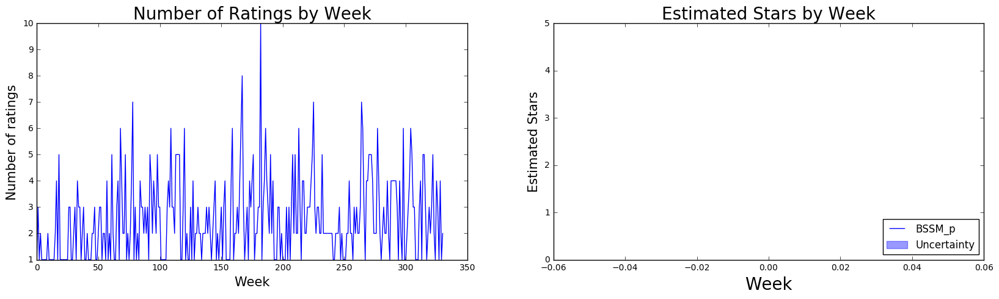

Green New American Vegetarian
EM Sigma2:  3.06025489129


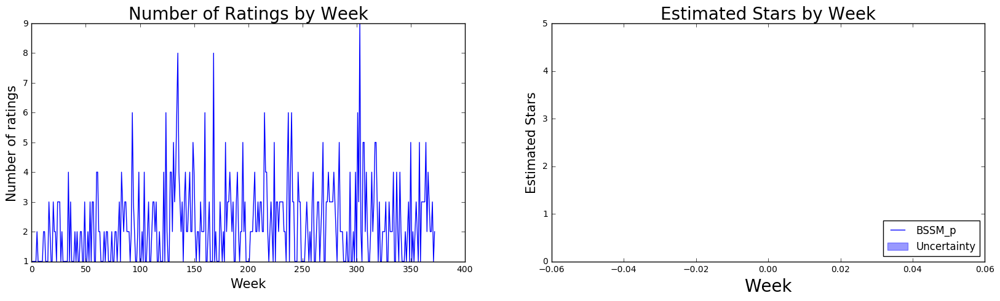

Honey Salt
EM Sigma2:  0.475060799019


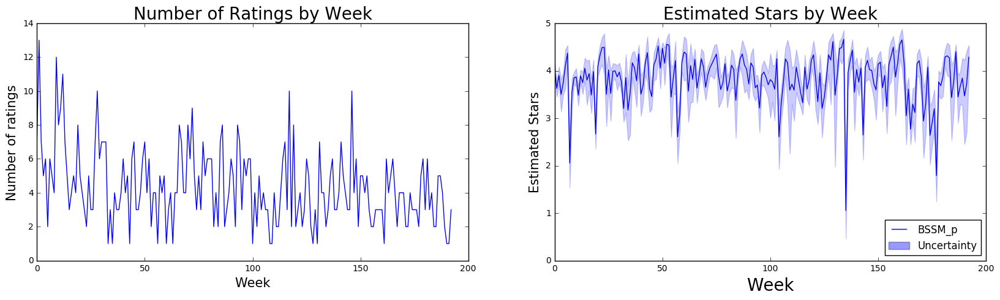

Cornish Pasty Company
EM Sigma2:  9.03778313135


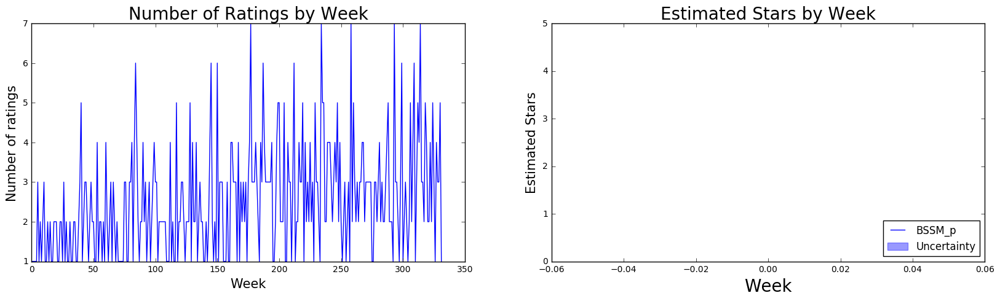

Primanti Bros.
EM Sigma2:  0.604968053584


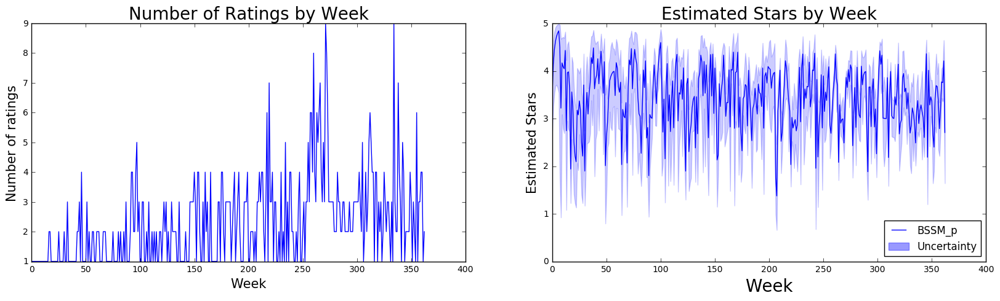

Jean Philippe Patisserie
EM Sigma2:  0.79799149578


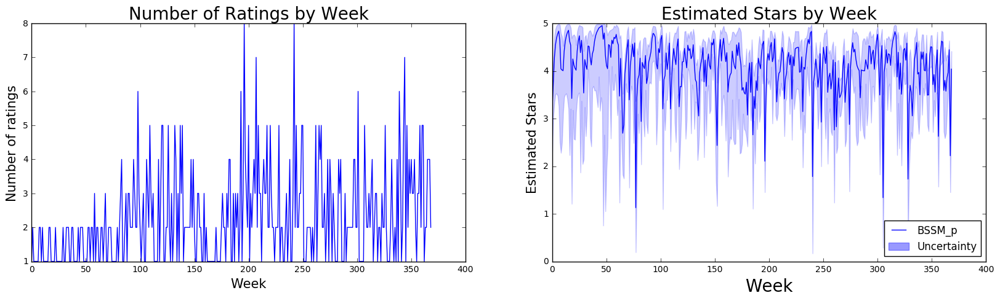

Ramen Sora
EM Sigma2:  8.00006188167


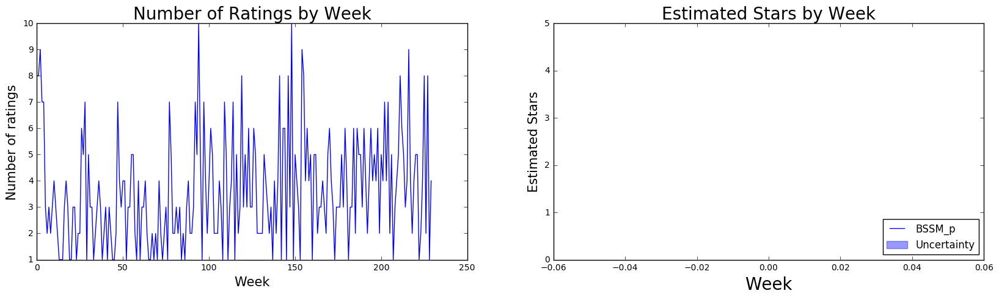

Spago
EM Sigma2:  0.821397458476


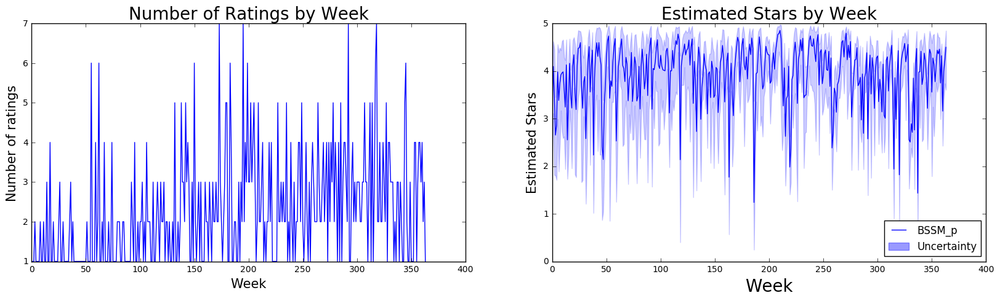

LVH - Las Vegas Hotel & Casino
EM Sigma2:  0.392269357192


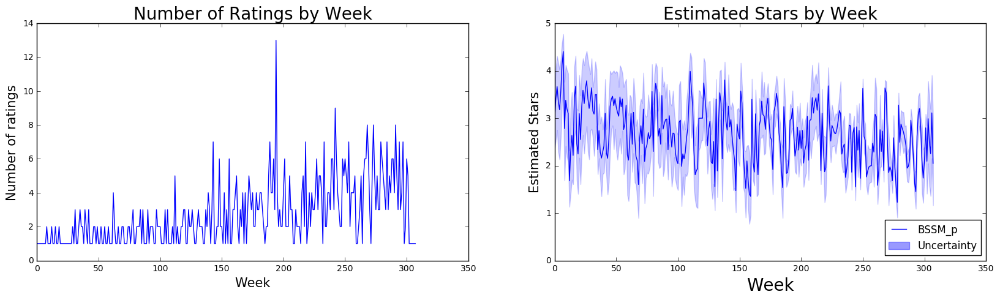

Diablo's Cantina
EM Sigma2:  0.501991439449


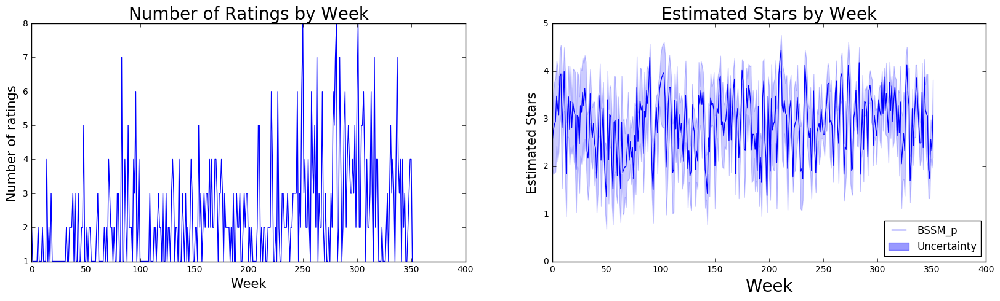

Gaucho Parrilla Argentina
EM Sigma2:  1.60207133627


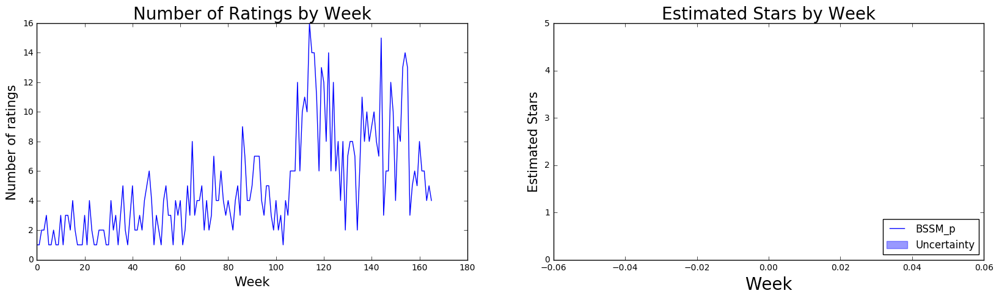

Jaleo
EM Sigma2:  0.437706604362


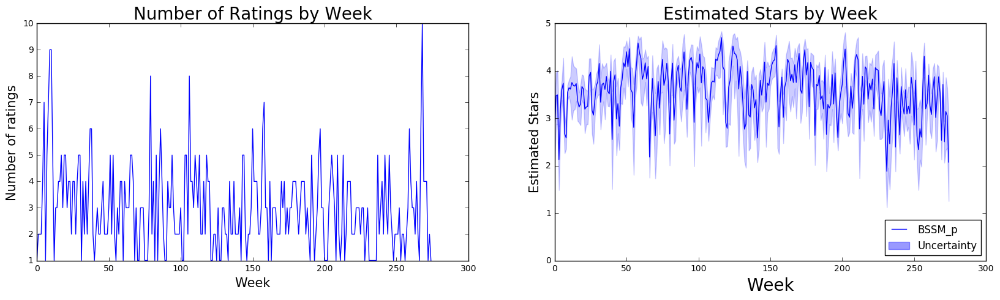

Rise & Shine - A Steak & Egg Place
EM Sigma2:  1.29588645743


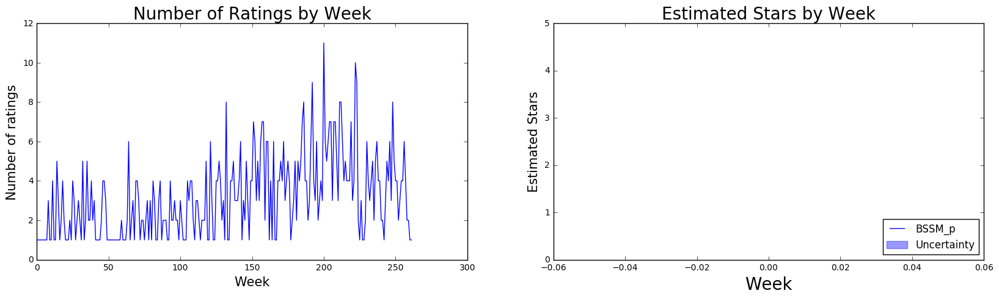

O.H.S.O. Eatery + NanoBrewery
EM Sigma2:  0.516687527808


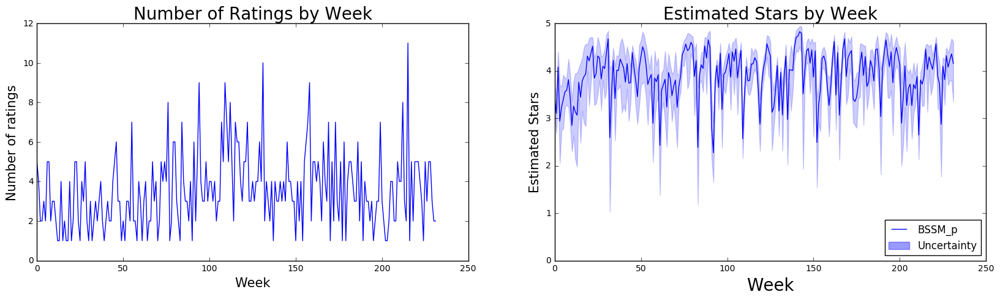

Top of the World
EM Sigma2:  1.87491100304


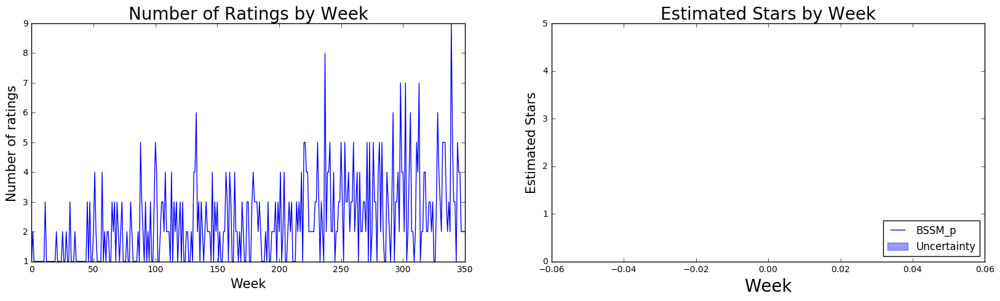

Fleur by Hubert Keller
EM Sigma2:  0.774419808565


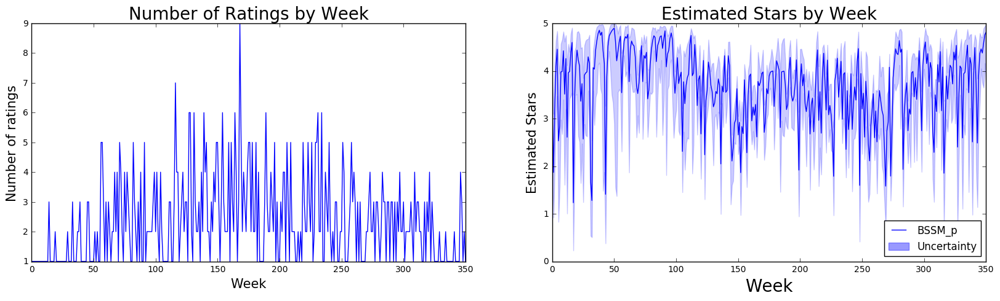

Midwood Smokehouse
EM Sigma2:  0.579620296882


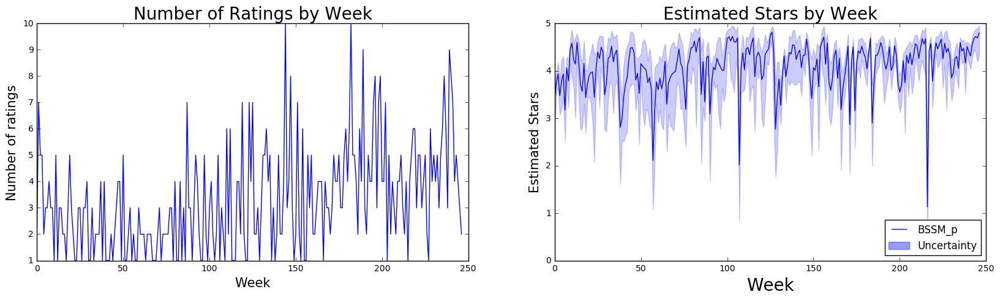

In [367]:
#sigma plot

sigmas = []#store all the sigmas
names = []
IDs = []
for i in range(200):
    ID = num_review_tuple_lv_res[i][0]
    res = Restuarant(ID,business,review)
    res.reviews_week()
    res.plot_reviews()
    
    names.append(res.name)
    IDs.append(ID)
    sigmas.append(res.sig)

In [405]:
names = []
IDs = []
for i in range(200):
    ID = num_review_tuple_lv_res[i][0]
    name = business[business["business_id"] == ID]["name"].values[0]
    names.append(name)
    IDs.append(ID)

In [406]:
sig_top_200 = pd.DataFrame({"ID": IDs,"Name": names,"Sigma2": sigmas})

In [407]:
sig_top_200

,ID,Name,Sigma2
0,4bEjOyTaDG24SY5TxsaUNQ,Mon Ami Gabi,0.170519
1,sIyHTizqAiGu12XMLX3N3g,Bacchanal Buffet,0.193205
2,zt1TpTuJ6y9n551sw9TaEg,Wicked Spoon,0.109577
3,aGbjLWzcrnEx2ZmMCFm3EA,Gordon Ramsay BurGR,0.071150
4,2e2e7WgqU1BnpxmQL5jbfw,Earl of Sandwich,0.213509
5,iUPJmJvHy9fVfRxsuwwdLQ,Gangnam Asian BBQ Dining,0.273533
6,Xhg93cMdemu5pAMkDoEdtQ,Serendipity 3,0.107732
7,QbmcCE_cLq4WO8ZMKImaLw,Hash House A Go Go,0.160788
8,YNQgak-ZLtYJQxlDwN-qIg,The Buffet,0.228937
9,lliksv-tglfUz1T3B3vgvA,Lotus of Siam,0.449446


In [312]:
sig_top_100.to_csv('top100_sigma2.csv',sep = ',',index_label=False)

In [408]:
sigmas_true = sig_top_200.dropna()['Sigma2']

(array([  4.,   5.,  11.,  12.,  14.,  20.,  12.,  13.,  13.,  12.,  10.,
          5.,   5.,   9.,   4.,   3.,   1.,   1.,   0.,   1.]),
 array([ 0.07114979,  0.12407739,  0.17700499,  0.22993259,  0.2828602 ,
         0.3357878 ,  0.3887154 ,  0.441643  ,  0.49457061,  0.54749821,
         0.60042581,  0.65335342,  0.70628102,  0.75920862,  0.81213622,
         0.86506383,  0.91799143,  0.97091903,  1.02384663,  1.07677424,
         1.12970184]),
 <a list of 20 Patch objects>)

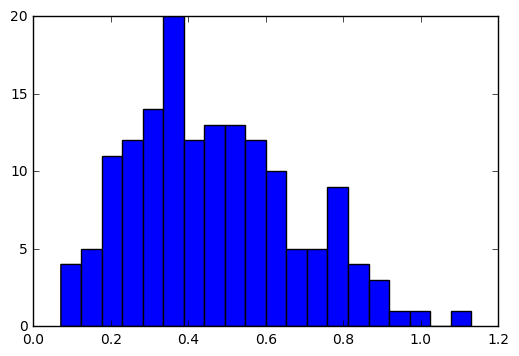

In [409]:
plt.hist(sigmas_true,bins = 20)

In [390]:
theta_s, sigma_s, theta_f, sigma_f = smoothing(0.25,5,number_rating,total_stars)

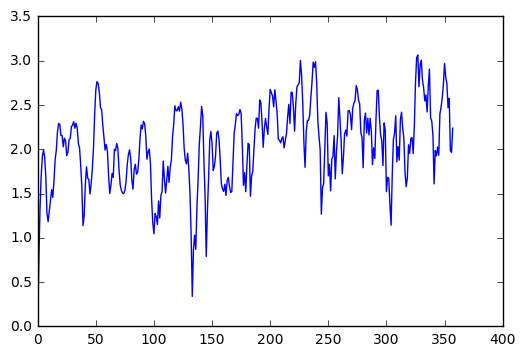

In [392]:
plt.plot(theta_s)

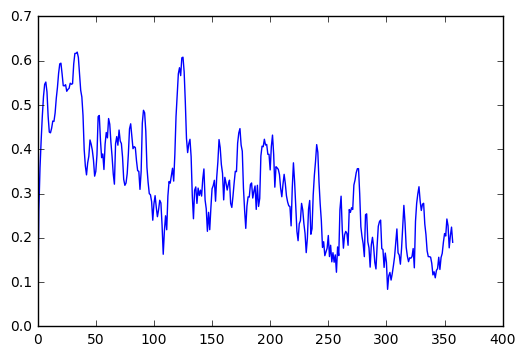

In [393]:
plt.plot(sigma_s)

In [358]:
#test case for nan output
total_stars = res.target_review_week['stars'].values
number_rating = res.target_review_week['counts'].values
rating_scale = 5
the, sig, p = filtering(2.5,5,number_rating,total_stars)
test = pd.DataFrame({'theta':the[1:], 'sig':sig[1:], 'p':p[1:],'counts':res.target_review_week['counts'],'stars':res.target_review_week['stars']})
test[150:250]
#test nan
math.isnan(the[302])

True

In [360]:
test[200:]

counts   p  sig  stars  theta
2013 29       3 NaN  NaN     14    NaN
     30       1 NaN  NaN      5    NaN
     31       2 NaN  NaN      8    NaN
     32       5 NaN  NaN     25    NaN
     33       3 NaN  NaN     14    NaN
     34       4 NaN  NaN     19    NaN
     35       4 NaN  NaN     17    NaN
     36       2 NaN  NaN      9    NaN
     37       3 NaN  NaN     13    NaN
     38       4 NaN  NaN     18    NaN
     39       3 NaN  NaN     14    NaN
     40       2 NaN  NaN      8    NaN
     41       2 NaN  NaN      9    NaN
     42       3 NaN  NaN     13    NaN
     43       3 NaN  NaN     14    NaN
     44       4 NaN  NaN     20    NaN
     45       4 NaN  NaN     16    NaN
     46       7 NaN  NaN     35    NaN
     47       5 NaN  NaN     24    NaN
     48       1 NaN  NaN      5    NaN
     49       4 NaN  NaN     16    NaN
     50       2 NaN  NaN     10    NaN
     51       6 NaN  NaN     29    NaN
     52      13 NaN  NaN     61    NaN
2014 1        7 NaN  NaN     32    NaN
     2        8 NaN  NaN     40    NaN
     3        6 NaN  NaN     29    NaN
     4        8 NaN  NaN     38    NaN
     5       10 NaN  NaN     45    NaN
     6        5 NaN  NaN     19    NaN
...         ...  ..  ...    ...    ...
2016 1        6 NaN  NaN     26    NaN
     2        4 NaN  NaN     20    NaN
     3        9 NaN  NaN     44    NaN
     4        9 NaN  NaN     42    NaN
     5        4 NaN  NaN     19    NaN
     6        9 NaN  NaN     41    NaN
     7        6 NaN  NaN     29    NaN
     8       13 NaN  NaN     58    NaN
     9        9 NaN  NaN     43    NaN
     10      12 NaN  NaN     60    NaN
     11      20 NaN  NaN     91    NaN
     12      10 NaN  NaN     46    NaN
     13      17 NaN  NaN     78    NaN
     14      13 NaN  NaN     52    NaN
     15       9 NaN  NaN     42    NaN
     16      10 NaN  NaN     43    NaN
     17      10 NaN  NaN     45    NaN
     18       6 NaN  NaN     24    NaN
     19       9 NaN  NaN     44    NaN
     20      10 NaN  NaN     46    NaN
     21      11 NaN  NaN     51    NaN
     22       9 NaN  NaN     42    NaN
     23       7 NaN  NaN     35    NaN
     24      17 NaN  NaN     80    NaN
     25       6 NaN  NaN     29    NaN
     26       7 NaN  NaN     31    NaN
     27      11 NaN  NaN     54    NaN
     28      12 NaN  NaN     52    NaN
     29       3 NaN  NaN     12    NaN
     53       5 NaN  NaN     24    NaN

[157 rows x 5 columns]

In [317]:
res.target

,stars,date,year,month,day,year_month,week,year_week
582832,5,2005-04-27,2005,04,27,2005-04,17,200517
582833,5,2006-01-07,2006,01,07,2006-01,1,20061
582834,5,2006-01-20,2006,01,20,2006-01,3,20063
582835,5,2006-03-07,2006,03,07,2006-03,10,200610
582836,5,2006-03-13,2006,03,13,2006-03,11,200611
582837,5,2006-03-22,2006,03,22,2006-03,12,200612
582838,5,2006-06-24,2006,06,24,2006-06,25,200625
582839,4,2006-07-15,2006,07,15,2006-07,28,200628
582840,4,2006-07-26,2006,07,26,2006-07,30,200630
582841,4,2006-09-14,2006,09,14,2006-09,37,200637
